In [1]:
import sys
sys.path.insert(0, '..')

import torch
import os
import wandb
import random
import numpy as np
import torch
from torch import nn
from torch.optim import Adam
from ignite.handlers.param_scheduler import create_lr_scheduler_with_warmup
from torch.utils.data import DataLoader
from datetime import datetime
import matplotlib.pyplot as plt
import pandas as pd
from scipy import stats
from tqdm import tqdm
from matplotlib import cm
import seaborn as sns
import matplotlib.lines as mlines
from sklearn.decomposition import PCA
from PIL import Image
import umap
import torch.nn.functional as F
from scipy.spatial.distance import cdist
from sklearn.neighbors import LocalOutlierFactor
from sklearn.ensemble import IsolationForest
from sklearn.cluster import DBSCAN
import random
import joblib
from scipy.signal import savgol_filter
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ExpSineSquared, WhiteKernel, Matern, ConstantKernel
from astropy.timeseries import LombScargle
from scipy.interpolate import UnivariateSpline
from scipy.stats import rice
from scipy.stats import lognorm
from tabulate import tabulate

from util.preprocess_data import clip_outliers
from core.dataset import PSMDataset
from core.model import GalSpecNet, MetaModel, Informer, AstroM3
from core.trainer import Trainer

/global/home/users/mariia/miniforge3/envs/astro/lib/python3.10/site-packages/ignite/handlers/checkpoint.py:16: DeprecationWarning: `TorchScript` support for functional optimizers is deprecated and will be removed in a future PyTorch release. Consider using the `torch.compile` optimizer instead.
  from torch.distributed.optim import ZeroRedundancyOptimizer


In [2]:
CLASSES = ['EW', 'SR', 'EA', 'RRAB', 'EB', 'ROT', 'RRC', 'HADS', 'M', 'DSCT']

METADATA_COLS = [
    'mean_vmag',  'phot_g_mean_mag', 'e_phot_g_mean_mag', 'phot_bp_mean_mag', 'e_phot_bp_mean_mag', 'phot_rp_mean_mag', 'e_phot_rp_mean_mag',
    'bp_rp', 'parallax', 'parallax_error', 'parallax_over_error', 'pmra', 'pmra_error', 'pmdec',
    'pmdec_error', 'j_mag', 'e_j_mag', 'h_mag', 'e_h_mag', 'k_mag', 'e_k_mag', 'w1_mag', 'e_w1_mag',
    'w2_mag', 'e_w2_mag', 'w3_mag', 'w4_mag', 'j_k', 'w1_w2', 'w3_w4', 'pm', 'ruwe', 'l', 'b'
]

PHOTO_COLS = ['amplitude', 'period', 'lksl_statistic', 'rfr_score']

METADATA_FUNC = {
    "abs": [
        "mean_vmag",
        "phot_g_mean_mag",
        "phot_bp_mean_mag",
        "phot_rp_mean_mag",
        "j_mag",
        "h_mag",
        "k_mag",
        "w1_mag",
        "w2_mag",
        "w3_mag",
        "w4_mag",
    ],
    "cos": ["l"],
    "sin": ["b"],
    "log": ["period"]
}

BOOK = ["id", "source_id", "asassn_name", "other_names", "raj2000", "dej2000", "epoch_hjd", "gdr2_id", "allwise_id", "apass_dr9_id", "edr3_source_id", "galex_id", "tic_id"]

LAMOST_DIR = '/home/mariia/AstroML/data/asassn/Spectra/v2'

## Load CLIP pre-trained model

In [3]:
# run_id = 'MeriDK/AstroCLIPResults3/2wz4ysvn'
run_id = 'MeriDK/AstroCLIPOptuna3/nksu4l24'
api = wandb.Api()
run = api.run(run_id)
config = run.config
config['use_wandb'] = False

model = AstroM3(config)
device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
model.eval()

weights_path = os.path.join(config['weights_path'] + '-' + run_id.split('/')[-1], f'weights-best.pth')
model.load_state_dict(torch.load(weights_path, weights_only=False))

<All keys matched successfully>

## Create dataset class to be able to use its photo and spectra pre-processing functions

In [4]:
ds = PSMDataset(config)

## Load data 
- **df_org** - original csv file with LC info, load it to get bookmark info
- **df_v** - pre-processed info about LC with no duplicates, no missing LC, no missing metadata, with changed column names
- **df_s** - spectra info not pre-processed, has duplicates
- **scaler** - scaler for metadata and photo aux

In [5]:
df_org = pd.read_csv('/home/mariia/AstroML/data/asassn/asassn_catalog_full.csv')
df_v = pd.read_csv('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/v.csv')
df_s = pd.read_csv('/home/mariia/AstroML/data/asassn/Spectra/lamost_spec.csv')
scaler = joblib.load('/home/mariia/AstroML/data/asassn/preprocessed_data/full_lb/scaler.pkl')

/tmp/ipykernel_32866/1418165920.py:1: DtypeWarning: Columns (69) have mixed types. Specify dtype option on import or set low_memory=False.
  df_org = pd.read_csv('/home/mariia/AstroML/data/asassn/asassn_catalog_full.csv')
/global/home/users/mariia/miniforge3/envs/astro/lib/python3.10/site-packages/sklearn/base.py:376: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.5.1 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [6]:
# change the name column in df_org so it matches df_v
df_org['asassn_name'] = df_org['asassn_name'].apply(lambda x: x.replace(' ', ''))

In [7]:
# drop filename duplicates from spectra df
df_s = df_s.drop_duplicates(subset=['spec_filename'])

## Note the class distribution, we're going to use all of them for this analysis, but during training we used only CLASSES = ['EW', 'SR', 'EA', 'RRAB', 'EB', 'ROT', 'RRC', 'HADS', 'M', 'DSCT']

In [8]:
df_v['target'].value_counts()

target
SR         187835
EW          71647
EA          44747
ROT         33721
RRAB        28581
EB          23143
RRC          9842
M            8872
VAR          8213
ROT:         4599
DSCT         4175
HADS         3954
DCEP         1516
GCAS:         668
CWB           633
CWA           611
DCEPS         541
RRD           482
YSO           382
M:            294
SRD           227
DSCT:         218
LSP           162
RVA           144
UG             71
ELL            46
GCAS           33
UV             30
RCB            30
SXPHE          29
RRAB:          27
ZAND           23
UGSU           20
CV             13
UGSS           12
AM             11
HMXB            8
RCB:            7
CV:             6
PPN             6
UV:             6
R               5
AM+E            5
WR              4
DQ              3
SXARI           3
UGZ             2
UGWZ            2
V838MON         1
SDOR            1
DYPer           1
AM:             1
UGER            1
ZZO             1
Name: count, dtype: i

## Normalize metadata

In [9]:
# this functions is from 028-meta-change.ipynb
def transform(df):
    for transformation_type, value in METADATA_FUNC.items():
        if transformation_type == "abs":
            for col in value:
                df[col] = (
                    df[col] - 10 + 5 * np.log10(np.where(df["parallax"] <= 0, 1, df["parallax"]))
                )
        elif transformation_type == "cos":
            for col in value:
                df[col] = np.cos(np.radians(df[col]))
        elif transformation_type == "sin":
            for col in value:
                df[col] = np.sin(np.radians(df[col]))
        elif transformation_type == "log":
            for col in value:
                df[col] = np.log10(df[col])

In [10]:
# save the period, it'll be used for plots
df_v.loc[:, 'org_period'] = df_v['period']

# do the metadata and photo aux transformations
transform(df_v)

# normalize the metadata and photo aux
cols = METADATA_COLS + PHOTO_COLS
df_v.loc[:, cols] = scaler.transform(df_v[cols])

## Get photometry embeddings for all target_class

In [ ]:
eb = {}
target_class = 'SR'

for _, el in tqdm(df_v[df_v['target'] == target_class].iterrows(), total=len(df_v[df_v['target'] == target_class])):
    photometry = ds.get_vlc(el['name'])
    photometry, photometry_mask = ds.preprocess_lc(photometry, None, list(el[PHOTO_COLS]))

    photometry, photometry_mask = torch.from_numpy(photometry), torch.from_numpy(photometry_mask)
    photometry, photometry_mask = photometry.unsqueeze(0), photometry_mask.unsqueeze(0)
    photometry, photometry_mask = photometry.to(device), photometry_mask.to(device)
    
    with torch.no_grad():
        p_emb = model.photometry_encoder(photometry, photometry_mask)
        p_emb = model.photometry_proj(p_emb)

    eb[el['name']] = p_emb

 10%|██████▉                                                              | 18894/187835 [04:29<41:20, 68.11it/s]

In [2]:
len(eb)

NameError: name 'eb' is not defined

In [106]:
eb_emb = torch.cat(list(eb.values()), dim=0)
eb_emb = eb_emb.detach().cpu()
eb_emb = eb_emb / eb_emb.norm(dim=-1, keepdim=True)

In [107]:
eb_center = eb_emb.mean(dim=0)
eb_center = eb_center / eb_center.norm(dim=-1, keepdim=True)

In [ ]:
torch.mm(eb_emb[:20000], eb_emb.T)

In [108]:
cosine_distances = 1 - torch.mm(eb_emb, eb_emb.T)
distance_sums = cosine_distances.sum(dim=1)
eb_medoid = eb_emb[torch.argmin(distance_sums)]

RuntimeError: [enforce fail at alloc_cpu.cpp:117] err == 0. DefaultCPUAllocator: can't allocate memory: you tried to allocate 141127948900 bytes. Error code 12 (Cannot allocate memory)

In [ ]:
eb_dist_center = 1 - eb_emb @ eb_center
eb_dist_medoid = 1 - eb_emb @ eb_medoid
plt.hist(eb_dist_medoid.cpu(), bins=30, alpha=0.5, label=f'{target_class} medoid')
plt.hist(eb_dist_center.cpu(), bins=30, alpha=0.5, label=f'{target_class} centroid')
plt.legend()

In [ ]:
sum(eb_dist_center > 0.6)

In [ ]:
eb100 = torch.topk(eb_dist_center, 100).indices
eb_names = list(df_v[df_v['target'] == target_class]['name'])
eb_out_names = [eb_names[el] for el in eb100]

In [ ]:
eb_out_names[0]

## Get metadata embeddings for all target_class

In [ ]:
eb_meta = {}

for _, el in tqdm(df_v[df_v['target'] == target_class].iterrows(), total=len(df_v[df_v['target'] == target_class])):
    metadata = el[METADATA_COLS].values.astype(np.float32)
    metadata = torch.tensor(metadata).unsqueeze(0).to(device)
    
    with torch.no_grad():
        m_emb = model.metadata_encoder(metadata)
        m_emb = model.metadata_proj(m_emb)

    eb_meta[el['name']] = m_emb

In [ ]:
eb_meta_emb = torch.cat(list(eb_meta.values()), dim=0)
eb_meta_emb = eb_meta_emb.detach().cpu()
eb_meta_emb = eb_meta_emb / eb_meta_emb.norm(dim=-1, keepdim=True)

eb_meta_center = eb_meta_emb.mean(dim=0)
eb_meta_center = eb_meta_center / eb_meta_center.norm(dim=-1, keepdim=True)

cosine_distances = 1 - torch.mm(eb_meta_emb, eb_meta_emb.T)
distance_sums = cosine_distances.sum(dim=1)
eb_meta_medoid = eb_meta_emb[torch.argmin(distance_sums)]

eb_meta_dist_center = 1 - eb_meta_emb @ eb_meta_center
eb_meta_dist_medoid = 1 - eb_meta_emb @ eb_meta_medoid
plt.hist(eb_meta_dist_medoid.cpu(), bins=30, alpha=0.5, label=f'{target_class} meta medoid')
plt.hist(eb_meta_dist_center.cpu(), bins=30, alpha=0.5, label=f'{target_class} meta centroid')
plt.legend()

In [ ]:
sum(eb_meta_dist_center > 0.5)

In [ ]:
eb_meta100 = torch.topk(eb_meta_dist_center, 100).indices
eb_names = list(df_v[df_v['target'] == target_class]['name'])
eb_meta_out_names = [eb_names[el] for el in eb_meta100]

## Meta outliers that are also photo outliers

In [ ]:
len(np.intersect1d(eb100.cpu(), eb_meta100.cpu()))

## Map spectra to targets

In [ ]:
id_to_target = dict(zip(df_v['id'], df_v['target']))
id_to_name = dict(zip(df_v['id'], df_v['name']))

df_s['target'] = df_s['edr3_source_id'].map(id_to_target)
df_s['name'] = df_s['edr3_source_id'].map(id_to_name)

## Note 5.5k NaN

In [ ]:
df_s['target'].value_counts(dropna=False)

In [ ]:
eb_spec = {}

for _, el in tqdm(df_s[df_s['target'] == target_class].iterrows(), total=len(df_s[df_s['target'] == target_class])):

    try:
        spectra = ds.readLRSFits(os.path.join(LAMOST_DIR, el['spec_filename']))
        spectra = ds.preprocess_spectra(spectra)
        spectra = torch.tensor(spectra).unsqueeze(0).to(device)
        
        with torch.no_grad():
            s_emb = model.spectra_encoder(spectra)
            s_emb = model.spectra_proj(s_emb)
    
        eb_spec[el['edr3_source_id']] = s_emb
    except FileNotFoundError:
        print(el['spec_filename'], ' not found')

In [ ]:
eb_spec_emb = torch.cat(list(eb_spec.values()), dim=0)
eb_spec_emb = eb_spec_emb / eb_spec_emb.norm(dim=-1, keepdim=True)

eb_spec_center = eb_spec_emb.mean(dim=0)
eb_spec_center = eb_spec_center / eb_spec_center.norm(dim=-1, keepdim=True)

cosine_distances = 1 - torch.mm(eb_spec_emb, eb_spec_emb.T)
distance_sums = cosine_distances.sum(dim=1)
eb_spec_medoid = eb_spec_emb[torch.argmin(distance_sums)]

eb_spec_dist_center = 1 - eb_spec_emb @ eb_spec_center
eb_spec_dist_medoid = 1 - eb_spec_emb @ eb_spec_medoid
plt.hist(eb_spec_dist_medoid.cpu(), bins=30, alpha=0.5, label=f'{target_class} spec medoid')
plt.hist(eb_spec_dist_center.cpu(), bins=30, alpha=0.5, label=f'{target_class} spec centroid')
plt.legend()

In [ ]:
sum(eb_spec_dist_center > 0.25)

In [ ]:
eb_spec25 = torch.topk(eb_spec_dist_center, 25).indices

eb_spec_names = list(df_s[df_s['target'] == target_class]['name'])
eb_spec_filename = list(df_s[df_s['target'] == target_class]['spec_filename'])

eb_out_spec_names = [eb_spec_names[el] for el in eb_spec25]
eb_out_spec_filenames = [eb_spec_filename[el] for el in eb_spec25]

## Intersection with outliers from meta and photo

In [ ]:
[el for el in eb_out_names if el in eb_out_spec_names]

In [ ]:
[el for el in eb_meta_out_names if el in eb_out_spec_names]

## Find the objects that have 2x and 2/3 aliases of 1 sidereal days

In [90]:
photo_alias23 = list(df_v[(df_v['name'].isin(eb_out_names)) & (df_v['org_period'] > 0.66) & (df_v['org_period'] < 0.67)]['name'])
photo_alias2 = list(df_v[(df_v['name'].isin(eb_out_names)) & (df_v['org_period'] > 1.99) & (df_v['org_period'] < 2.0)]['name'])

print(len(photo_alias23), len(photo_alias2))

0 0


## Plots

In [91]:
def plot_spectra(spec_filename, window_length=51, polyorder=3):    
    spectra = ds.readLRSFits(os.path.join(LAMOST_DIR, spec_filename))
    smoothed_spectra = savgol_filter(spectra[:, 1], window_length=window_length, polyorder=polyorder)

    plt.figure(figsize=(6, 5))
    plt.plot(spectra[:, 0], spectra[:, 1], color='gray', alpha=0.4, label='Original Spectra')
    plt.plot(spectra[:, 0], smoothed_spectra, color='blue', linewidth=1.5, label='Smoothed Spectra')
    plt.xlabel('Wavelength (Å)', fontsize=14)
    plt.ylabel('Flux', fontsize=14)
    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.title('Spectra', fontsize=16)
    plt.tight_layout()
    plt.show()

In [92]:
def plot_photometry_flux(name, period=None, meta_warning=True):
    try:
        el = df_v[df_v['name'] == name].iloc[0]
        period = period if period else el['org_period']
        dr3_id = el['id']

        print('⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️\n', df_org[df_org['asassn_name'] == name][BOOK], '\n_________________\n')
        print('⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️\n', df_org[df_org['asassn_name'] == name][PHOTO_COLS], '\n_________________\n')
        print('⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️')
        
        with pd.option_context('display.max_columns', None, 'display.max_rows', None):
            print(df_org[df_org['asassn_name'] == name][METADATA_COLS], '\n_________________\n')

        spectra = df_s[df_s['edr3_source_id'] == dr3_id]['spec_filename']
        print(f"⬇️⬇️⬇️ WE HAVE {len(spectra)} SPECTRA FOR THIS OBJECT ⬇️⬇️⬇️\n")

        if meta_warning and name in eb_meta_out_names:
            print('⚠️⚠️⚠️ THIS IS ALSO METADATA OUTLIER ⚠️⚠️⚠️\n')
    
        photometry = ds.get_vlc(name)
        flux_time, flux, flux_err = photometry[:, 0], photometry[:, 1], photometry[:, 2]
        
        phased = (flux_time % period) / period
        phased_i = np.argsort(phased)
        
        phase = phased[phased_i]
        flux = flux[phased_i]
        flux_err = flux_err[phased_i]
        
        phase3 = np.hstack([phase - 1, phase, phase + 1])
        plt.figure(figsize=(8, 5))

        if (flux <= 0).any():
            print('🔴🔴🔴 FLUX HAS ZEROS OR NEGATIVE VALUES. PHOTO PLOT IN FLUX NOT IN MAG 🔴🔴🔴\n')
            
            flux3 = np.hstack([flux, flux, flux])
            flux_err3 = np.hstack([flux_err, flux_err, flux_err])

            plt.errorbar(phase3, flux3, yerr=flux_err3, fmt='.', label='Photometry', alpha=0.4)
            plt.ylabel('Flux', fontsize=14)
        else:
            mag = -2.5 * np.log10(flux)
            dmag = (2.5 / np.log(10)) * (flux_err / flux)
        
            mag3 = np.hstack([mag, mag, mag])
            dmag3 = np.hstack([dmag, dmag, dmag])
    
            plt.errorbar(phase3, mag3, yerr=dmag3, fmt='.', label='Photometry', alpha=0.4)
            plt.ylabel('Magnitude', fontsize=14)
            plt.gca().invert_yaxis()
    
        plt.xlim(-0.5, 1.5)    
        plt.xlabel('Phase', fontsize=14)
        plt.title(f'Photometry ($P_{{\\rm cat}} = {period:.6f}$)', fontsize=14)
        plt.grid(True, which='both', linestyle='--', linewidth=0.5)
        
        plt.suptitle(f"Gaia ID: {dr3_id}      Original Classification: {el['target']}", fontsize=16)
        plt.legend()
        plt.tight_layout()
        plt.show()

        if len(spectra) > 0:
            for el in spectra:
                print(el)

                if el in eb_out_spec_filenames:
                    print('\n💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥\n')
                    
                plot_spectra(el)
    
    except Exception as e:
        print(f"Error occurred while plotting photometry for {name}: {e}")
        plt.close('all')  # Ensure any active plots are removed if an error occurs

# Spectra Outliers Plots

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
483441  7a48a35f-dd1e-59bc-89be-a2b139188b12  AP12239495   

                        asassn_name             other_names    raj2000  \
483441  ASASSN-VJ212428.22+382151.4  ATLASJ321.1172+38.3644  321.11758   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
483441  38.36428  2.457678e+06  1.964439e+18  J212428.16+382151.7   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
483441    12239495.0  EDR3 1964439189895202432      NaN  TIC 279364768   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
483441       0.19  0.04969            0.13       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
483441      13.41        13.575879           0.004367         13.747335   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

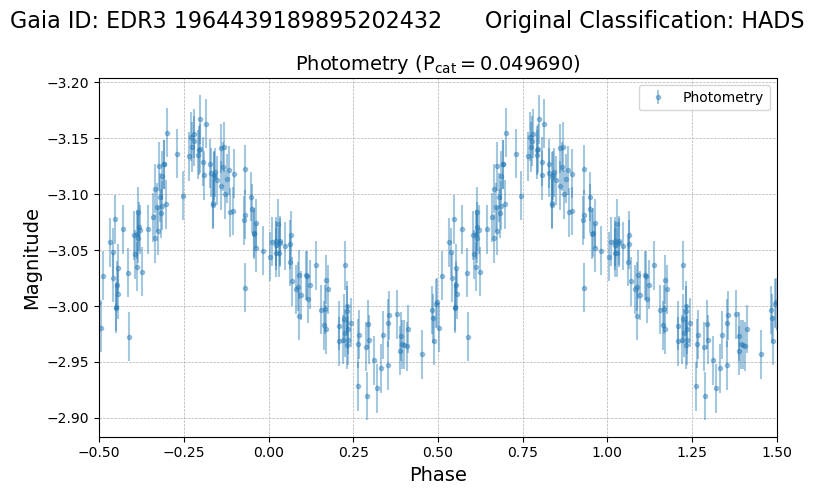

spec-57679-HD212416N373944V01_sp15-109.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



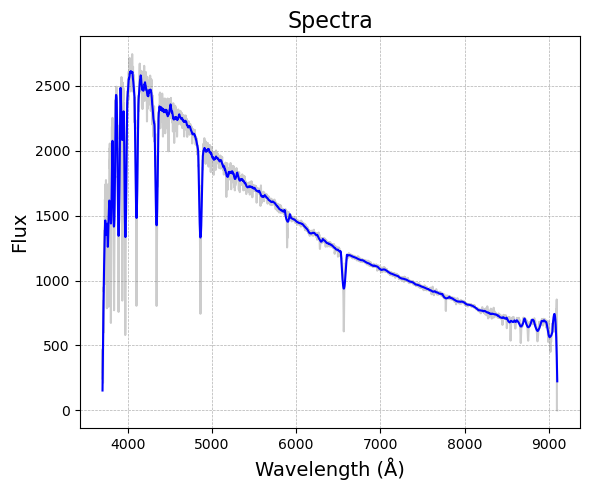

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
48003  ff7667f7-8981-5103-a475-6835019f183a    654356   

                       asassn_name other_names    raj2000   dej2000  \
48003  ASASSN-VJ235730.94+431139.1         NaN  359.37882  43.19419   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
48003  2.457926e+06  1.922655e+18  J235730.94+431139.1    11585731.0   

                 edr3_source_id                galex_id         tic_id  
48003  EDR3 1922655239771290496  GALEX J235730.9+431139  TIC 177603306   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
48003       0.51  0.088116            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
48003      14.32        14.318973           0.008246         14.500662   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag   

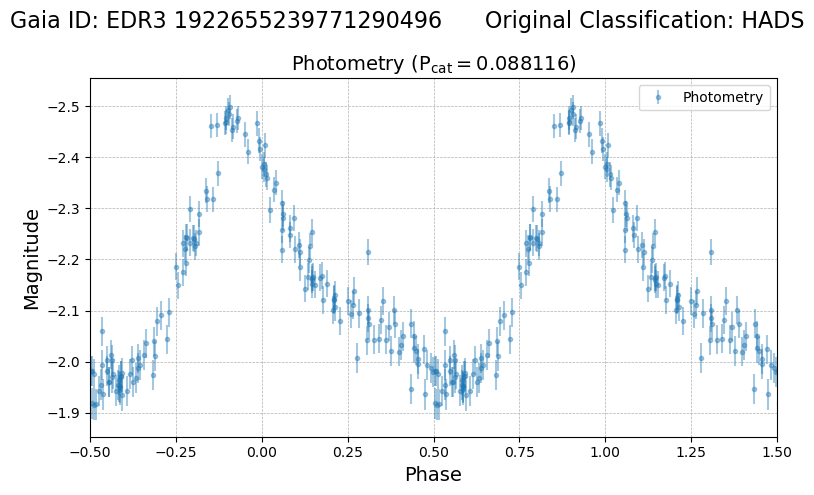

spec-57301-M31_000N44_B1_1_sp05-220.fits.gz


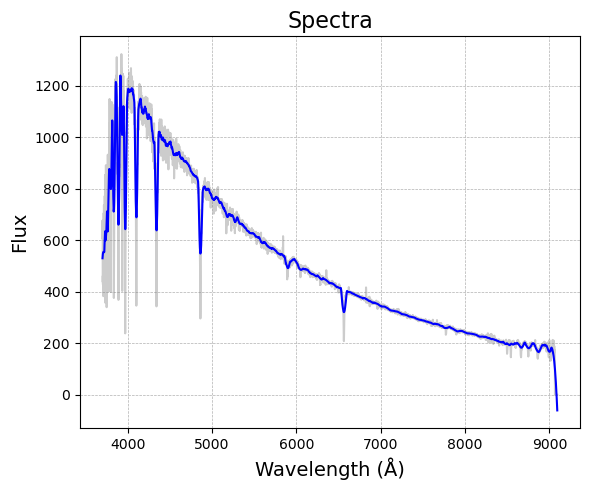

spec-58099-GACII001N45B1_sp02-222.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



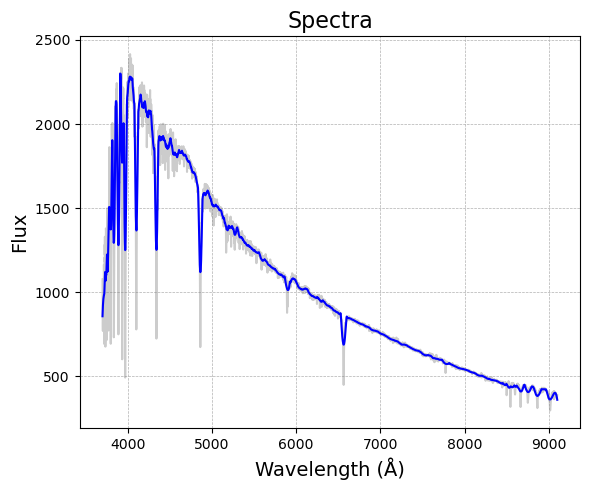

spec-58426-GACII358N41B1_sp12-051.fits.gz


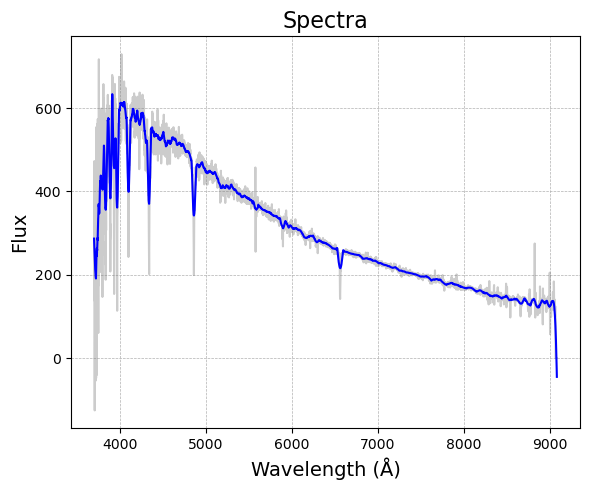

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
258841  0257d99a-c4d8-552b-91fe-ba43fe55ce81    192690   

                        asassn_name other_names    raj2000   dej2000  \
258841  ASASSN-VJ064032.96+214857.3   V0442 Gem  100.13733  21.81591   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
258841  2.457097e+06  3.379041e+18  J064033.00+214857.1    24830947.0   

                  edr3_source_id galex_id         tic_id  
258841  EDR3 3379041296514268672      NaN  TIC 194993232   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
258841       0.45  0.11501            0.05       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
258841      14.25        14.212453           0.010653         14.446178   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
258841  

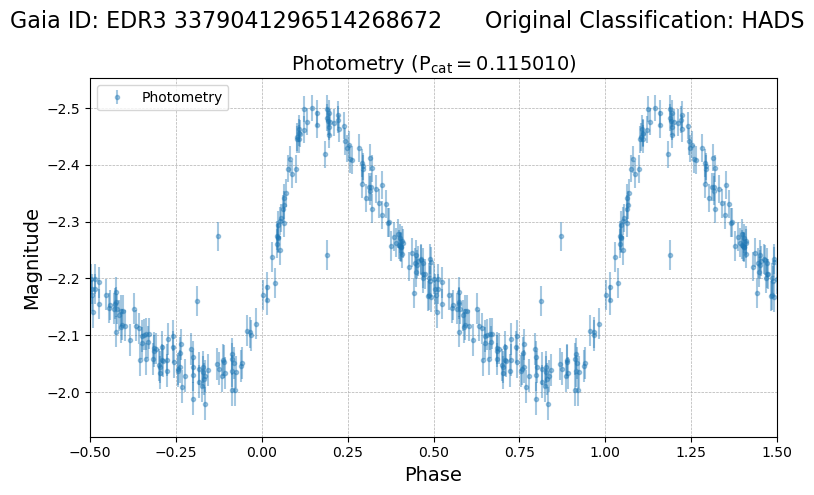

spec-58132-KII063752N233616B01_sp07-048.fits.gz


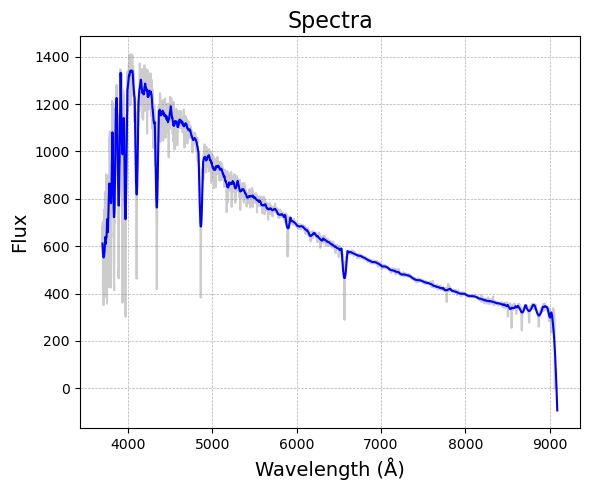

spec-56627-GAC101N22B1_sp10-221.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



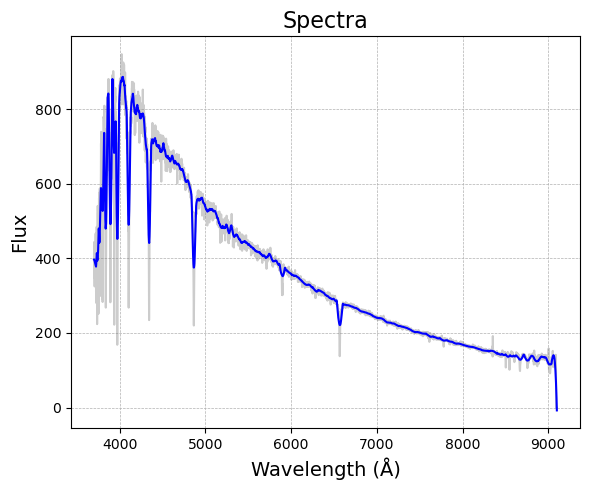

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
496552  78399c10-51e8-5692-b086-ebfcb00acfa9  AP23006647   

                        asassn_name             other_names   raj2000  \
496552  ASASSN-VJ045934.55-065347.4  ATLASJ074.8940-06.8964  74.89396   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
496552 -6.89651  2.457945e+06  3.187106e+18  J045934.56-065347.1   

        apass_dr9_id            edr3_source_id galex_id        tic_id  
496552    23006647.0  EDR3 3187105878139871360      NaN  TIC 43485374   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
496552       0.22  0.075056            0.31       0.84 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
496552      14.68        14.641225           0.003786         14.816503   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

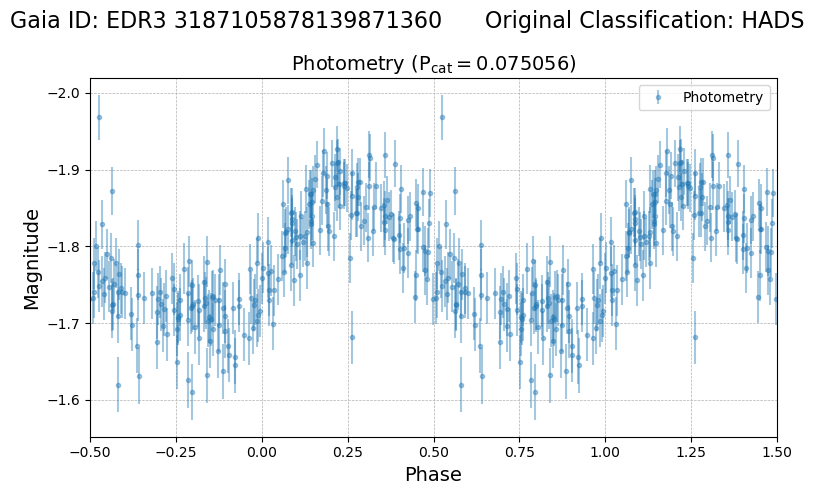

spec-58808-GAC073S05B1_sp07-186.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



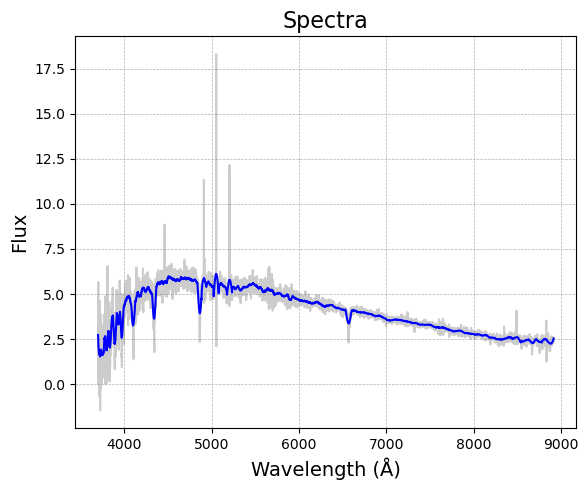

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287315  d698bc87-db16-5920-91f4-108f4e6a9da5    119673   

                        asassn_name          other_names   raj2000  dej2000  \
287315  ASASSN-VJ010618.39+084613.1  ASAS J010618+0846.2  16.57664   8.7703   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287315  2.458138e+06  2.578241e+18  J010618.35+084613.2    16919990.0   

                  edr3_source_id                galex_id         tic_id  
287315  EDR3 2578241178135420800  GALEX J010618.3+084614  TIC 257800712   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
287315        0.3  0.062783            0.17       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287315      11.36        11.330401           0.005403         11.487057   

        e_phot_bp_mean_mag  phot_rp_mean

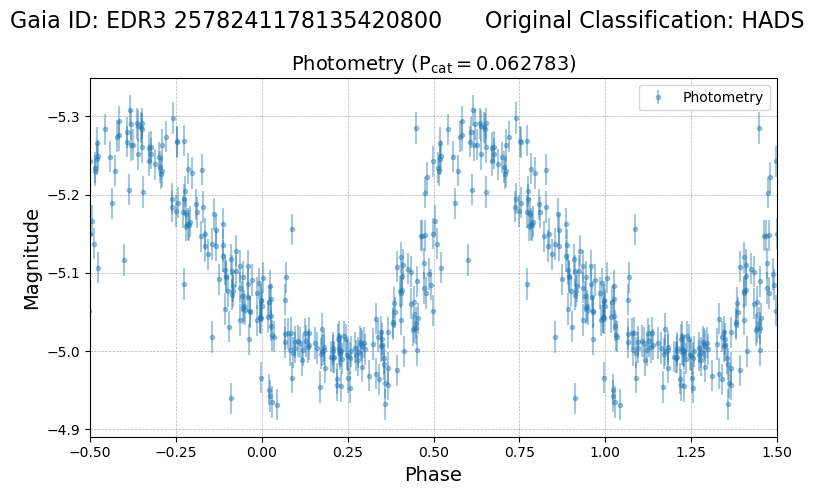

spec-57739-KP011341N085828V01_sp10-237.fits.gz


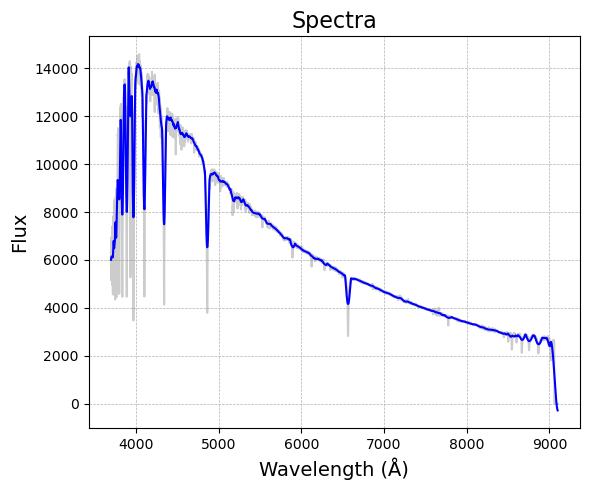

spec-58837-KII011341N085828V01_sp10-014.fits.gz


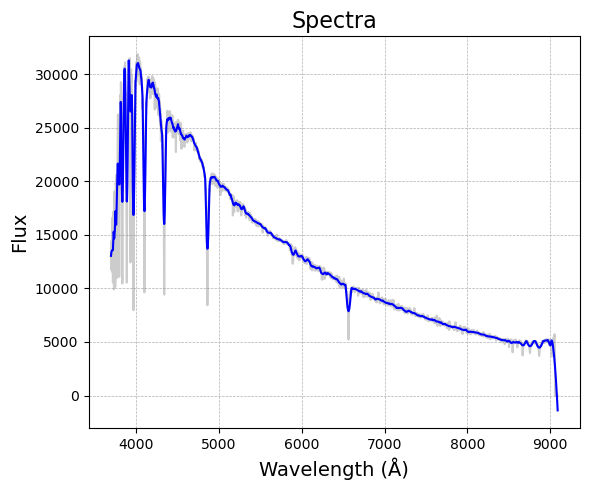

spec-59193-KII010347N064553V01_sp12-073.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



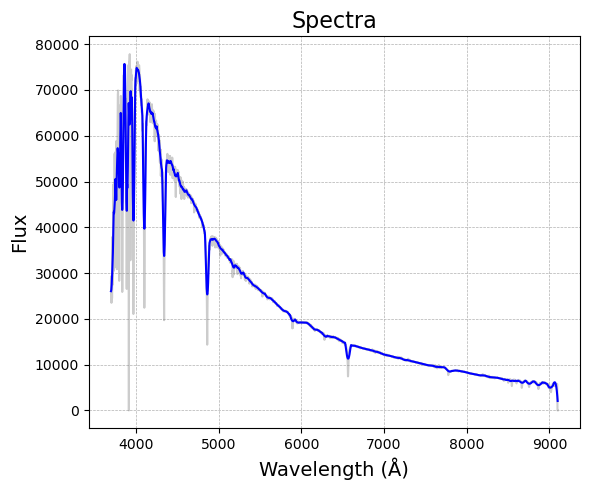

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
520389  4084881f-5e4e-51aa-8066-a4190453064c  AP11007244   

                        asassn_name             other_names    raj2000  \
520389  ASASSN-VJ212030.47+360829.8  ATLASJ320.1269+36.1416  320.12694   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
520389  36.14162  2.457524e+06  1.867568e+18  J212030.45+360829.7   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
520389    11007244.0  EDR3 1867567538259903232      NaN  TIC 373380179   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
520389        0.2  0.131931             0.1       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
520389      12.65         12.56907           0.004308          12.76223   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

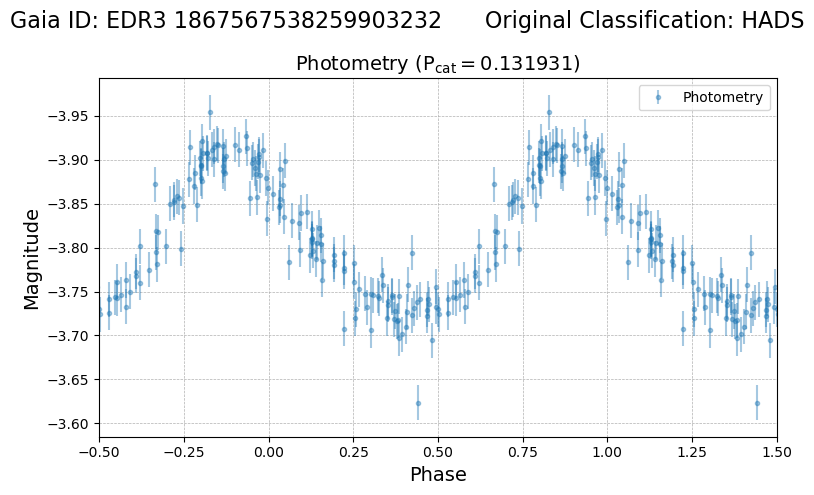

spec-57679-HD212416N373944V01_sp02-054.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



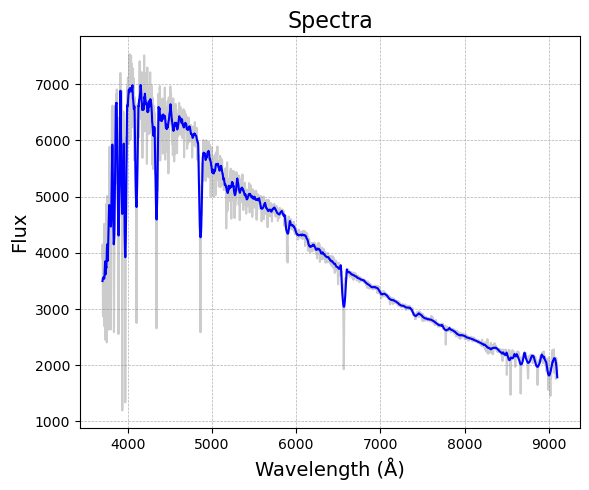

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
520394  fd1c1b52-0f7c-54b5-b236-95d31f06d382  AP24784219   

                        asassn_name             other_names  raj2000  \
520394  ASASSN-VJ063155.13+220138.0  ATLASJ097.9795+22.0272  97.9797   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
520394  22.02723  2.457320e+06  3.376208e+18  J063155.08+220137.9   

        apass_dr9_id            edr3_source_id galex_id        tic_id  
520394    24784219.0  EDR3 3376207855047707648      NaN  TIC 54408781   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
520394       0.24  0.102895            0.09       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
520394      14.05        14.166343             0.0067         14.468681   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

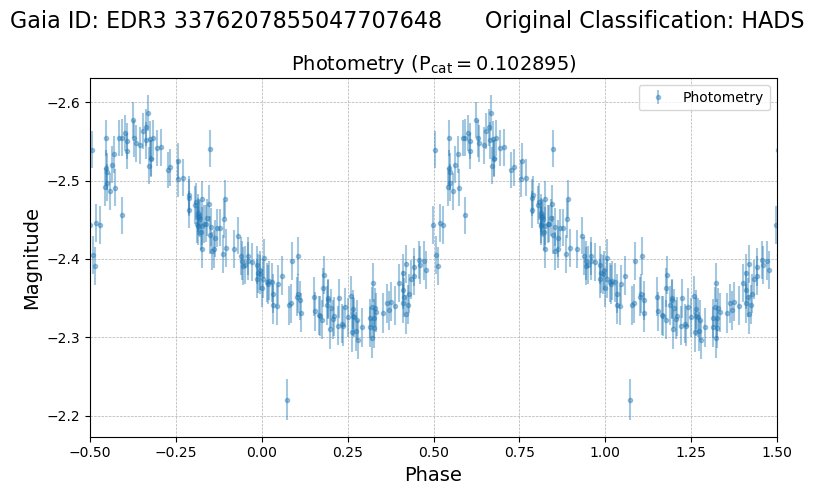

spec-58457-KII062257N223048B01_sp06-198.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



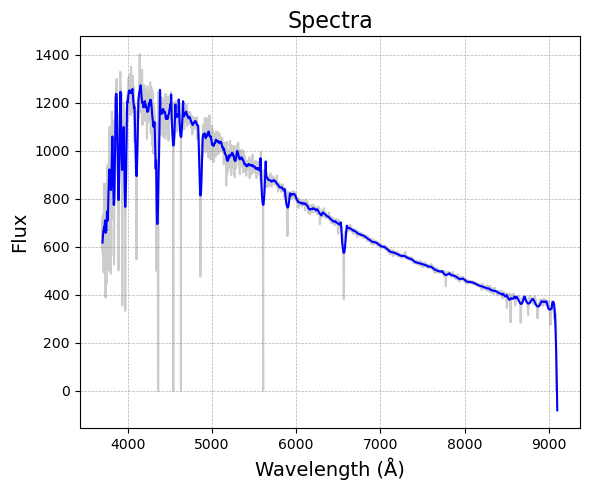

spec-59167-KII062257N223048B02_sp06-198.fits.gz


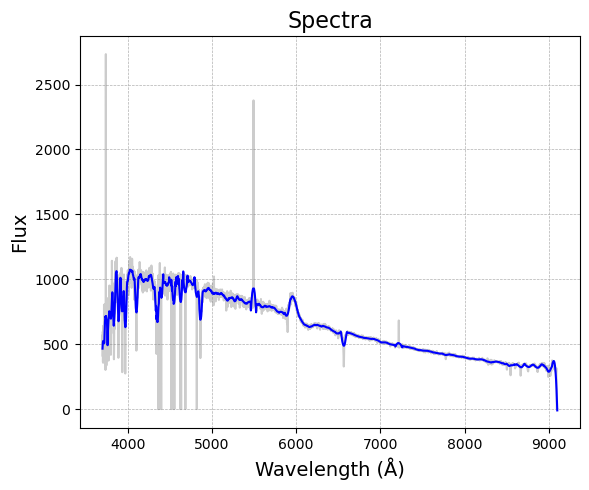

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
232037  931678b1-46fd-5d21-8d56-865e303b83fb    115615   

                        asassn_name     other_names    raj2000   dej2000  \
232037  ASASSN-VJ115725.63+461637.7  LINEAR 2634740  179.35681  46.27714   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
232037  2.457699e+06  7.742330e+17  J115725.59+461637.8     5754903.0   

                 edr3_source_id                galex_id         tic_id  
232037  EDR3 774232971104573824  GALEX J115725.7+461638  TIC 141159298   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
232037       0.51  0.056524            0.44       0.78 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
232037      15.96        15.935277           0.006635         16.060406   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_

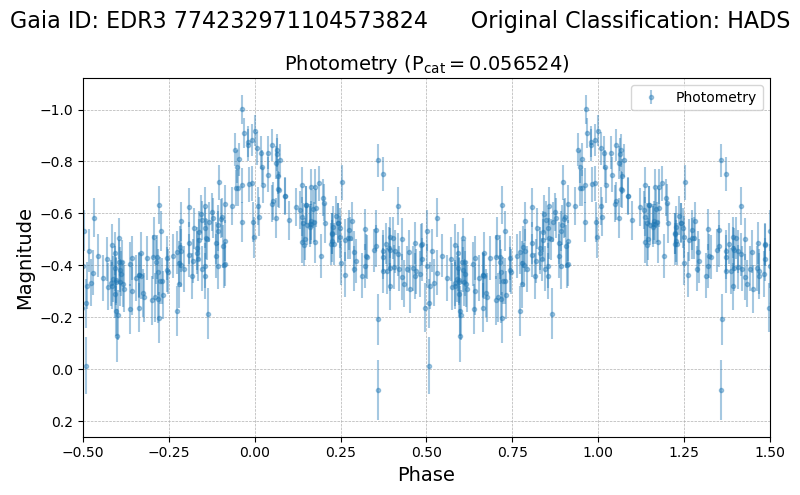

spec-56679-HD115505N462836B01_sp04-121.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



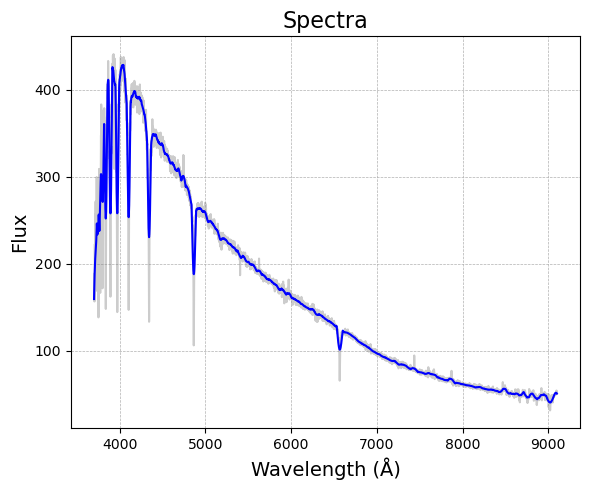

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
42601  ae39ef84-cae2-59fc-85ef-1a5ac6fe31a6    654399   

                       asassn_name other_names  raj2000   dej2000  \
42601  ASASSN-VJ041851.10+191511.7         NaN  64.7129  19.25311   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
42601  2.457613e+06  4.784299e+16  J041851.09+191511.8      145242.0   

               edr3_source_id galex_id        tic_id  
42601  EDR3 47842985036574464      NaN  TIC 17199097   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
42601       0.27  0.094491            0.18       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
42601      14.69        14.481723           0.005459         14.911305   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
42601            0.018557    

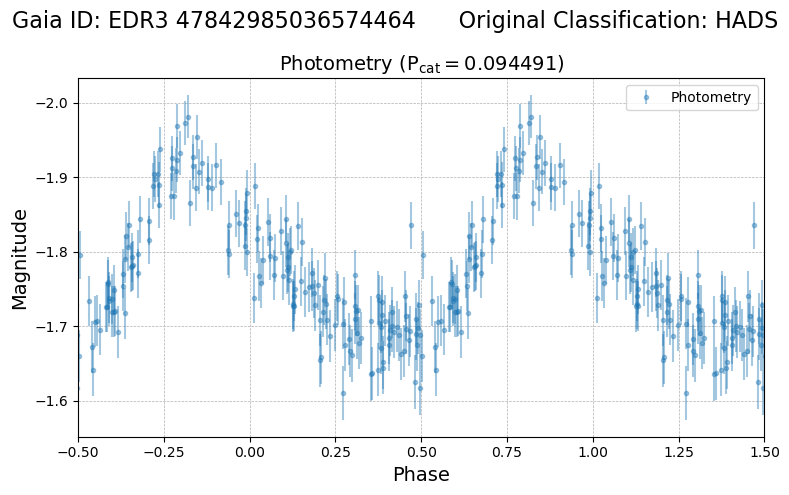

spec-58840-KII041801N181524B01_sp15-147.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



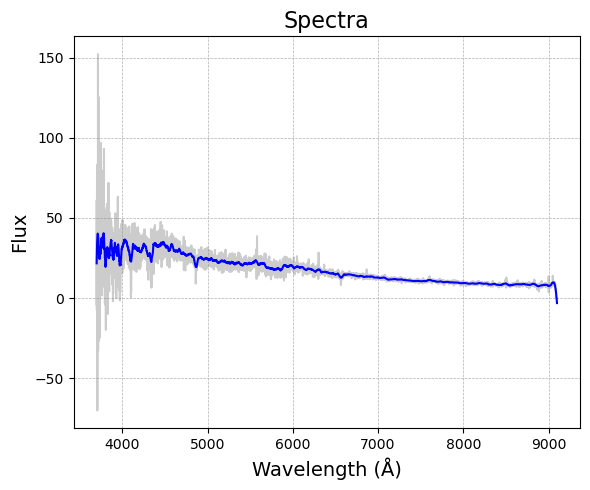

spec-59224-TD042836N191049H01_sp14-031.fits.gz


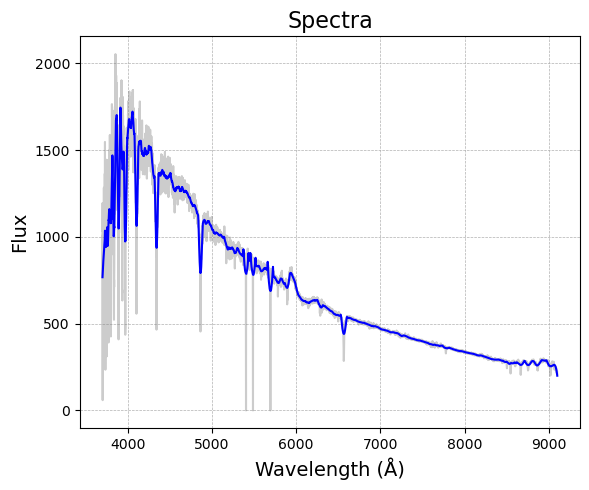

spec-59233-TD042836N191049H01_sp14-031.fits.gz


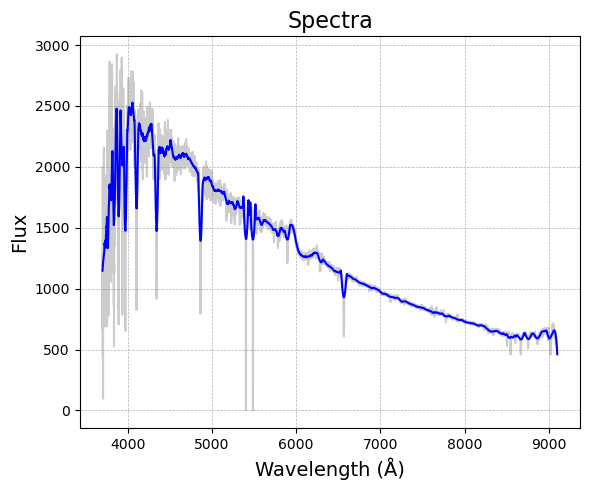

spec-59251-TD042836N191049H01_sp14-031.fits.gz


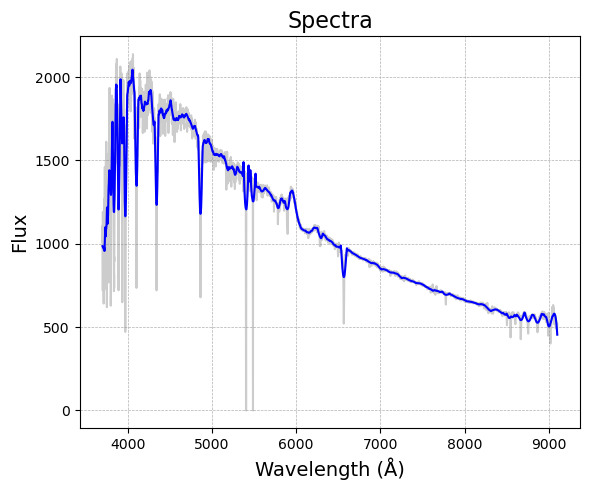

spec-57067-GAC062N19B2_sp06-131.fits.gz


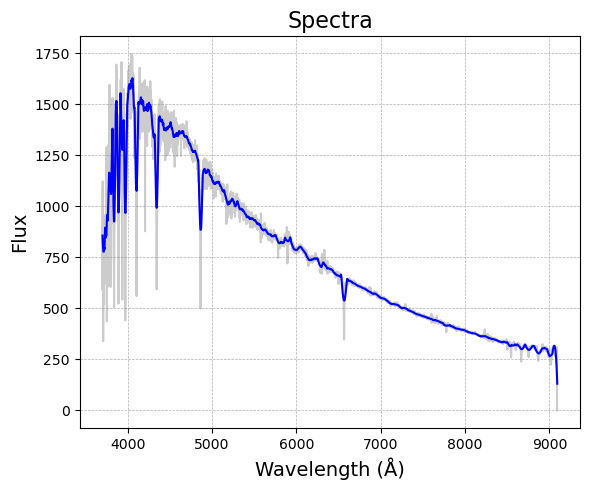

spec-59263-TD042836N191049H01_sp14-031.fits.gz


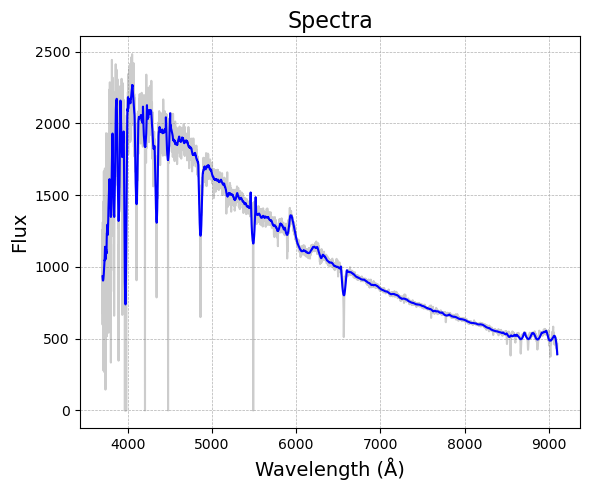

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
452252  c982e758-7dad-5408-a069-c4ca1d2c254f  AP8153101   

                        asassn_name other_names    raj2000   dej2000  \
452252  ASASSN-VJ161331.69+323442.5       AUCrB  243.38203  32.57846   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
452252  2.456815e+06  1.322504e+18  J161331.69+323442.4     8153101.0   

                  edr3_source_id                galex_id        tic_id  
452252  EDR3 1322503791460292608  GALEX J161331.6+323442  TIC 17539022   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
452252       0.18  0.05172            0.13       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
452252      11.89          11.9058           0.003633         12.020865   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

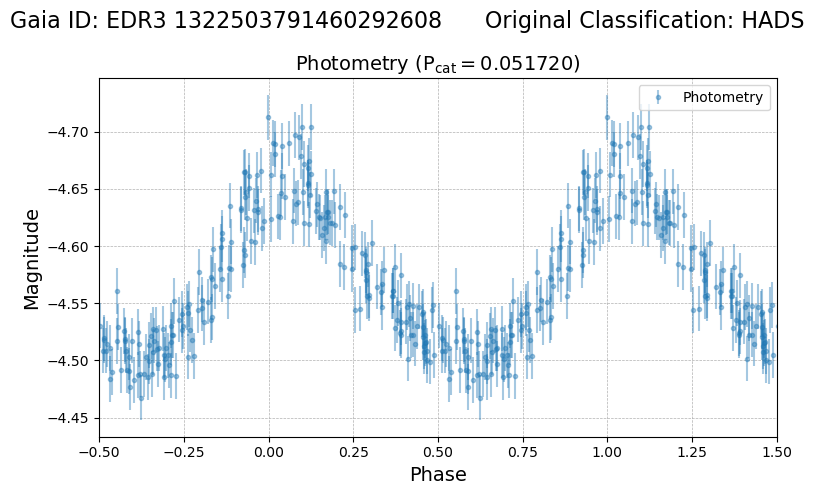

spec-56723-HD162301N323735V01_sp10-005.fits.gz


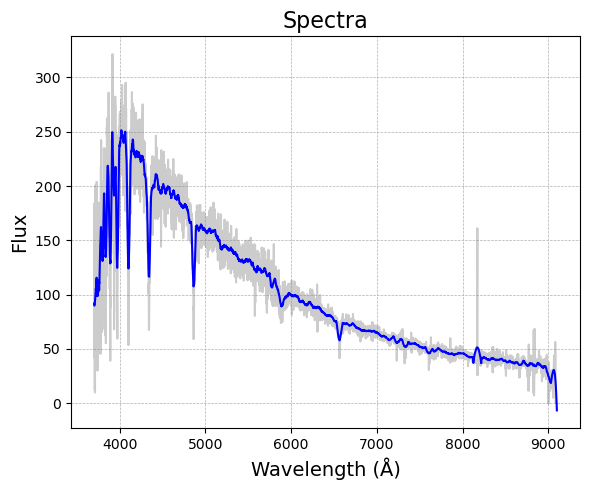

spec-57502-HD162301N323735V02_sp10-005.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



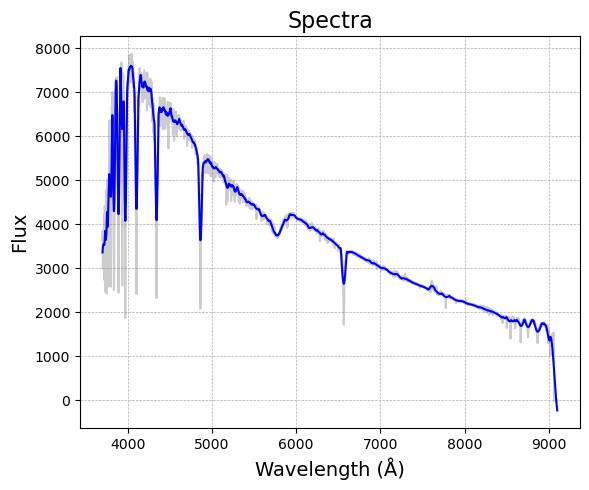

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
176212  fa3303cb-6625-541b-b109-03a0210d856b    122755   

                        asassn_name      other_names    raj2000  dej2000  \
176212  ASASSN-VJ103534.61+092954.3  LINEAR 22829618  158.89421  9.49842   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
176212  2.457324e+06  3.869857e+18  J103534.58+092954.3    27442487.0   

                  edr3_source_id galex_id         tic_id  
176212  EDR3 3869857003614880896      NaN  TIC 392848764   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
176212       0.32  0.069794            0.43       0.78 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
176212      15.54         15.47103           0.007356         15.632903   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  

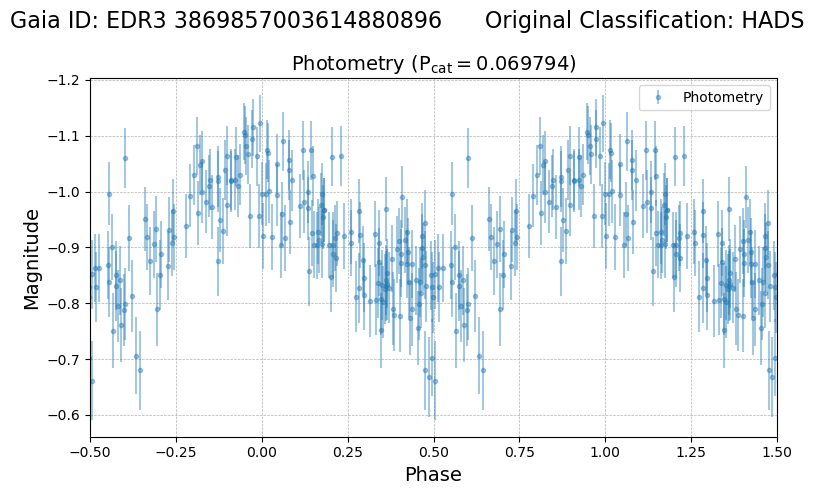

spec-56345-HD102626N103010M01_sp06-116.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



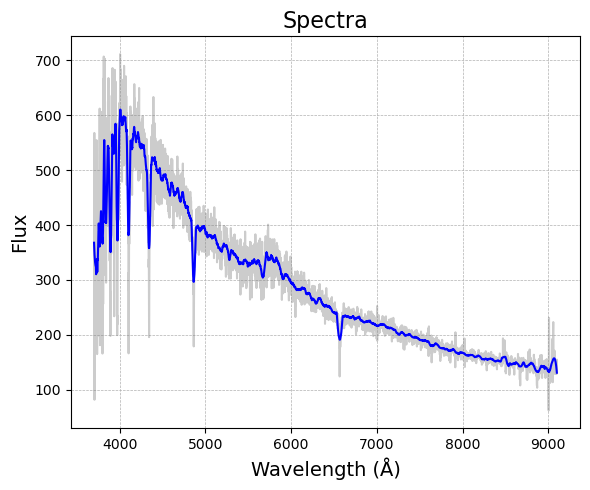

spec-57503-HD102626N103010B02_sp06-116.fits.gz


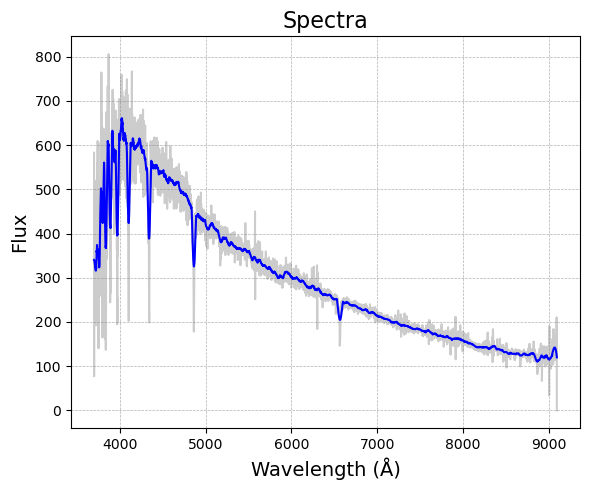

spec-58127-KII103248N091823B01_sp09-019.fits.gz


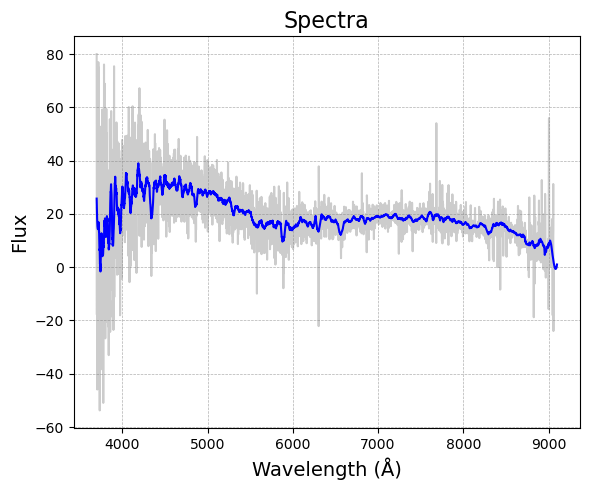

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
46932  ab7dd0bf-eda3-5e52-9ba8-916949c0180a    494535   

                       asassn_name other_names    raj2000   dej2000  \
46932  ASASSN-VJ182439.29+303218.7         NaN  276.16345  30.53865   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
46932  2.457648e+06  4.591464e+18  J182439.28+303218.4    35869976.0   

                 edr3_source_id galex_id        tic_id  
46932  EDR3 4591463839229483008      NaN  TIC 23944081   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
46932       0.38  0.057481            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
46932      14.14        14.124549           0.005908         14.331343   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
46932            0.01

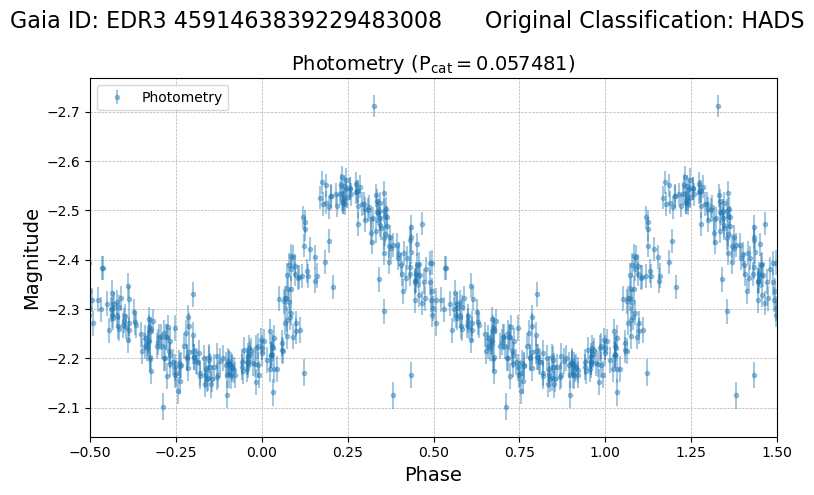

spec-57169-HD183419N294430B01_sp14-107.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



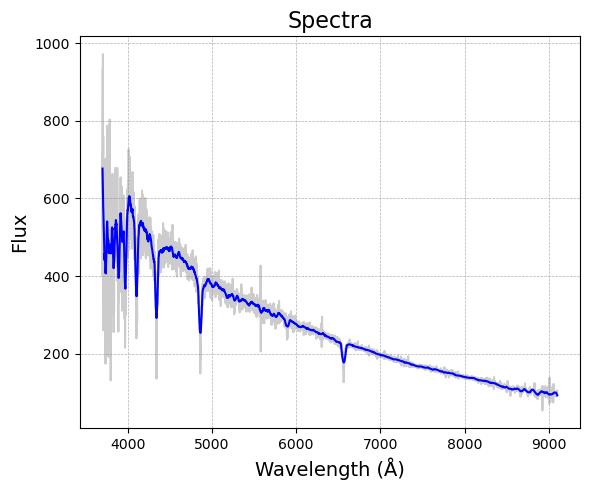

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
41742  1ae0f85a-497f-5c9e-ade0-aa43bcc584e3    654919   

                       asassn_name other_names   raj2000  dej2000  \
41742  ASASSN-VJ043004.45-060841.2         NaN  67.51866 -6.14487   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
41742  2.456981e+06  3.199380e+18  J043004.44-060841.1    23054314.0   

                 edr3_source_id                galex_id        tic_id  
41742  EDR3 3199380104398645760  GALEX J043004.4-060841  TIC 38016837   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude  period  lksl_statistic  rfr_score
41742       0.27  0.0627            0.11       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
41742      13.96        13.913214           0.005534         14.050669   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \

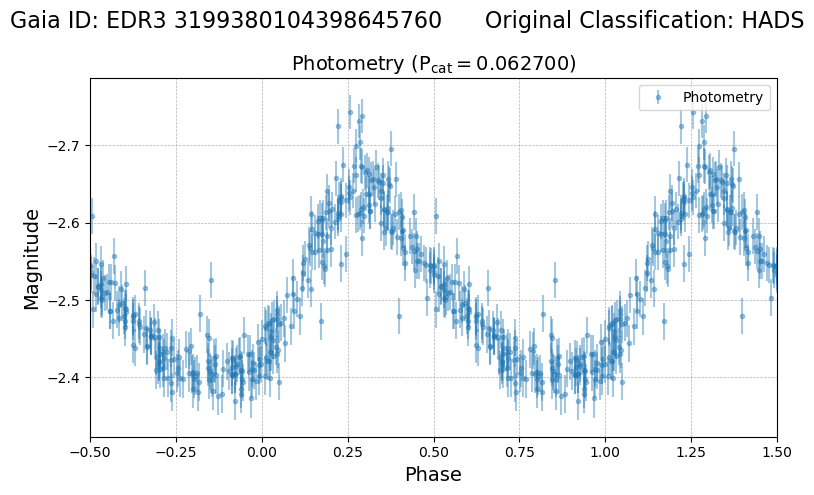

spec-56629-EG042038S061445V01_sp13-069.fits.gz


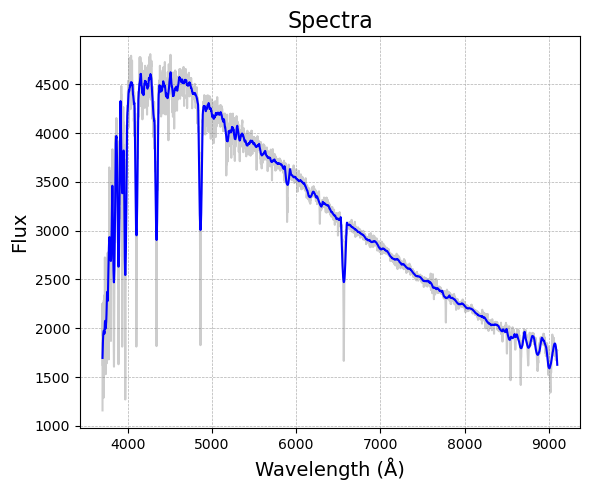

spec-57377-EG043159S042253V01_sp01-058.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



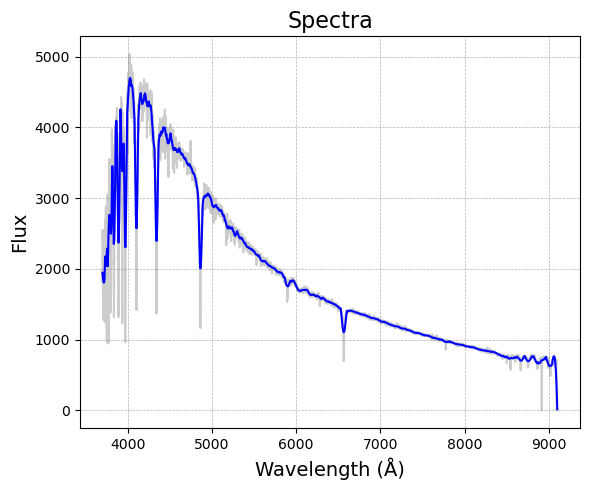

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
482136  f961b01d-ae31-556a-85d6-5c5e12a5b761  AP10880930   

                        asassn_name             other_names    raj2000  \
482136  ASASSN-VJ204444.06+293430.4  ATLASJ311.1831+29.5753  311.18358   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
482136  29.57512  2.457827e+06  1.858930e+18  J204443.96+293431.2   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
482136    10880930.0  EDR3 1858929676141128192      NaN  TIC 281953880   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
482136       0.15  0.083246            0.44       0.79 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
482136       13.9         13.82352           0.003153         14.196202   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

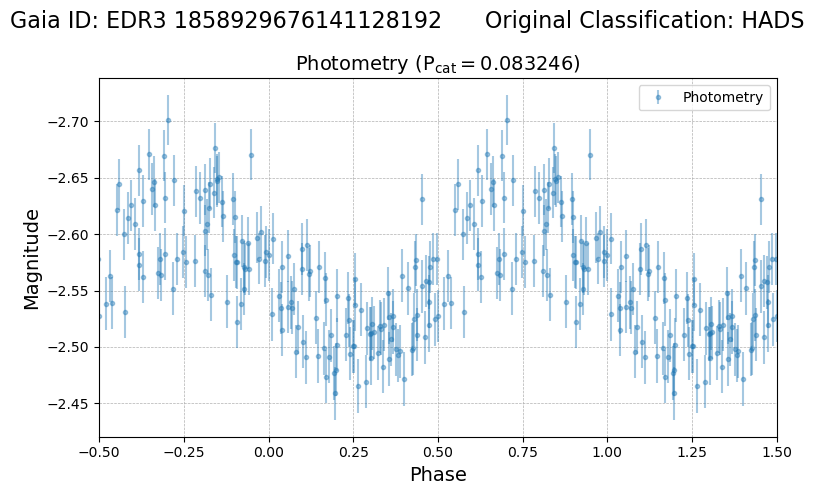

spec-57695-HD205307N293856V01_sp10-013.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



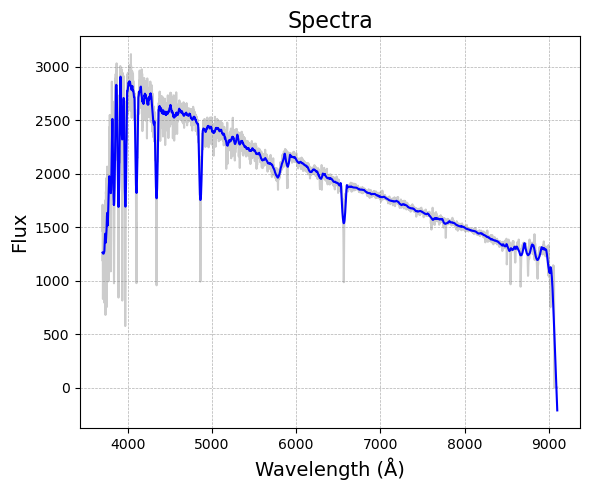

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
260538  ef1b94e9-3995-595e-b0f4-0029b2338c72    369058   

                        asassn_name           other_names    raj2000  dej2000  \
260538  ASASSN-VJ085636.34-022534.9  CSS_J085636.3-022534  134.15141 -2.42636   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
260538  2.457315e+06  5.763703e+18  J085636.42-022535.1    47149329.0   

                  edr3_source_id                galex_id        tic_id  
260538  EDR3 5763703350814845440  GALEX J085636.4-022534  TIC 71199248   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
260538       0.42  0.088273            0.36       0.83 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
260538      14.67        14.620838           0.008117         14.783593   

        e_phot_bp_mean_mag  phot_rp_me

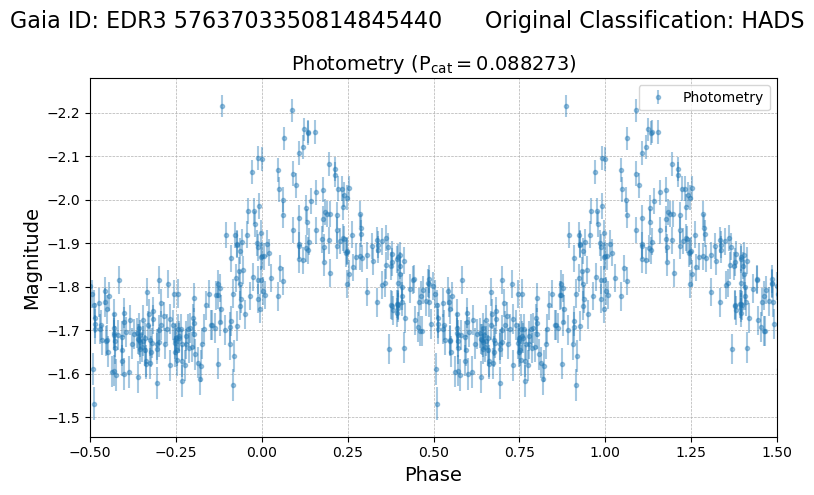

spec-58870-HD084826S023115B02_sp13-065.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



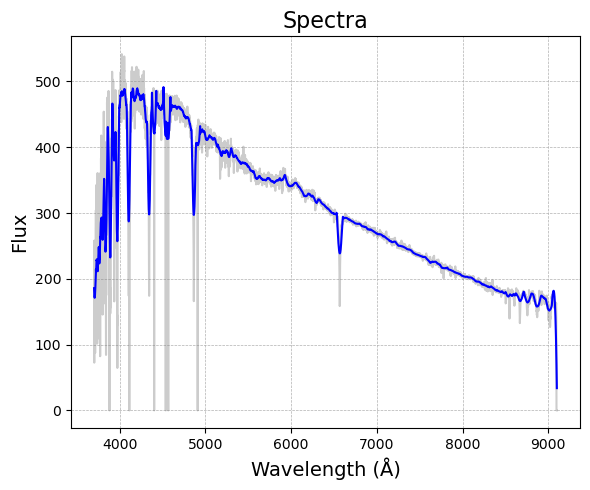

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
234670  dd1ac1f5-1ee5-5da0-9711-a60416966259     58904   

                        asassn_name      other_names    raj2000   dej2000  \
234670  ASASSN-VJ160915.69+253116.2  LINEAR 16574303  242.31536  25.52118   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
234670  2.456491e+06  1.315117e+18  J160915.70+253116.7     8128814.0   

                  edr3_source_id                galex_id         tic_id  
234670  EDR3 1315117031827393024  GALEX J160915.7+253116  TIC 236334936   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
234670       0.39  0.059126            0.16       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
234670      15.12        15.134148           0.005444         15.277582   

        e_phot_bp_mean_mag  phot_rp_mean_mag

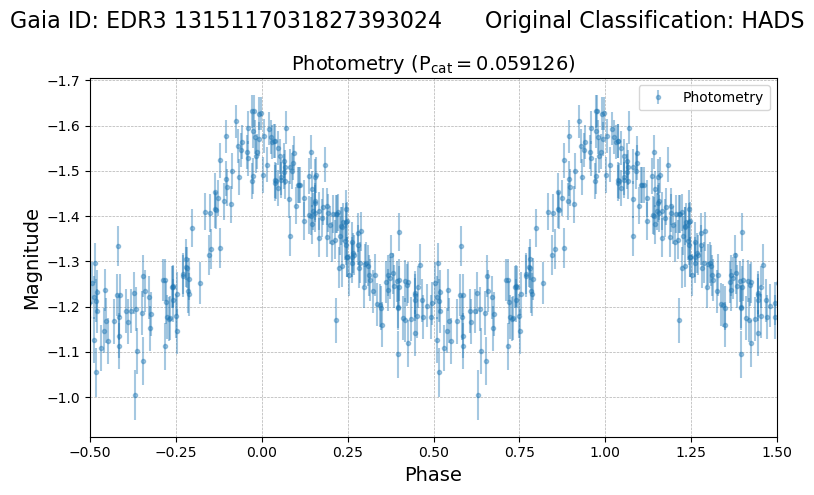

spec-58200-HD160238N263643B01_sp06-004.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



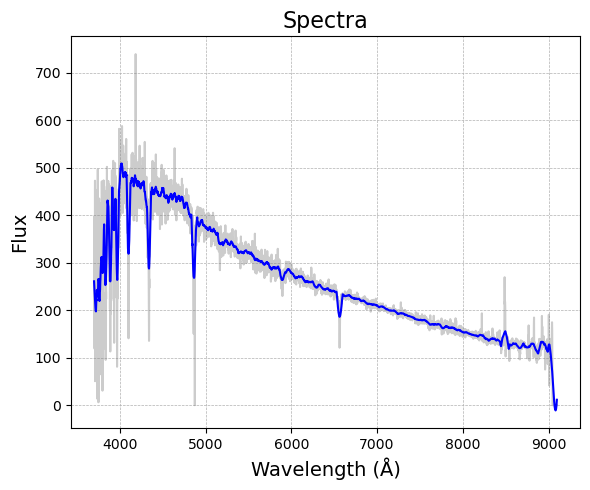

spec-58228-HD160238N263643B02_sp06-004.fits.gz


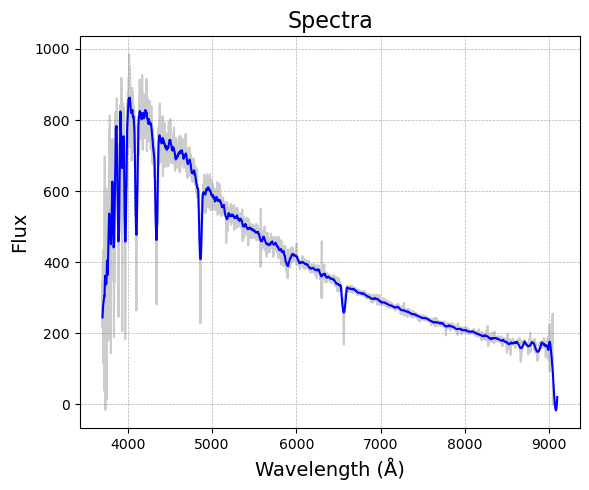

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
482575  0c9f0c41-98dc-5213-8432-25da34937340  AP10895306   

                        asassn_name             other_names    raj2000  \
482575  ASASSN-VJ204626.08+313753.3  ATLASJ311.6092+31.6314  311.60868   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
482575  31.63146  2.457488e+06  1.859821e+18  J204626.23+313753.0   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
482575    10895306.0  EDR3 1859820692878440064      NaN  TIC 232882264   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
482575        0.2  0.06668            0.53       0.75 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
482575      13.68        13.742542           0.004045         13.974523   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

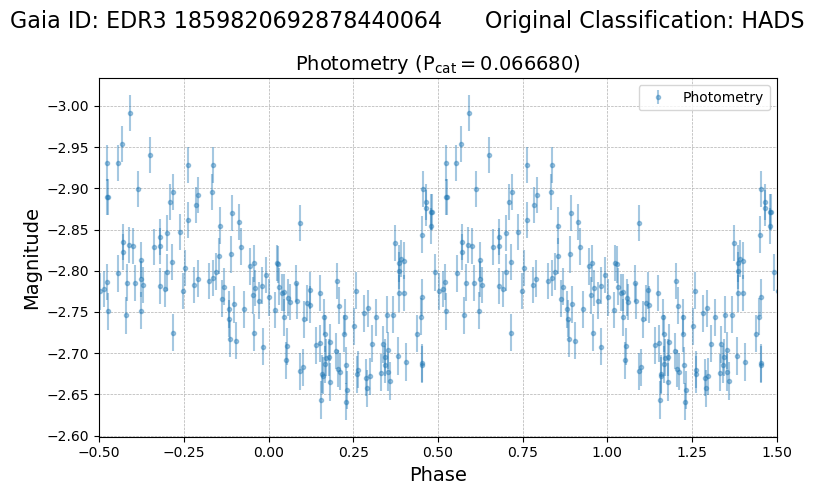

spec-57695-HD205307N293856V01_sp16-041.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



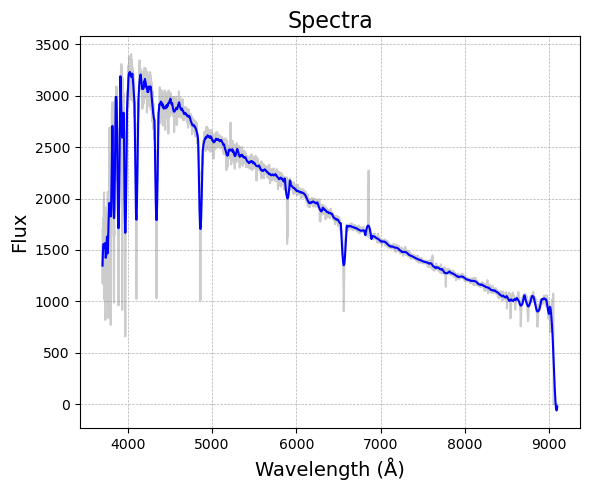

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
286968  5d650db9-1fa4-51cf-ba6d-77e6f12f6ed4    148949   

                        asassn_name                  other_names    raj2000  \
286968  ASASSN-VJ085854.73+152210.5  TSVSC1 TN-N231330220-6-67-2  134.72805   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
286968  15.36957  2.456987e+06  6.103656e+17  J085854.70+152209.6   

        apass_dr9_id           edr3_source_id galex_id         tic_id  
286968     5213290.0  EDR3 610365606390803328      NaN  TIC 437050839   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
286968       0.37  0.057629            0.08       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
286968      13.87        13.866729           0.006479         13.991373   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

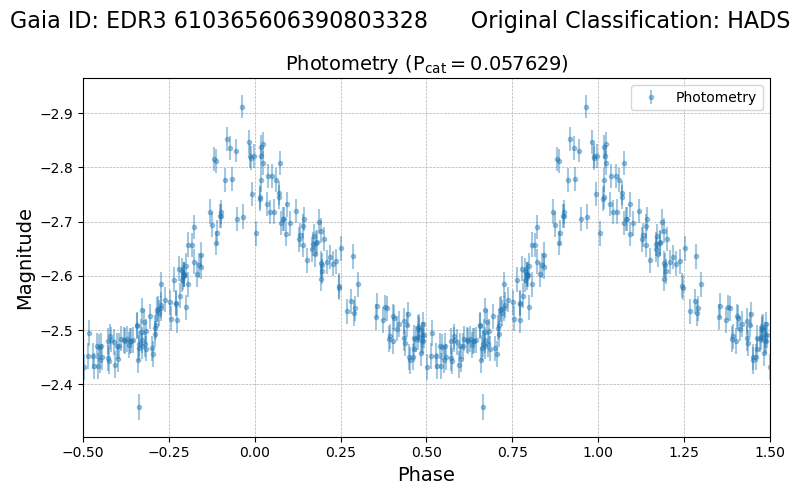

spec-56325-HD085101N152102B01_sp06-029.fits.gz


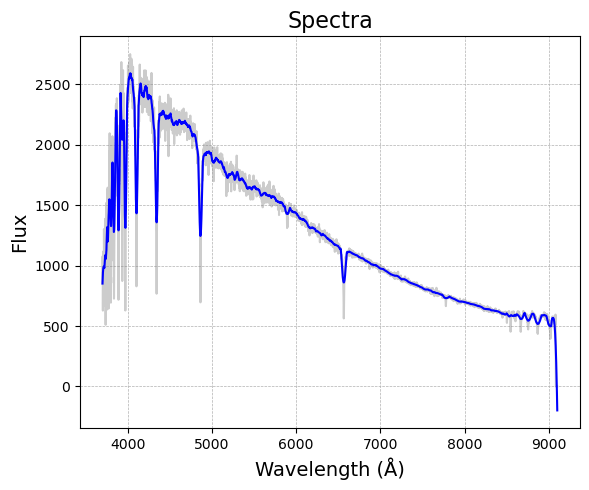

spec-56325-HD085101N152102F01_sp06-029.fits.gz


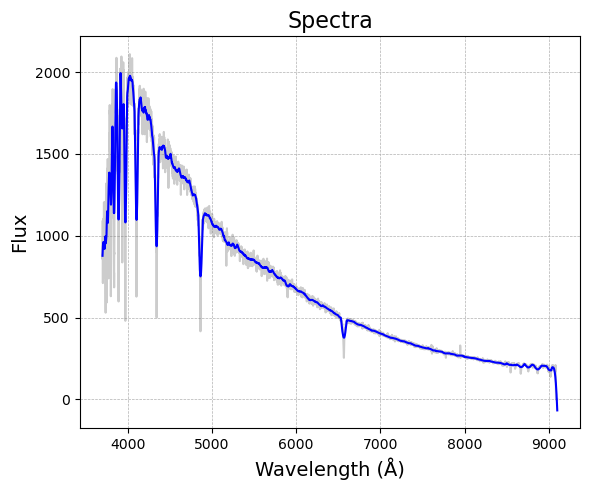

spec-57119-HD085101N152102V01_sp06-029.fits.gz


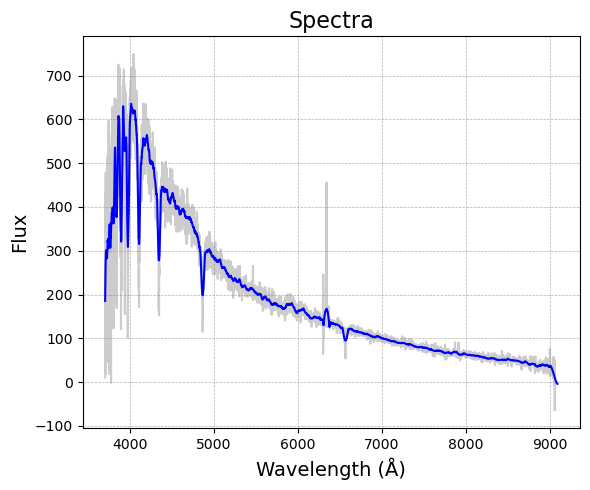

spec-57127-HD090808N144241V01_sp14-124.fits.gz


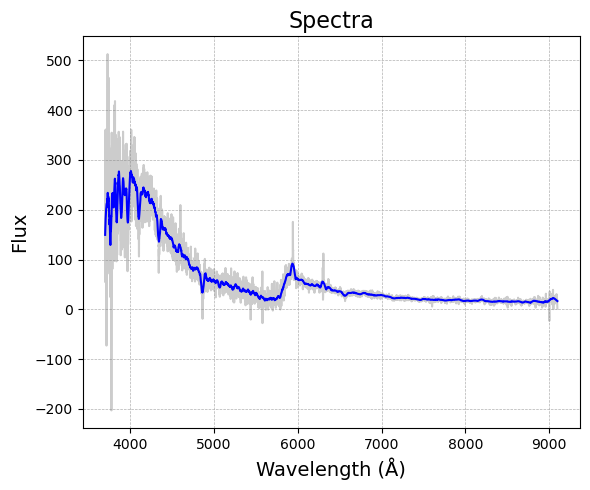

spec-57417-KP085714N151921V01_sp04-231.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



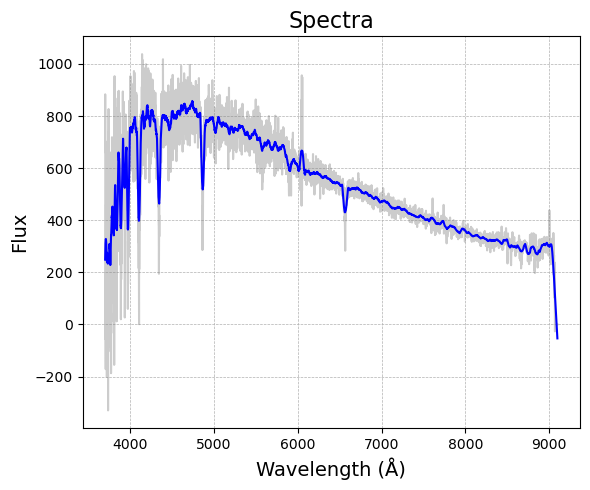

spec-57859-HD090808N144241V02_sp14-124.fits.gz


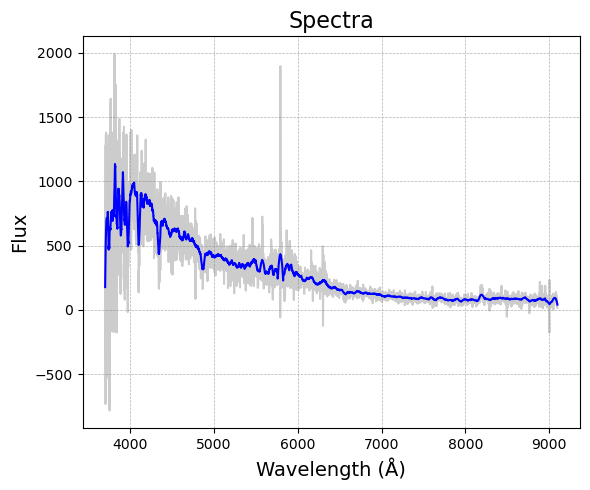

spec-58524-KII085714N151921V01_sp04-231.fits.gz


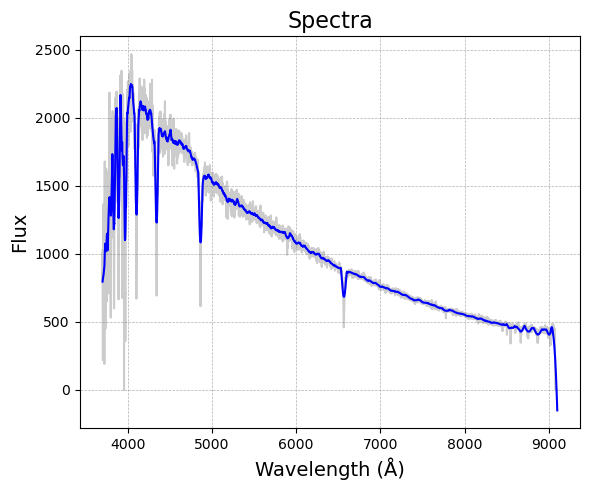

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
234182  38fd9f53-67d9-5b98-ac19-5a656422c3b3    110680   

                        asassn_name           other_names   raj2000   dej2000  \
234182  ASASSN-VJ232053.71+373851.6  CSS_J232053.7+373851  350.2238  37.64768   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
234182  2.457169e+06  1.916872e+18  J232053.70+373851.4    11532494.0   

                  edr3_source_id                galex_id         tic_id  
234182  EDR3 1916871774250128256  GALEX J232053.6+373851  TIC 127369784   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
234182       0.56  0.103288            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
234182      14.66        14.612795           0.008531         14.847335   

        e_phot_bp_mean_mag  phot_rp_

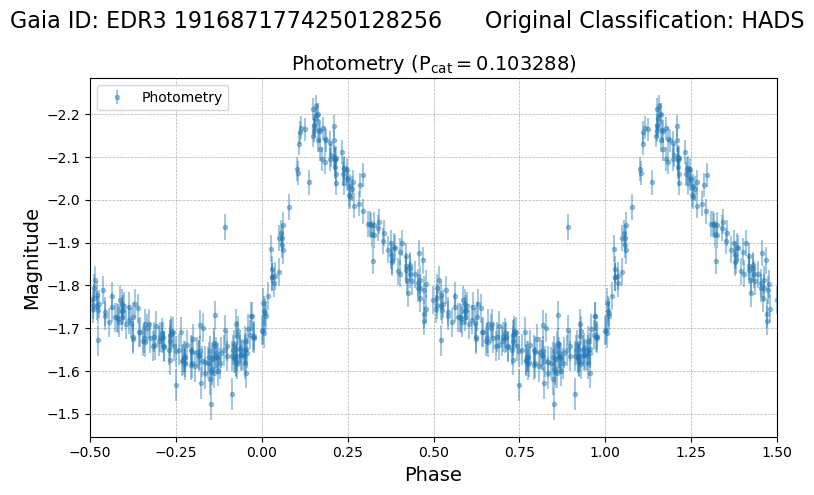

spec-56971-HD231600N352358B01_sp12-247.fits.gz


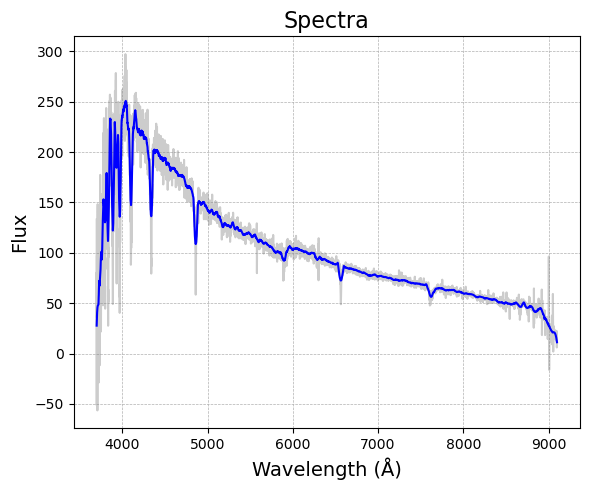

spec-58398-GACII349N35B1_sp11-065.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



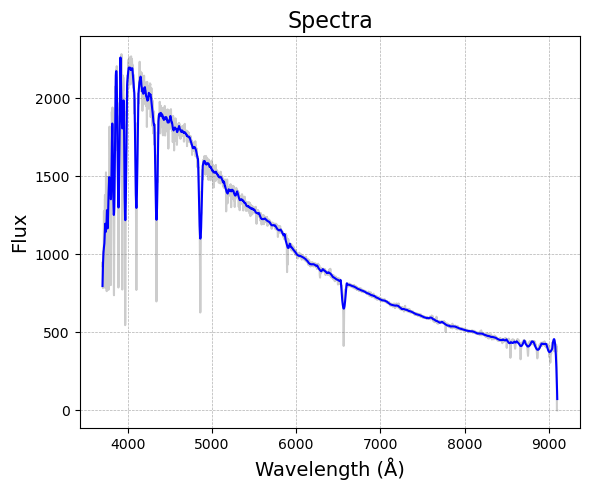

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
254718  c22c22e4-ece9-58b8-81b5-71b5c970b361    118243   

                        asassn_name           other_names    raj2000  dej2000  \
254718  ASASSN-VJ152807.34+060802.1  CSS_J152807.3+060802  232.03057  6.13392   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
254718  2.457022e+06  1.162498e+18  J152807.34+060802.2     7686818.0   

                  edr3_source_id galex_id         tic_id  
254718  EDR3 1162498255180730624      NaN  TIC 323130828   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
254718       0.33  0.111006            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
254718      14.06        14.014495           0.007612         14.168933   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

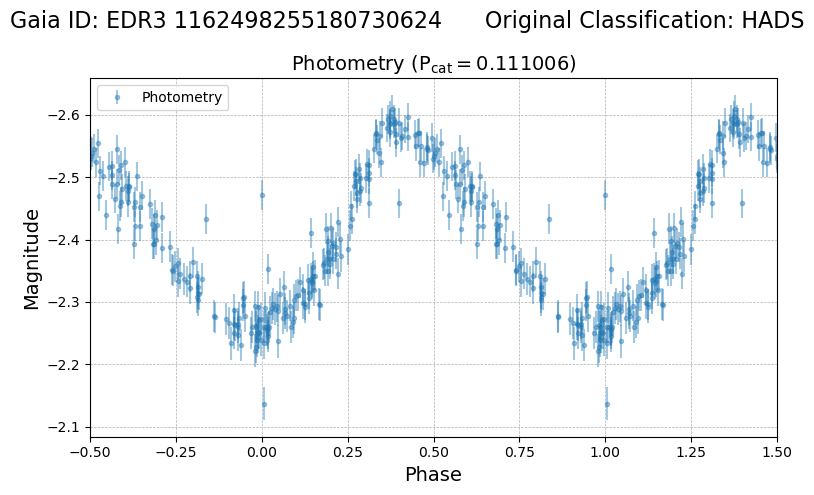

spec-58643-HD152645N051412B02_sp09-157.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



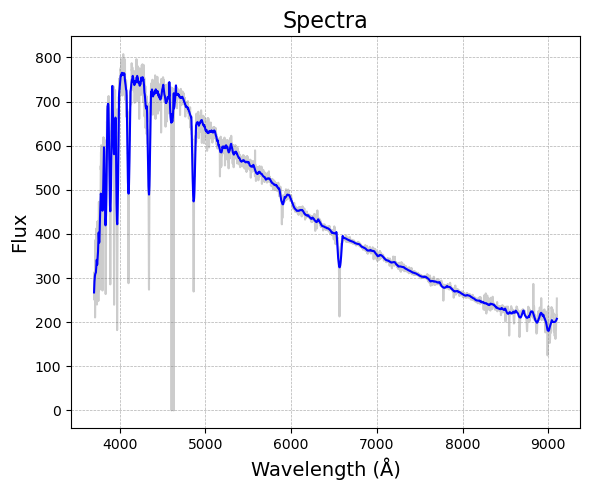

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
143645  009a6519-bc0c-532a-b0ab-10a699bbaf2f    128874   

                        asassn_name      other_names    raj2000   dej2000  \
143645  ASASSN-VJ074722.36+220414.7  GSC 01374-01131  116.84318  22.07074   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
143645  2.458003e+06  6.746490e+17  J074722.46+220413.9     5490733.0   

                 edr3_source_id                galex_id        tic_id  
143645  EDR3 674648961730192000  GALEX J074722.4+220414  TIC 62897412   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
143645       0.27  0.16989            0.13       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
143645      14.09        14.016645           0.005701         14.245996   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

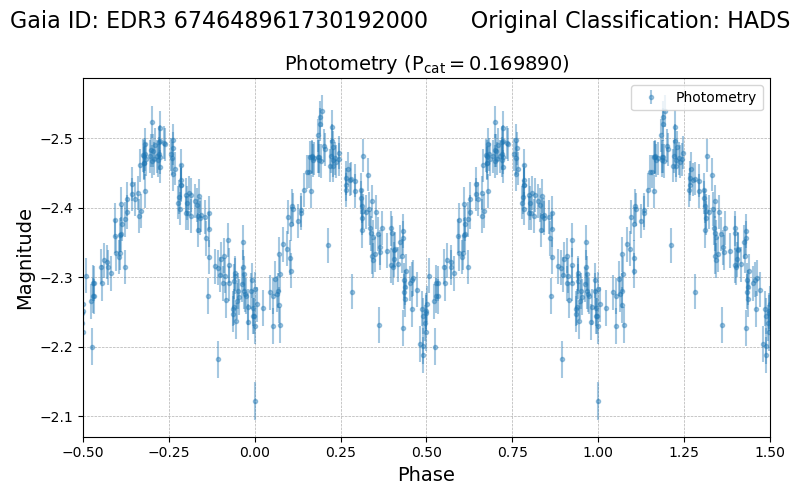

spec-56608-GAC116N20B2_sp11-073.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



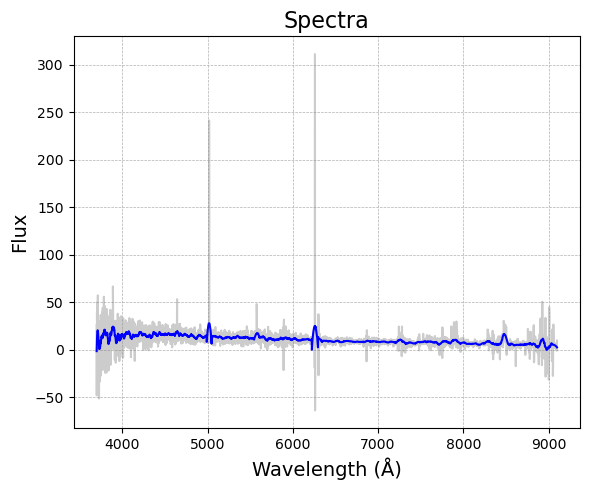

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
177969  60d63621-c8b8-5260-9410-16aa7c4f1647    110490   

                        asassn_name          other_names    raj2000  dej2000  \
177969  ASASSN-VJ145223.70+031831.2  ASAS J145224+0318.5  223.09875  3.30868   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
177969  2.457886e+06  1.157578e+18  J145223.73+031831.5     7669181.0   

                  edr3_source_id                galex_id         tic_id  
177969  EDR3 1157578421682601088  GALEX J145223.7+031832  TIC 461245486   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
177969       0.21  0.11235            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
177969      12.95        12.931583           0.005293         13.088616   

        e_phot_bp_mean_mag  phot_rp_mean

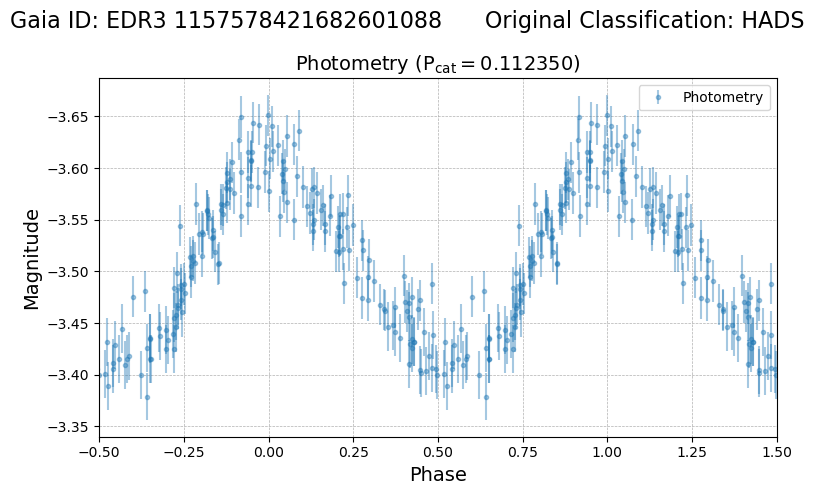

spec-56687-HD144614N015334V_sp12-020.fits.gz


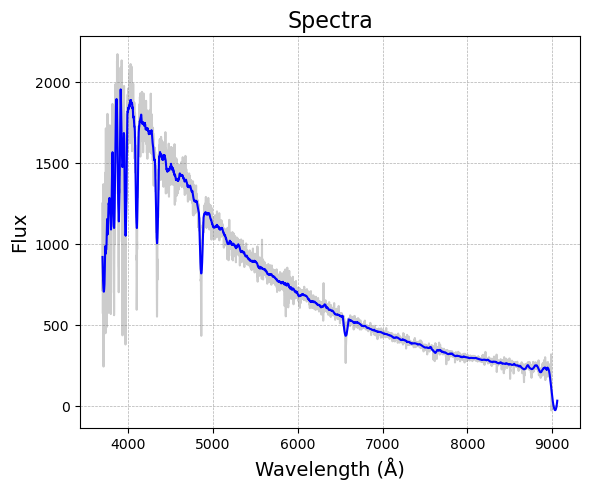

spec-56741-HD145704N052550V_sp02-201.fits.gz


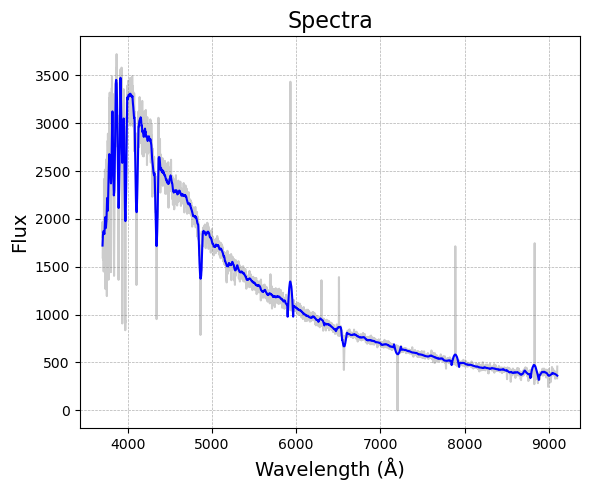

spec-57785-HD144614N015334B01_sp12-004.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



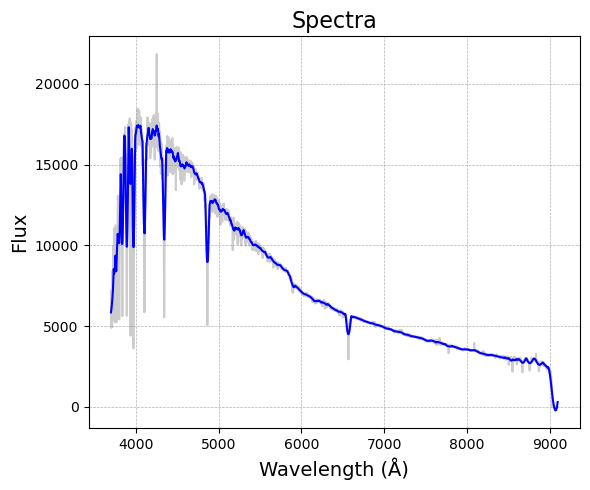

spec-58160-HD144614N015334B02_sp12-012.fits.gz


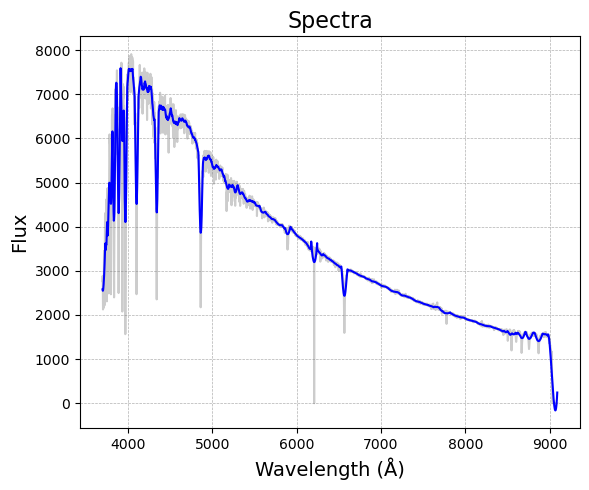

spec-58170-HD144614N015334V02_sp12-012.fits.gz


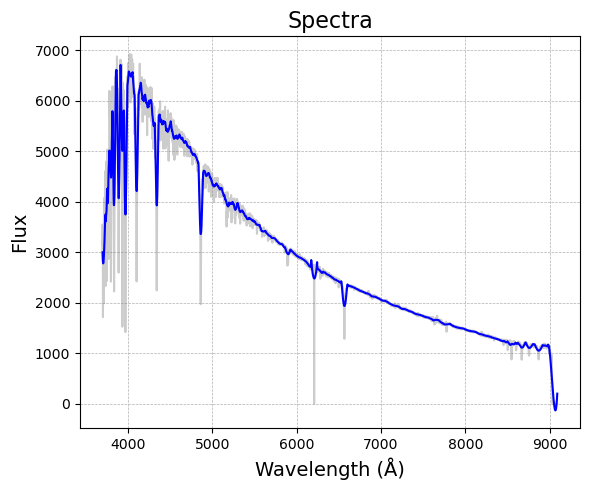

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
236590  21fa4931-8ce3-50fa-b5fb-3bf24a465e7e    109373   

                        asassn_name other_names    raj2000   dej2000  \
236590  ASASSN-VJ121340.78+171438.2      PT Com  183.41992  17.24394   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
236590  2.456795e+06  3.946686e+18  J121340.76+171437.8    27615783.0   

                  edr3_source_id                galex_id         tic_id  
236590  EDR3 3946686478118042112  GALEX J121340.8+171438  TIC 335826251   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
236590       0.29  0.082113            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
236590      11.99        12.000633           0.005863          12.14213   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

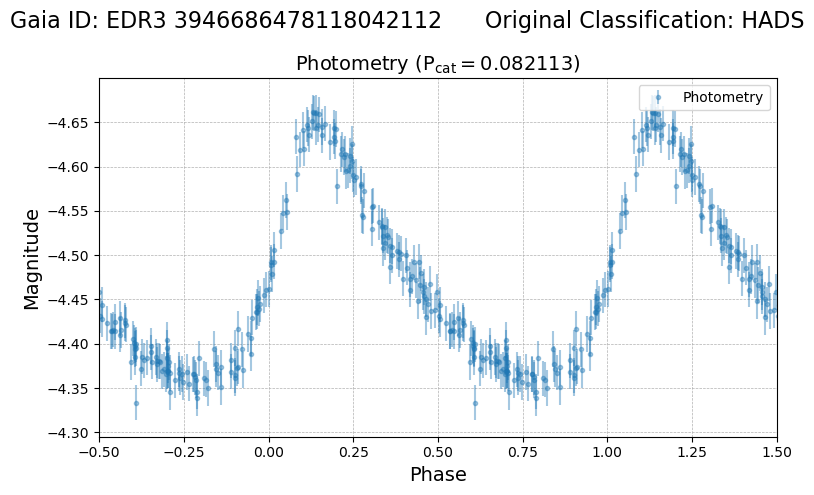

spec-56649-HD121513N165426V_sp04-024.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



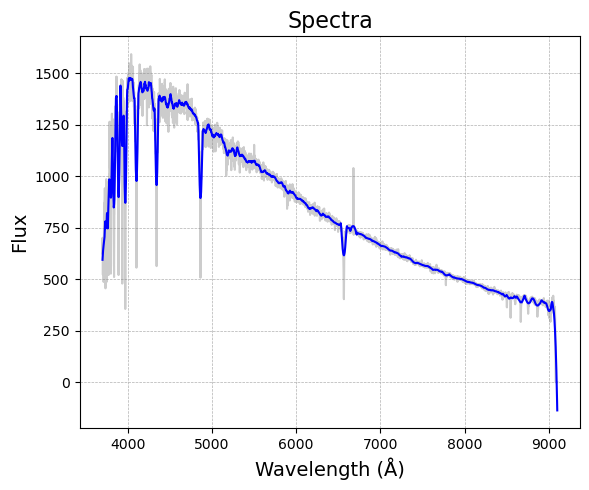

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
489485  ecd82998-7781-56f4-afc4-5b49860f52c2     79169   

                        asassn_name      other_names    raj2000   dej2000  \
489485  ASASSN-VJ164334.98+314959.2  LINEAR 19119847  250.89576  31.83312   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
489485  2.457623e+06  1.312508e+18  J164334.98+314958.4     8117920.0   

                  edr3_source_id                galex_id         tic_id  
489485  EDR3 1312507581496605184  GALEX J164335.0+314957  TIC 224324197   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
489485       0.46  0.080278            0.29       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
489485      15.51        15.487734           0.005466         15.625398   

        e_phot_bp_mean_mag  phot_rp_mean_mag

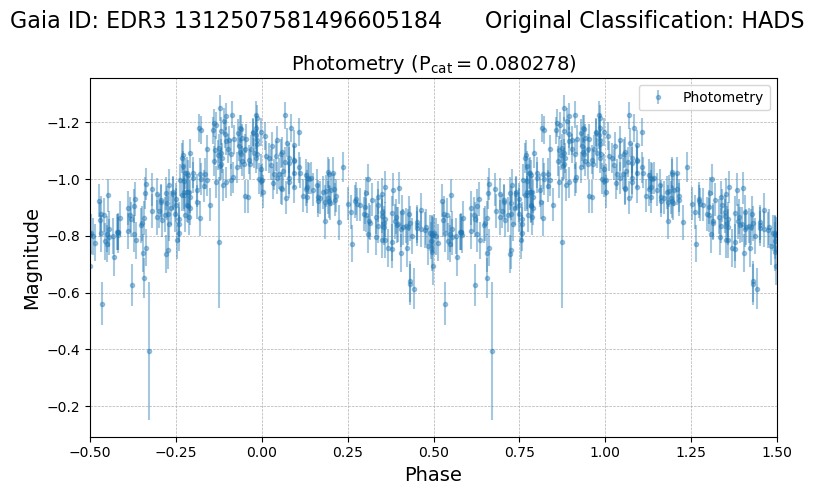

spec-57165-HD164134N305232M01_sp09-104.fits.gz


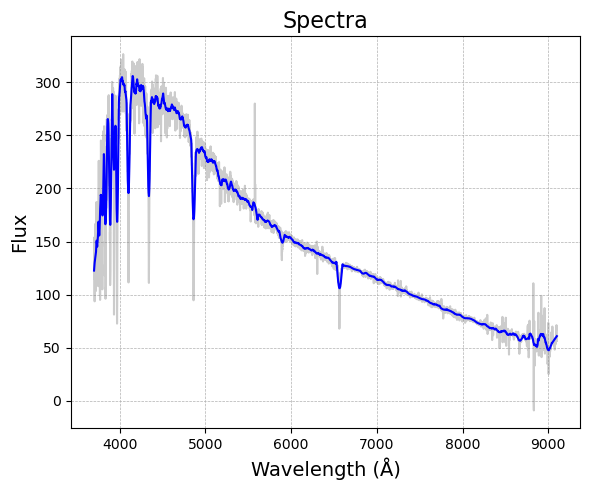

spec-58545-HD164351N340219B01_sp01-009.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



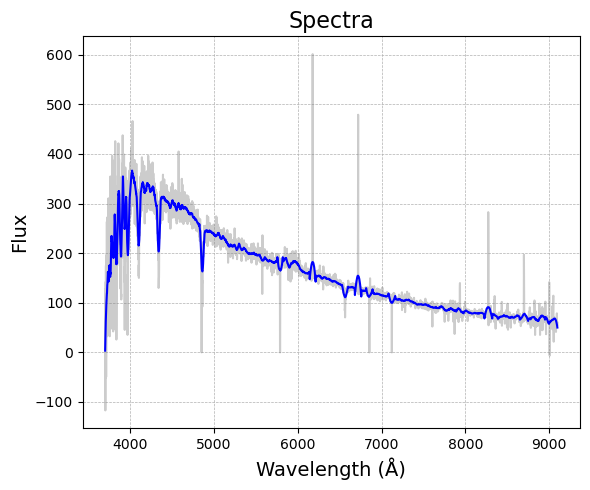

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
204555  a54d6f15-63a1-50e4-abd1-44c17a1073b6     65717   

                        asassn_name     other_names    raj2000  dej2000  \
204555  ASASSN-VJ124945.33+040139.2  LINEAR 7834923  192.43888  4.02755   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
204555  2.457512e+06  3.705410e+18  J124945.34+040138.0    26885667.0   

                  edr3_source_id                galex_id         tic_id  
204555  EDR3 3705409818317959296  GALEX J124945.3+040138  TIC 380698796   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
204555       0.34  0.048353            0.48       0.72 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
204555      14.75        14.725627           0.004463         14.852509   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_

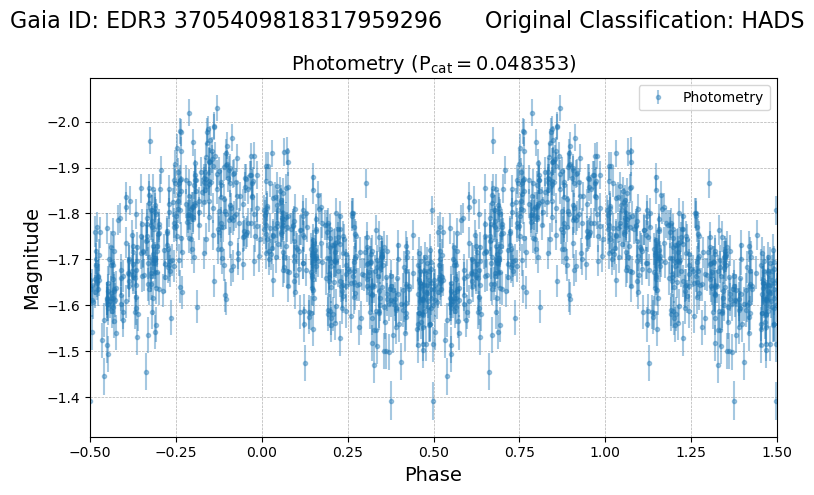

spec-56684-HD125136N030324B01_sp15-022.fits.gz


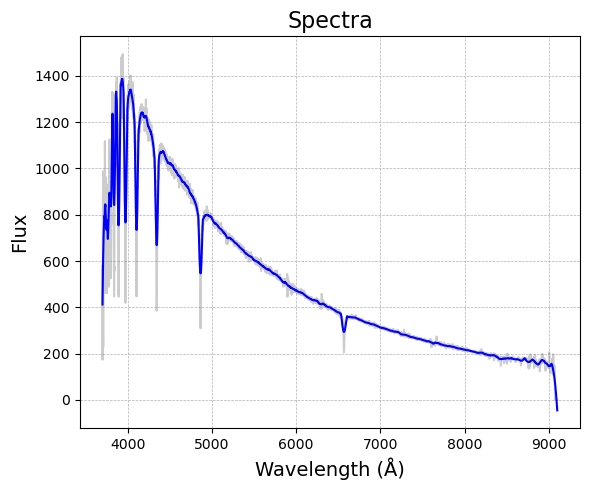

spec-58257-HD125136N030324B02_sp15-022.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



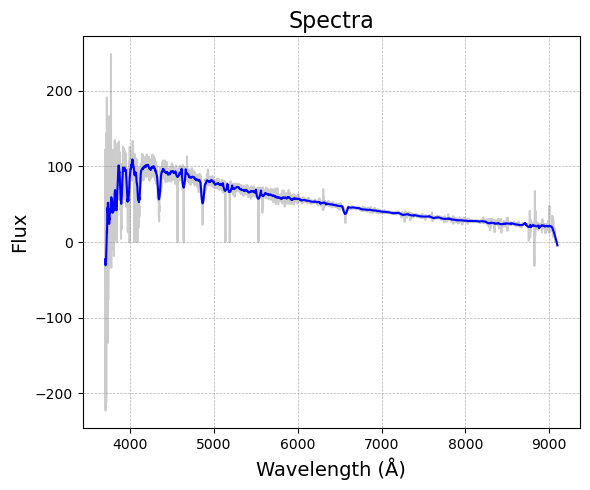

In [93]:
for name in eb_out_spec_names:
    plot_photometry_flux(name)

# Photo plots

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
682721  ece1189a-4b3f-573b-b34d-b08c616ae6de  AP56986807   

                        asassn_name           other_names    raj2000  \
682721  ASASSN-VJ144034.16-130356.6  WISEJ144034.1-130356  220.14232   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
682721 -13.06572  2.457824e+06  6.323304e+18  J144034.16-130356.4   

        apass_dr9_id            edr3_source_id                galex_id  \
682721    56986807.0  EDR3 6323304290601880832  GALEX J144034.1-130356   

               tic_id  
682721  TIC 466492005   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
682721       0.41  0.179261            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
682721       11.3        11.261293           0.015954         11.520041   

        e

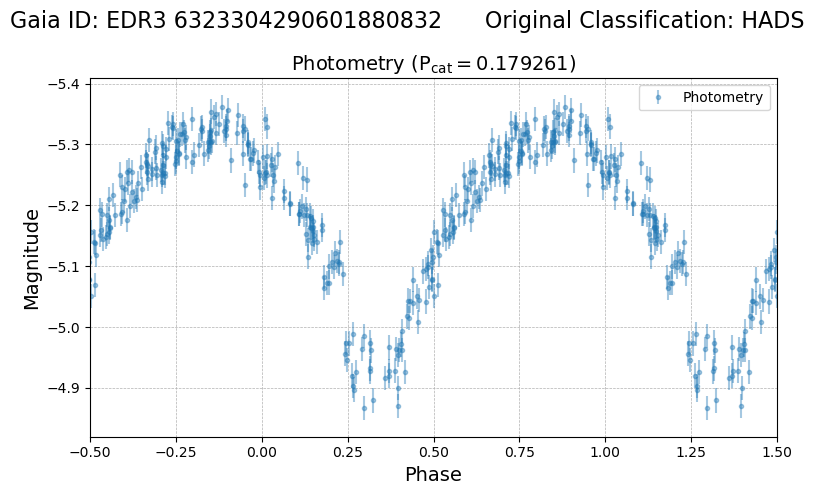

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
161940  7ffd2e96-57a0-54c6-9c0c-ab5444986ecc    174352   

                        asassn_name          other_names   raj2000  dej2000  \
161940  ASASSN-VJ183056.06+020115.5  ASAS J183056+0201.3  277.7336  2.02098   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
161940  2.457623e+06  4.276880e+18  J183056.26+020116.0    32061639.0   

                  edr3_source_id galex_id         tic_id  
161940  EDR3 4276879784281053440      NaN  TIC 370362532   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
161940       0.26  0.199163            0.33       0.84 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
161940      11.02        10.589232           0.005968         11.230746   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     b

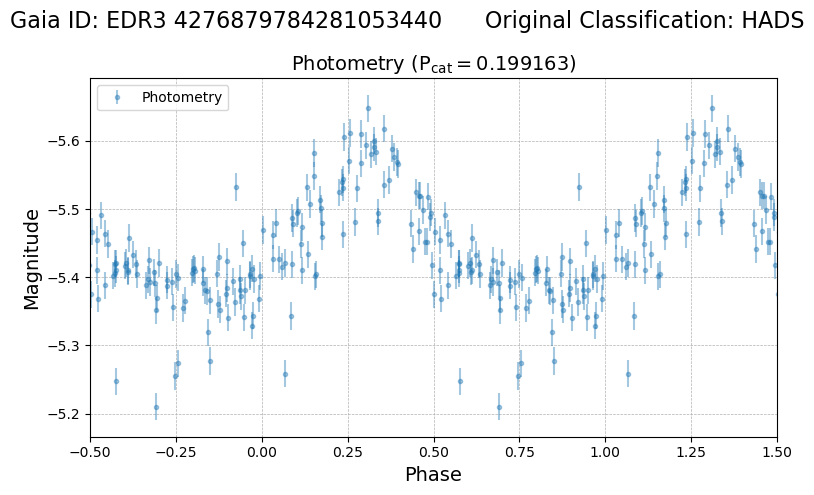

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
157183  f18b6b6f-ffd0-5d38-98e7-e7cc6df4a47e     98728   

                        asassn_name other_names    raj2000   dej2000  \
157183  ASASSN-VJ144138.19+562616.5   V0467 Dra  220.40913  56.43792   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
157183  2.457982e+06  1.607720e+18  J144138.24+562616.9     8870355.0   

                  edr3_source_id                galex_id         tic_id  
157183  EDR3 1607719615965934848  GALEX J144138.0+562617  TIC 158498107   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
157183       0.35  0.197699            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
157183      11.19        11.192205           0.005979         11.271939   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

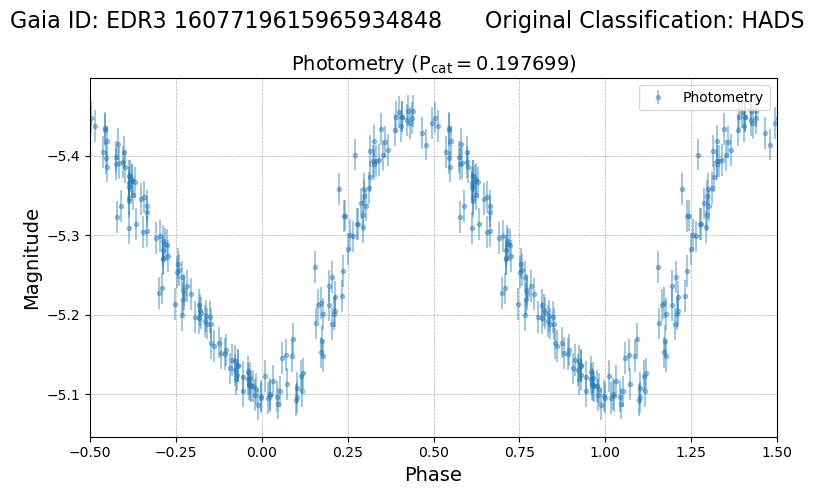

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id source_id  \
7413  26172888-08f7-5102-abc9-3fe9591ba9ac    206891   

                      asassn_name          other_names    raj2000   dej2000  \
7413  ASASSN-VJ235951.17-334332.3  ASAS J235951-3343.5  359.96322 -33.72565   

         epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
7413  2.458004e+06  2.313052e+18  J235951.24-334332.6    16254884.0   

                edr3_source_id                galex_id         tic_id  
7413  EDR3 2313051961496899840  GALEX J235951.2-334332  TIC 183532876   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude    period  lksl_statistic  rfr_score
7413       0.58  0.167165            0.03       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
7413      11.47        11.501244           0.007942         11.632316   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

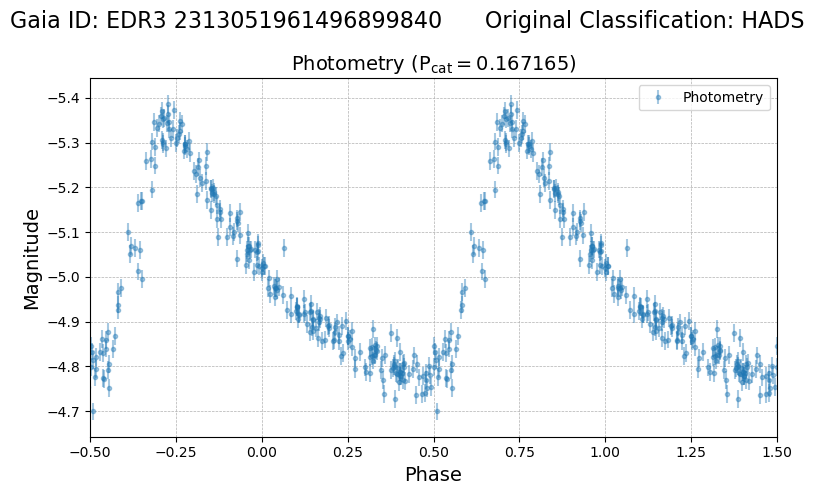

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
167056  11a855cb-e2fe-5ec9-b7ed-46d40dc70884     94233   

                        asassn_name      other_names    raj2000   dej2000  \
167056  ASASSN-VJ202601.80+593053.2  GSC 03949-00811  306.50751  59.51479   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
167056  2.457560e+06  2.188662e+18  J202601.74+593053.4    15413973.0   

                  edr3_source_id                galex_id         tic_id  
167056  EDR3 2188661737149858816  GALEX J202601.7+593053  TIC 352619386   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
167056       0.29  0.169751            0.78        0.6 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
167056      11.04        10.868701           0.005416         11.208861   

        e_phot_bp_mean_mag  phot_rp_mean_mag

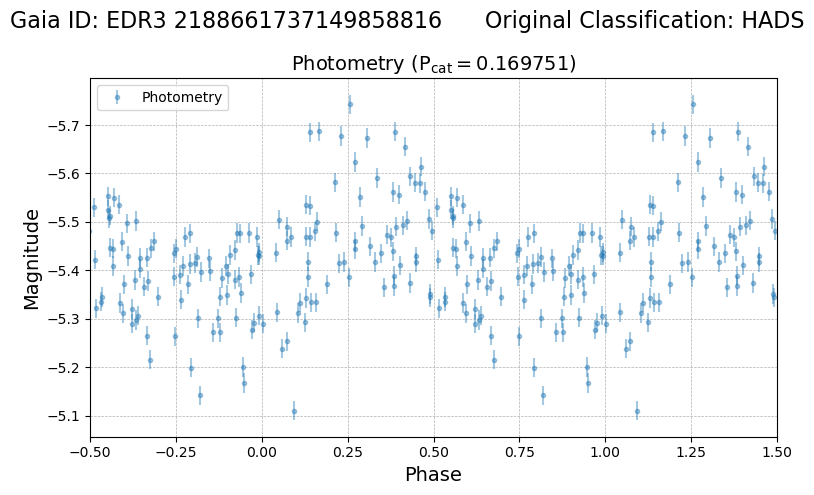

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
553727  f5ac06cc-6cf5-5530-a02a-917635bb7c3a  AP16031950   

                        asassn_name              other_names    raj2000  \
553727  ASASSN-VJ190626.32+682901.4  Gaia2262006859301460224  286.60968   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
553727  68.48373  2.456877e+06  2.262007e+18  J190626.34+682901.3   

        apass_dr9_id            edr3_source_id                galex_id  \
553727    16031950.0  EDR3 2262006859301460224  GALEX J190626.4+682902   

               tic_id  
553727  TIC 258799679   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
553727       0.29  0.118153            0.16       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
553727      10.82        10.836504           0.005246         10.992567   

   

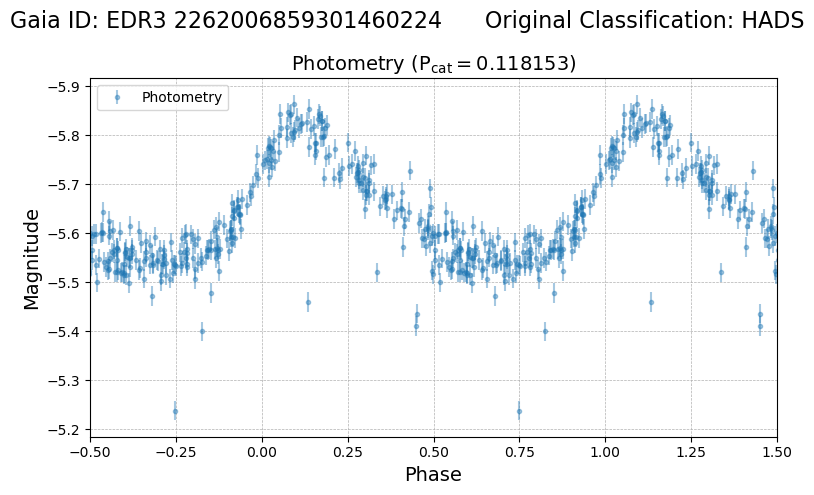

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
521016  be826c83-78bc-57fb-93d5-6bc093bf3b8c  AP4274979   

                        asassn_name other_names   raj2000  dej2000  \
521016  ASASSN-VJ015811.74+554218.7    SERIV101  29.54892  55.7052   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
521016  2.457012e+06  5.045390e+17  J015811.74+554218.6     4274979.0   

                 edr3_source_id galex_id         tic_id  
521016  EDR3 504538986607124992      NaN  TIC 445485453   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
521016       0.29  0.196117            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
521016      11.44         11.31365           0.004144          11.59694   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
521016    

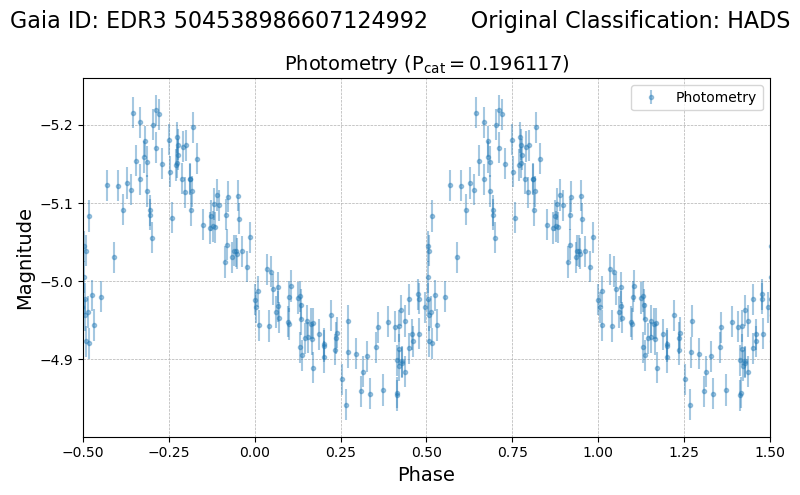

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
76617  bd46fe1c-0062-5380-833b-7023bdb1f977     66908   

                       asassn_name other_names    raj2000   dej2000  \
76617  ASASSN-VJ193445.58+455416.5   V2367 Cyg  293.68993  45.90457   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
76617  2.458005e+06  2.128059e+18  J193445.58+455416.2    14675599.0   

                 edr3_source_id galex_id         tic_id  
76617  EDR3 2128058614734364032      NaN  TIC 270617514   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
76617       0.42  0.176645            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
76617      11.47        11.408564           0.007639         11.578618   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
76617            0.

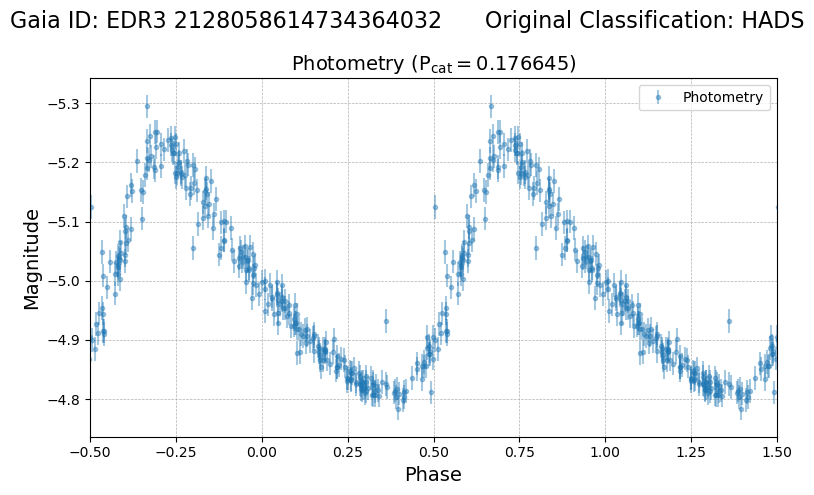

spec-56914-KP193637N444141V01_sp15-202.fits.gz


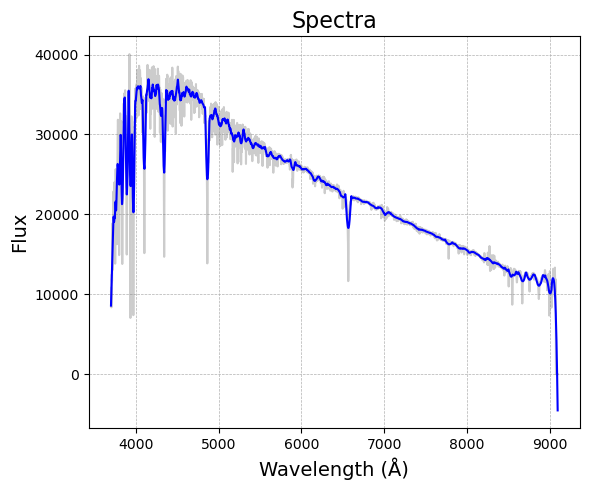

spec-57287-KP193637N444141V05_sp15-209.fits.gz


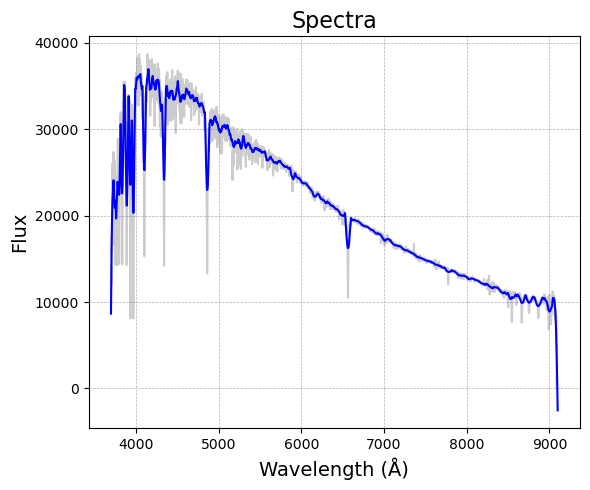

spec-57919-KP192314N471144V05_sp07-145.fits.gz


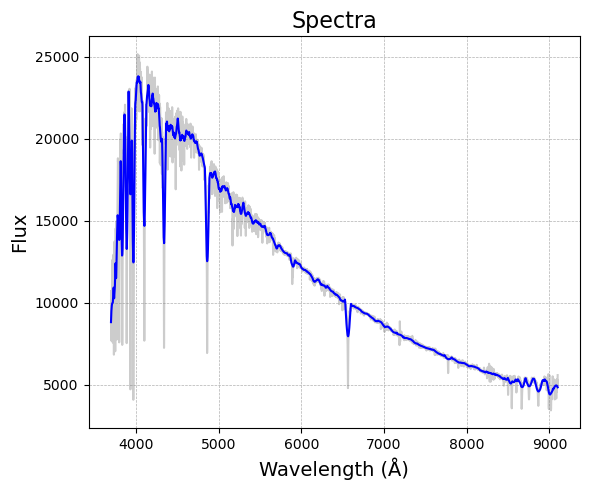

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
133816  76fc38bd-ab86-5797-bb23-6891309ce292     93113   

                        asassn_name   other_names   raj2000  dej2000  \
133816  ASASSN-VJ223448.07+380217.2  NSVS 6109324  338.7003  38.0381   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
133816  2.457297e+06  1.907925e+18  J223448.04+380216.2    11451497.0   

                  edr3_source_id galex_id         tic_id  
133816  EDR3 1907924704538612608      NaN  TIC 128386561   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
133816        0.2  0.130135            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
133816      11.05        10.989935           0.003569         11.200115   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
133816

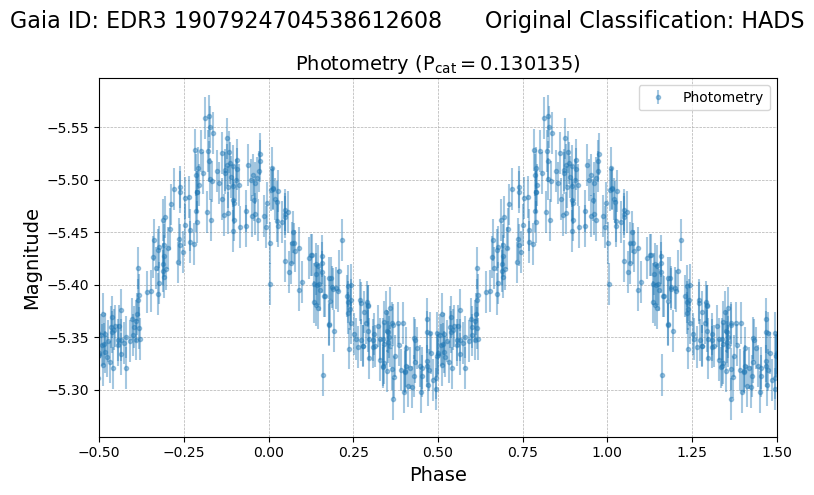

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
643781  ec443315-0c03-5988-9a3b-4798122f0de3    180683   

                        asassn_name          other_names   raj2000   dej2000  \
643781  ASASSN-VJ042749.56-184617.7  ASAS J042750-1846.3  66.95651 -18.77157   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
643781  2.457407e+06  3.170630e+18  J042749.58-184618.4    22929297.0   

                  edr3_source_id                galex_id         tic_id  
643781  EDR3 3170629936916306944  GALEX J042749.5-184618  TIC 139726509   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
643781       0.27  0.113415            0.29       0.85 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
643781       11.0        11.023391           0.004044         11.176858   

        e_phot_bp_mean_mag  phot_rp_me

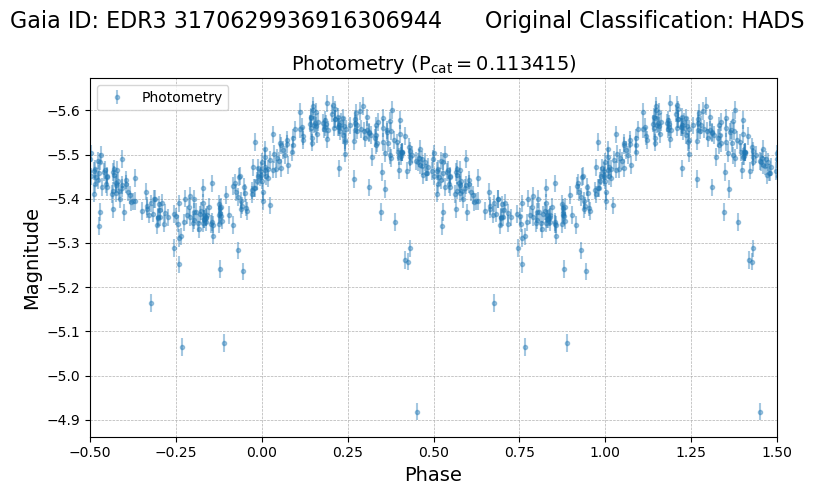

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
535092  295bee83-495e-5bef-883c-54ae76f9f0db  AP8701937   

                        asassn_name other_names    raj2000   dej2000  \
535092  ASASSN-VJ123811.30+384042.3         NaN  189.54707  38.67841   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
535092  2.456795e+06  1.521422e+18  J123811.29+384042.3     8701937.0   

                  edr3_source_id                galex_id         tic_id  
535092  EDR3 1521421933302910848  GALEX J123811.0+384041  TIC 155251800   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
535092       0.18  0.105843            0.65       0.66 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
535092      10.15        10.060274            0.00332         10.214983   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

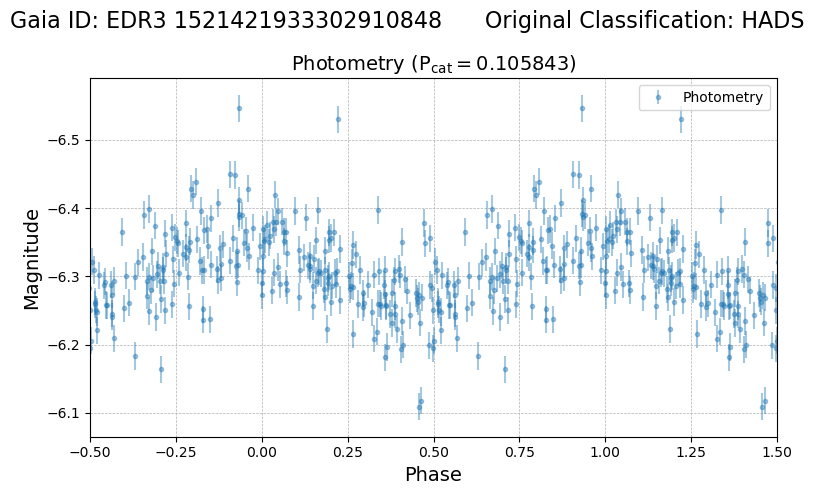

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
471800  a650782d-6da9-5720-acb4-a71215084dc3  AP45870399   

                        asassn_name other_names    raj2000   dej2000  \
471800  ASASSN-VJ101840.38-214449.7         NaN  154.66825 -21.74714   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
471800  2.457530e+06  5.667789e+18  J101840.37-214449.6    45870399.0   

                  edr3_source_id                galex_id         tic_id  
471800  EDR3 5667788656556956032  GALEX J101840.4-214449  TIC 192546211   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
471800       0.29  0.116994            0.52       0.75 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
471800      10.54        10.535368           0.004784         10.701259   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

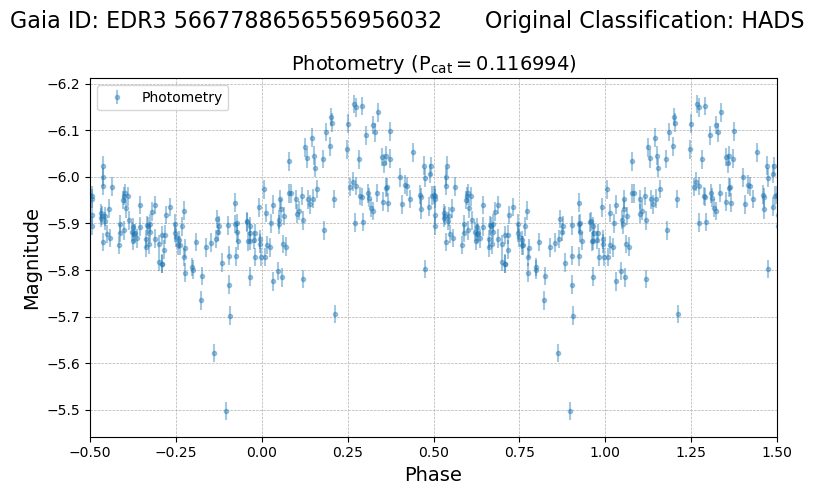

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
187593  42f123f7-dccd-51b2-9024-54a16ea6d201     81053   

                        asassn_name other_names    raj2000  dej2000  \
187593  ASASSN-VJ193955.88+523510.0   V2684 Cyg  294.98285  52.5861   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
187593  2.457622e+06  2.136574e+18  J193955.91+523509.8    14770319.0   

                  edr3_source_id galex_id        tic_id  
187593  EDR3 2136573645093441920      NaN  TIC 27315670   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
187593       0.41  0.109268            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
187593      11.28         11.32441           0.007161         11.468775   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
187593    

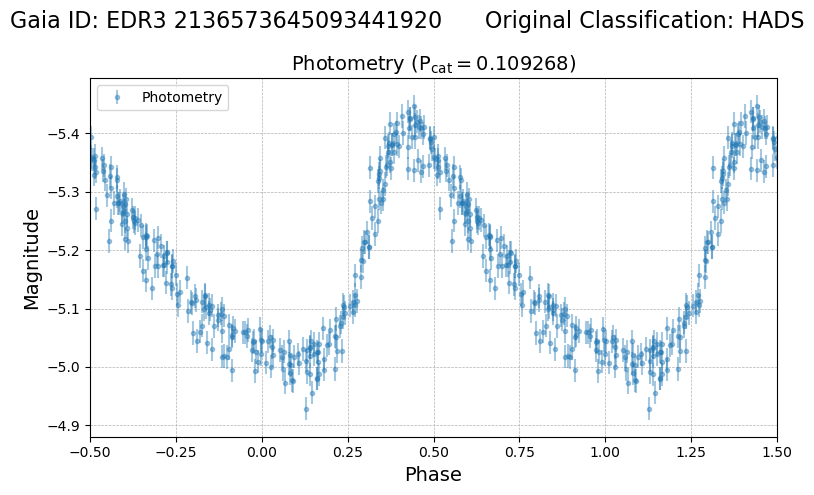

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
286498  e1df89bd-e09a-50e6-826f-7c5ff039fd75     65958   

                        asassn_name other_names   raj2000   dej2000  \
286498  ASASSN-VJ152221.48+325844.5   V0377 Boo  230.5895  32.97904   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
286498  2457452.978  1.278465e+18  J152221.52+325845.1     8017319.0   

                  edr3_source_id galex_id        tic_id  
286498  EDR3 1278464502477345408      NaN  TIC 16283570   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
286498        0.4  0.09071             0.1       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
286498      11.86         11.89081           0.005922         12.029653   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
286498        

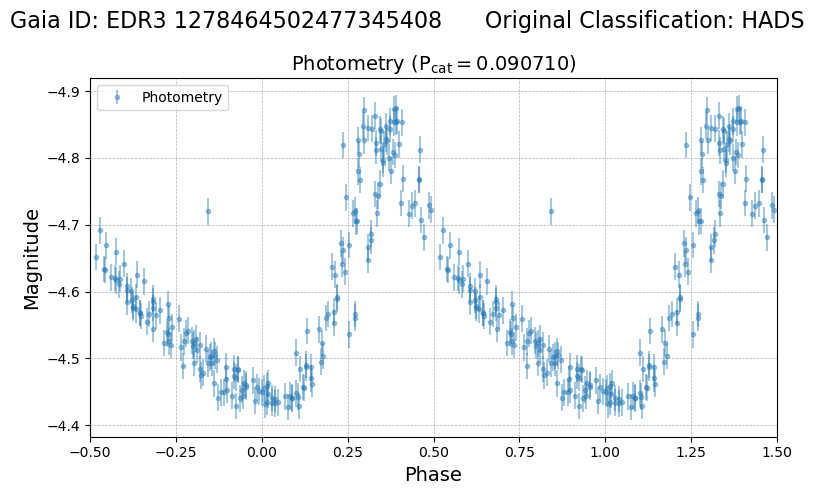

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
520360  668786ae-1a8a-5db0-87cb-671746d6abc3  AP751458   

                        asassn_name             other_names  raj2000  \
520360  ASASSN-VJ044358.80+372413.7  ATLASJ070.9950+37.4038   70.995   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
520360  37.40381  2.457009e+06  1.753306e+17  J044358.80+372413.8   

        apass_dr9_id           edr3_source_id                galex_id  \
520360      751458.0  EDR3 175330636724481536  GALEX J044358.7+372413   

               tic_id  
520360  TIC 156364528   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
520360        0.3  0.094387            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
520360      11.83        11.515285           0.005396         12.053445   

        e_phot_

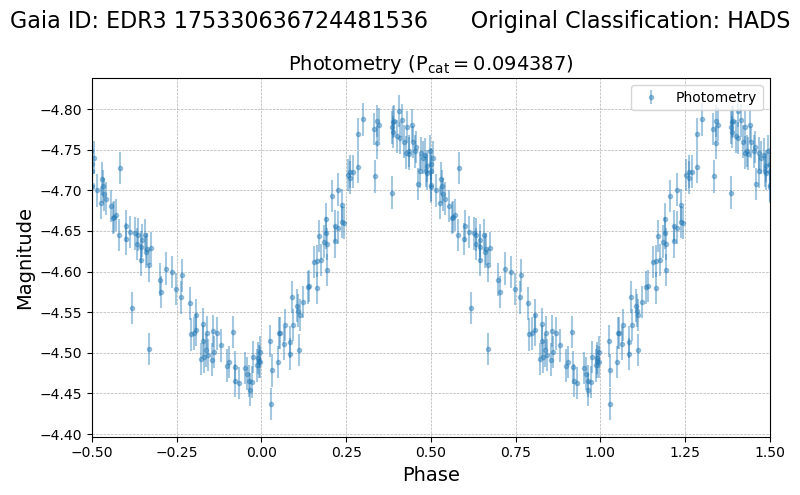

spec-56326-GAC069N36V2_sp13-228.fits.gz


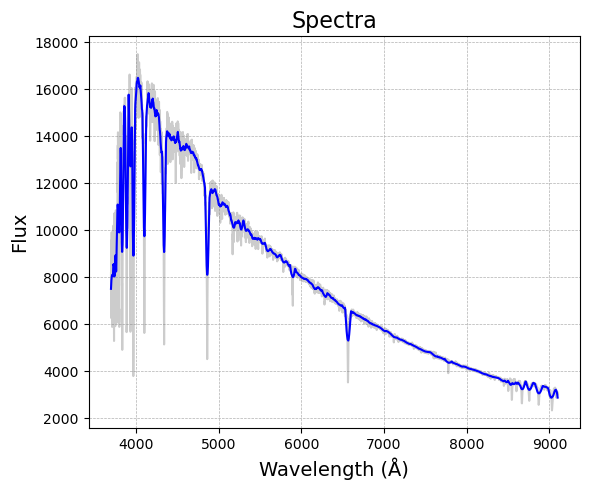

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
158570  62cea882-5a9b-546f-9865-741a0da23bec    252233   

                        asassn_name other_names    raj2000   dej2000  \
158570  ASASSN-VJ203536.60+524544.7   V2551 Cyg  308.90252  52.76242   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
158570  2.457312e+06  2.181627e+18  J203536.52+524545.1    15333851.0   

                  edr3_source_id galex_id         tic_id  
158570  EDR3 2181626610781982848      NaN  TIC 303755676   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
158570       0.29  0.121159            0.26       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
158570      10.57        10.504976           0.005243         10.725637   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
158570

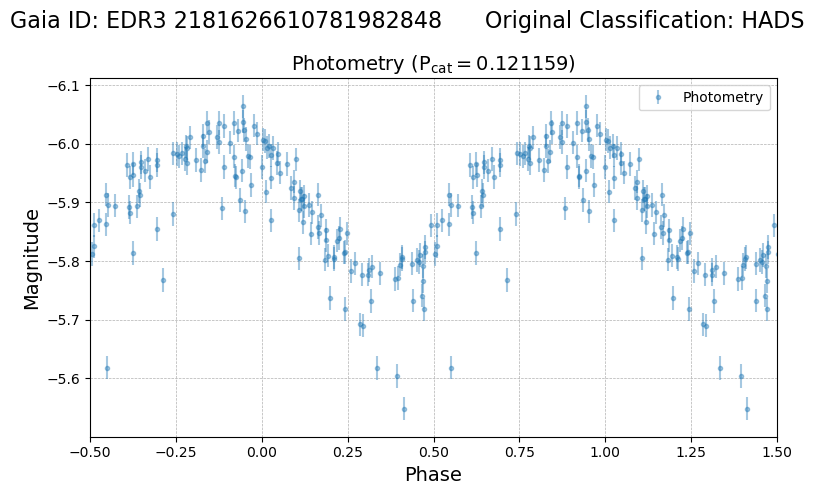

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287315  d698bc87-db16-5920-91f4-108f4e6a9da5    119673   

                        asassn_name          other_names   raj2000  dej2000  \
287315  ASASSN-VJ010618.39+084613.1  ASAS J010618+0846.2  16.57664   8.7703   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287315  2.458138e+06  2.578241e+18  J010618.35+084613.2    16919990.0   

                  edr3_source_id                galex_id         tic_id  
287315  EDR3 2578241178135420800  GALEX J010618.3+084614  TIC 257800712   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
287315        0.3  0.062783            0.17       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287315      11.36        11.330401           0.005403         11.487057   

        e_phot_bp_mean_mag  phot_rp_mean

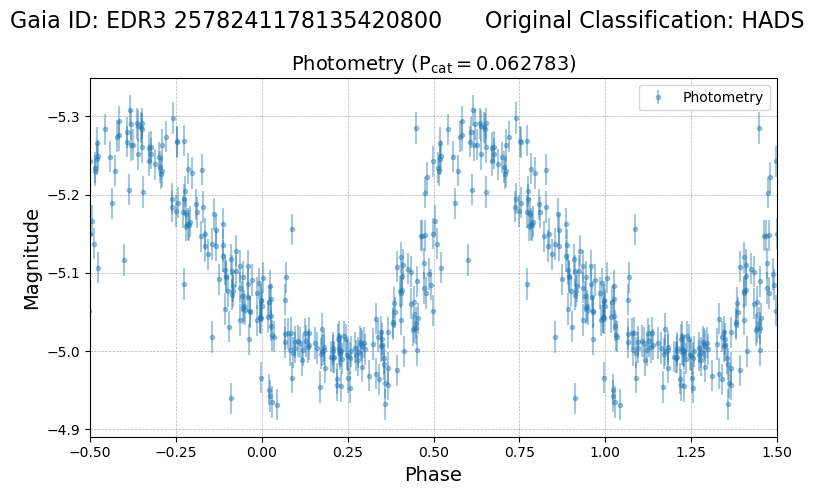

spec-57739-KP011341N085828V01_sp10-237.fits.gz


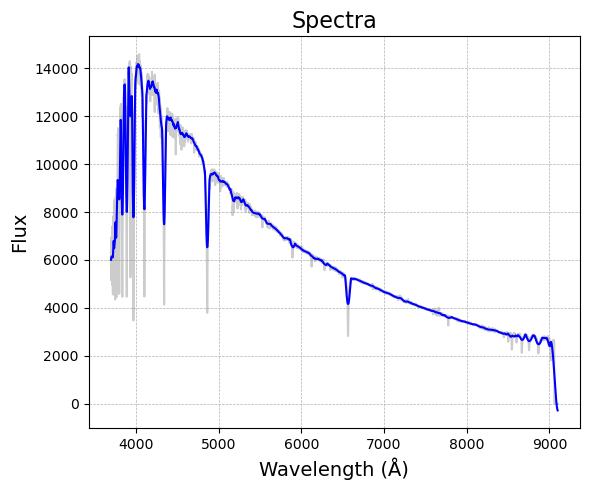

spec-58837-KII011341N085828V01_sp10-014.fits.gz


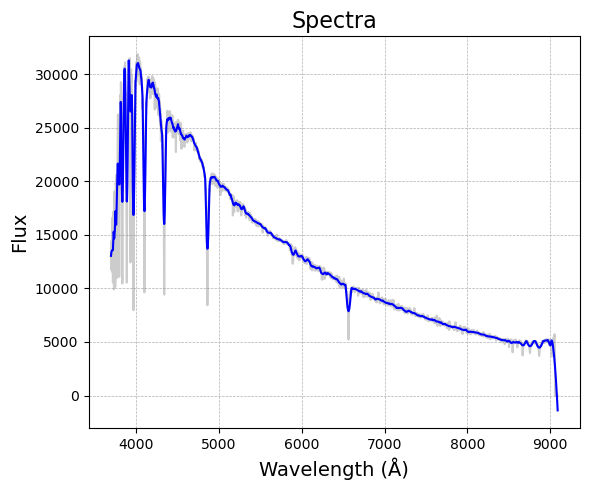

spec-59193-KII010347N064553V01_sp12-073.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



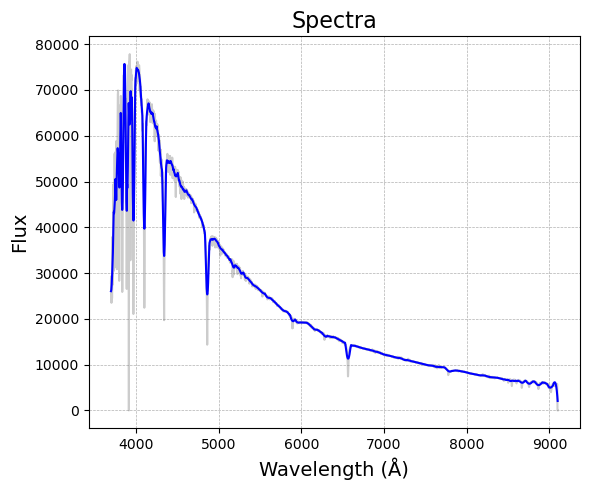

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
236590  21fa4931-8ce3-50fa-b5fb-3bf24a465e7e    109373   

                        asassn_name other_names    raj2000   dej2000  \
236590  ASASSN-VJ121340.78+171438.2      PT Com  183.41992  17.24394   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
236590  2.456795e+06  3.946686e+18  J121340.76+171437.8    27615783.0   

                  edr3_source_id                galex_id         tic_id  
236590  EDR3 3946686478118042112  GALEX J121340.8+171438  TIC 335826251   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
236590       0.29  0.082113            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
236590      11.99        12.000633           0.005863          12.14213   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

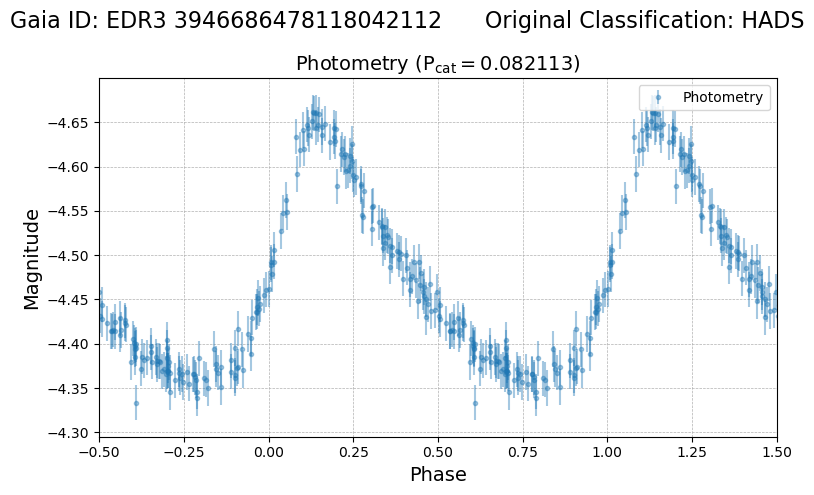

spec-56649-HD121513N165426V_sp04-024.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



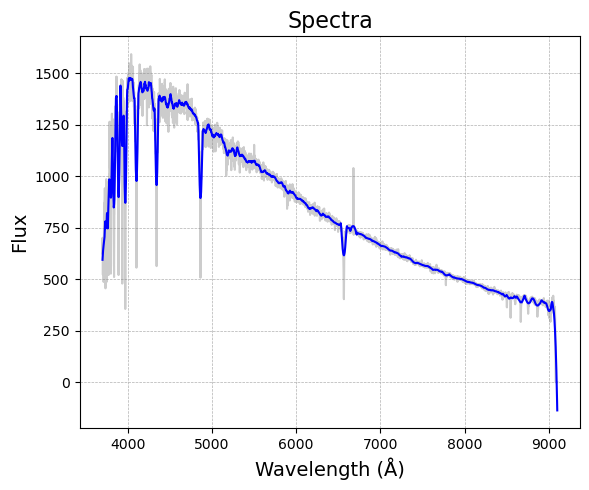

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
651038  8f7f6e35-78e9-555c-88c3-81aceb0283af  AP15207733   

                        asassn_name             other_names   raj2000  \
651038  ASASSN-VJ213759.35+532817.4  ATLASJ324.4971+53.4715  324.4973   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
651038  53.47151  2.457705e+06  2.174166e+18  J213759.32+532817.6   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
651038    15207733.0  EDR3 2174166222539831040      NaN  TIC 278338750   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
651038       0.15  0.181095            0.32       0.85 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
651038      11.59        11.435417           0.003178         11.786554   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

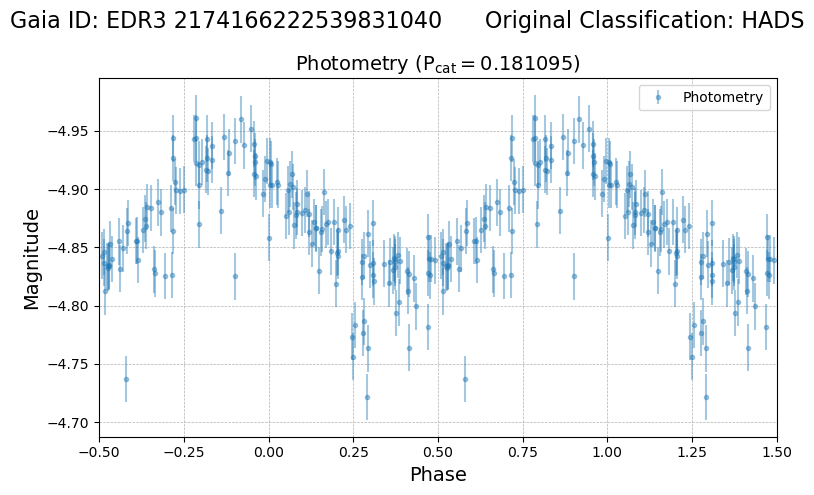

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
155931  7763fac0-4be5-56fa-a37d-e52a16905b09    407976   

                        asassn_name          other_names    raj2000   dej2000  \
155931  ASASSN-VJ065356.79-145244.5  ASAS J065357-1452.8  103.48664 -14.87903   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
155931  2.457660e+06  2.948883e+18  J065356.73-145245.8    19097336.0   

                  edr3_source_id galex_id         tic_id  
155931  EDR3 2948882562135152000      NaN  TIC 142665215   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
155931       0.17  0.162694            0.39        0.8 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
155931      11.03        10.908154           0.003555         11.124903   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

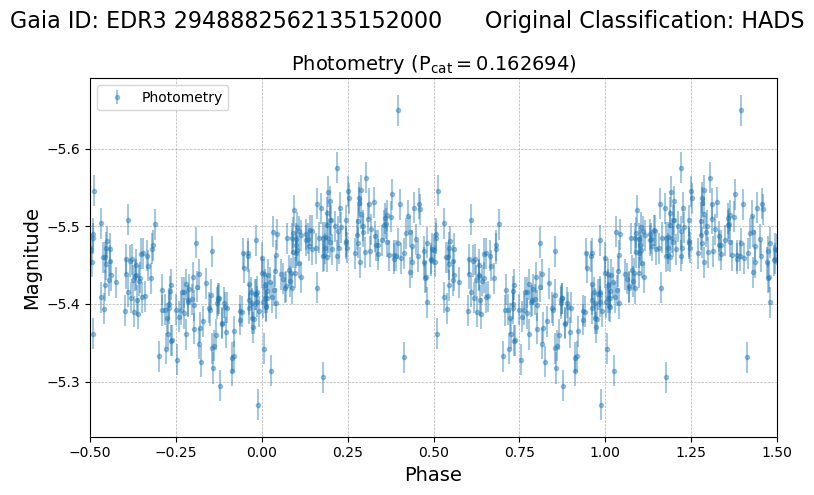

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
145140  f8301a3c-3edc-5e4d-8037-50e9b4a4c634    434149   

                        asassn_name          other_names    raj2000   dej2000  \
145140  ASASSN-VJ181227.55-213839.6  ASAS J181227-2138.7  273.11481 -21.64432   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
145140  2.457456e+06  4.093808e+18  J181227.44-213840.4    28725138.0   

                  edr3_source_id galex_id         tic_id  
145140  EDR3 4093808418220290944      NaN  TIC 116473042   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
145140       0.29  0.199071            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
145140      11.49        11.360043           0.007027         11.666679   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

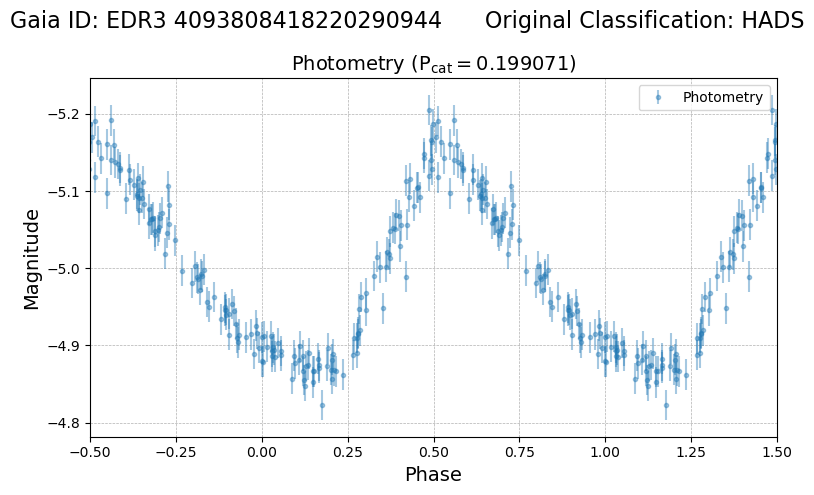

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
458509  a9c3f87b-e4be-5b72-8486-3a1bb2764f0d    171802   

                        asassn_name other_names    raj2000  dej2000  \
458509  ASASSN-VJ175827.10+010605.9   V0567 Oph  269.61291  1.10165   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
458509  2.458316e+06  4.467895e+18  J175827.20+010605.2    34353628.0   

                  edr3_source_id galex_id         tic_id  
458509  EDR3 4467895224944673408      NaN  TIC 325763293   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
458509       0.33  0.149522            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
458509      11.22        11.094995           0.006362         11.428941   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
458509  

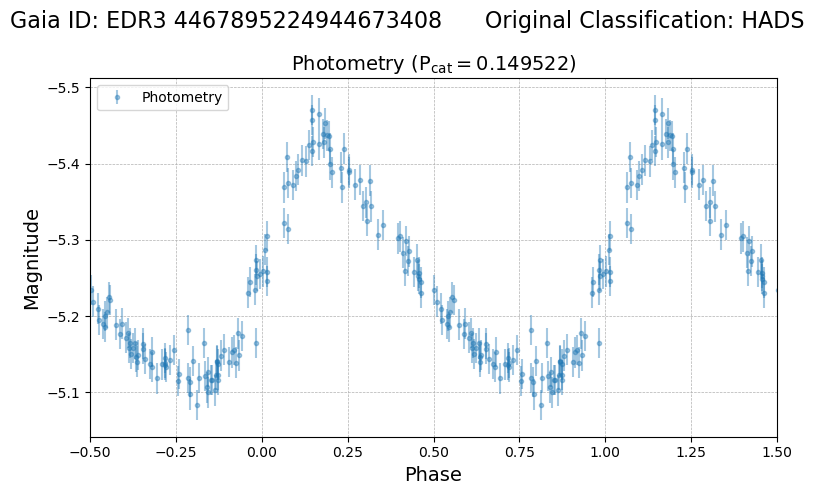

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
190998  203c475e-cc4d-5a18-8ea1-5c1535a24ab7    122488   

                        asassn_name other_names    raj2000  dej2000  \
190998  ASASSN-VJ155309.67+060526.3      CW Ser  238.29029  6.09065   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
190998  2.457551e+06  4.426867e+18  J155309.78+060526.0    34070781.0   

                  edr3_source_id                galex_id         tic_id  
190998  EDR3 4426867120349428864  GALEX J155309.7+060526  TIC 272777298   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
190998        0.4  0.189151            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
190998      11.88        11.841927           0.006556         12.011535   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

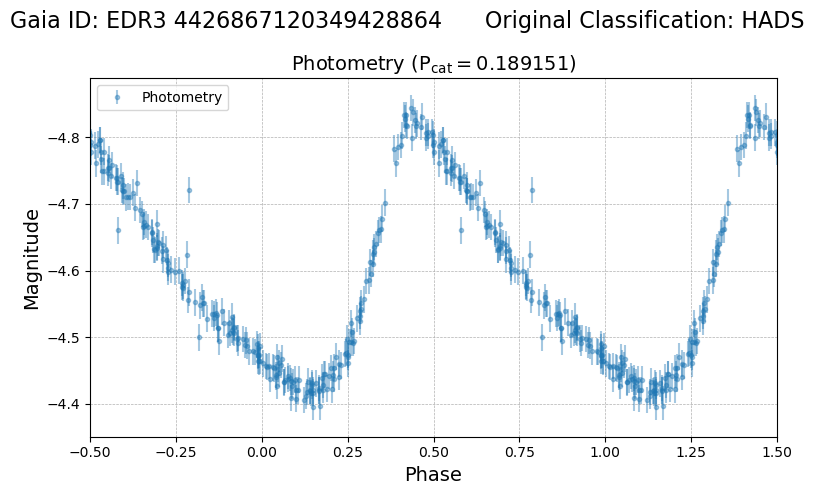

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
160323  5fbe70ba-f37f-573f-8337-05e655f93836    149468   

                        asassn_name          other_names  raj2000  dej2000  \
160323  ASASSN-VJ001234.95+041322.9  ASAS J001235+0413.3  3.14561  4.22302   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
160323  2.456903e+06  2.740925e+18  J001235.04+041321.5    17679964.0   

                  edr3_source_id                galex_id        tic_id  
160323  EDR3 2740924540624854144  GALEX J001235.0+041321  TIC 58720680   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
160323       0.15  0.096776            0.42       0.78 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
160323      10.84        10.787816           0.003236          10.94714   

        e_phot_bp_mean_mag  phot_rp_mean_mag

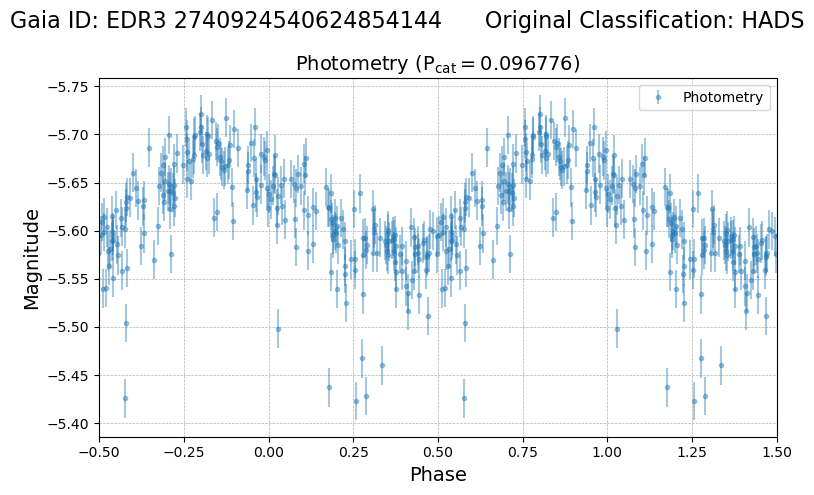

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
535893  0d5b4768-4d0a-5b0d-b173-698a2b6eea51  AP6783714   

                        asassn_name other_names    raj2000   dej2000  \
535893  ASASSN-VJ072439.99+451638.0         NaN  111.16661  45.27721   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
535893  2.456932e+06  9.737267e+17  J072439.98+451638.0     6783714.0   

                 edr3_source_id                galex_id         tic_id  
535893  EDR3 973726677221086080  GALEX J072440.0+451636  TIC 286872312   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
535893        0.2  0.10677            0.52       0.74 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
535893      10.79        10.782233           0.003959         10.993391   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

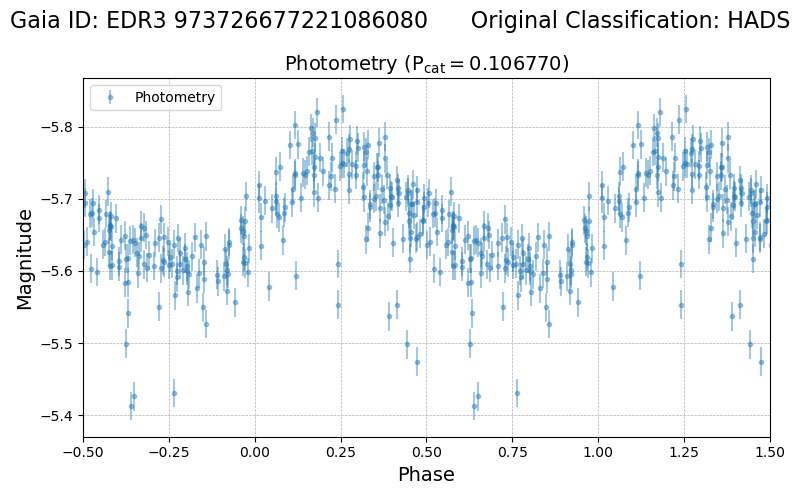

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
10195  25417d2e-5c87-5771-b90a-aa8fee3252a4    477091   

                       asassn_name other_names   raj2000   dej2000  \
10195  ASASSN-VJ020938.95+595504.2         NaN  32.41239  59.91784   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
10195  2.458022e+06  5.071429e+17  J020938.95+595503.8     4324548.0   

                edr3_source_id galex_id         tic_id  
10195  EDR3 507142905027850880      NaN  TIC 375088412   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
10195       0.76  0.147284            0.79       0.51 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
10195      13.38         13.05914           0.003984         13.660655   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
10195            0.0118

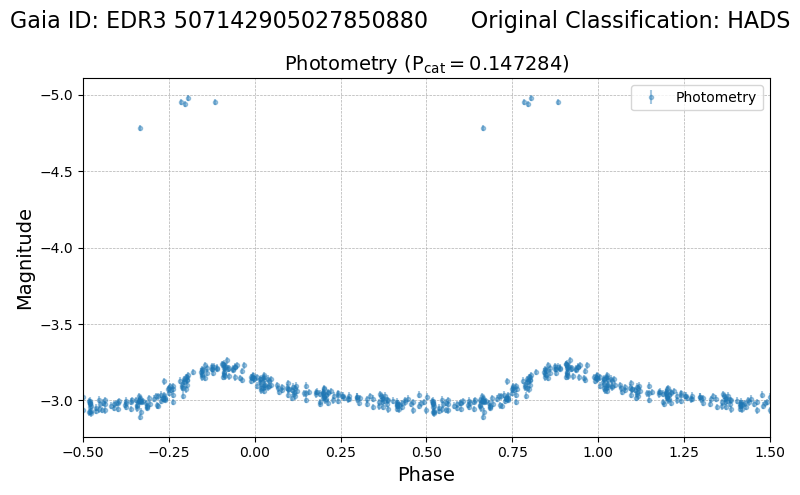

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
161438  84627c07-02a5-5381-9a78-c8d5359f8323    193443   

                        asassn_name          other_names    raj2000   dej2000  \
161438  ASASSN-VJ194817.40+261508.6  ASAS J194817+2615.1  297.07252  26.25239   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
161438  2.458177e+06  2.027007e+18  J194817.51+261508.8    13659504.0   

                  edr3_source_id galex_id         tic_id  
161438  EDR3 2027006727289958400      NaN  TIC 435563841   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
161438        0.2  0.132723            0.07       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
161438      11.24        11.050612           0.003656         11.477966   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

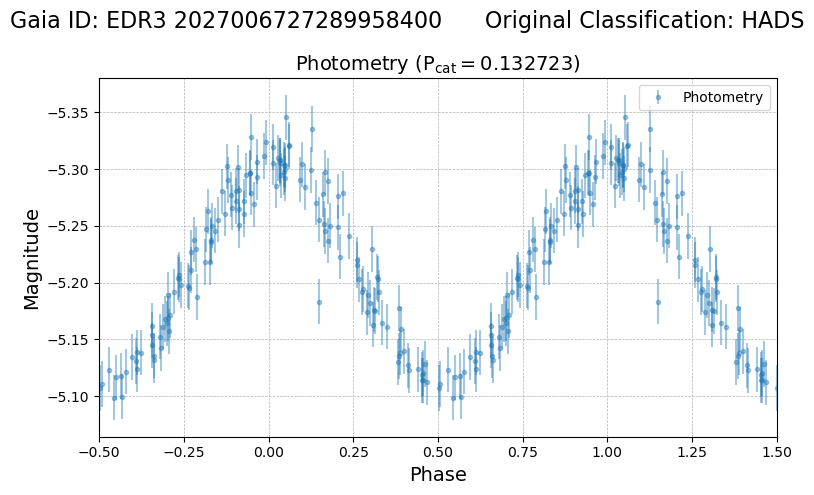

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
61563  0816079c-ff87-53d0-9155-54324f15de2f    454618   

                       asassn_name other_names    raj2000   dej2000  \
61563  ASASSN-VJ091116.89+351700.8         NaN  137.82058  35.28355   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
61563  2.457697e+06  7.143570e+17  J091116.87+351700.7     5642129.0   

                edr3_source_id                galex_id       tic_id  
61563  EDR3 714356969470796416  GALEX J091116.9+351700  TIC 8687436   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
61563       0.23  0.084657            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
61563      11.98        11.944363           0.004068         12.061764   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_r

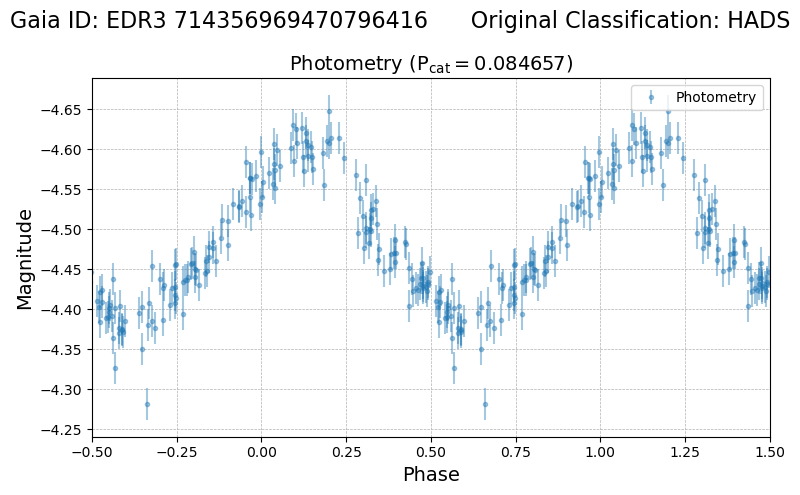

spec-56679-HD090143N355133V01_sp06-144.fits.gz


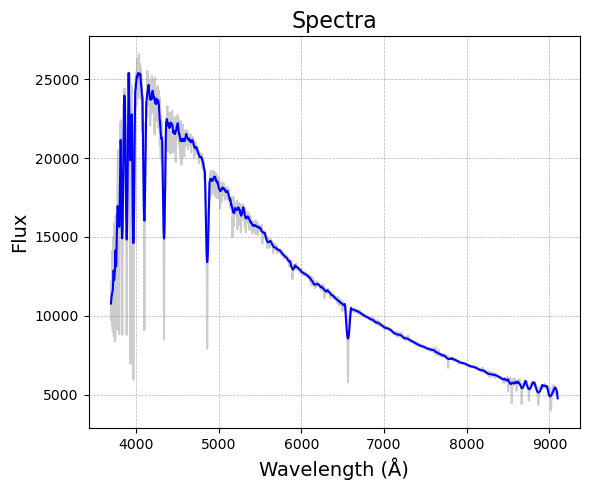

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
159017  de1b91f7-09b6-5ec8-b443-58090a1b2b7b    312999   

                        asassn_name          other_names    raj2000   dej2000  \
159017  ASASSN-VJ180441.03-285605.1  ASAS J180441-2856.2  271.17095 -28.93474   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
159017  2.457819e+06  4.050414e+18  J180441.12-285605.5           NaN   

                  edr3_source_id galex_id         tic_id  
159017  EDR3 4050413546188451072      NaN  TIC 407202681   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
159017       0.45  0.192915            0.11       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
159017      11.88         11.73622           0.009294         12.003496   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

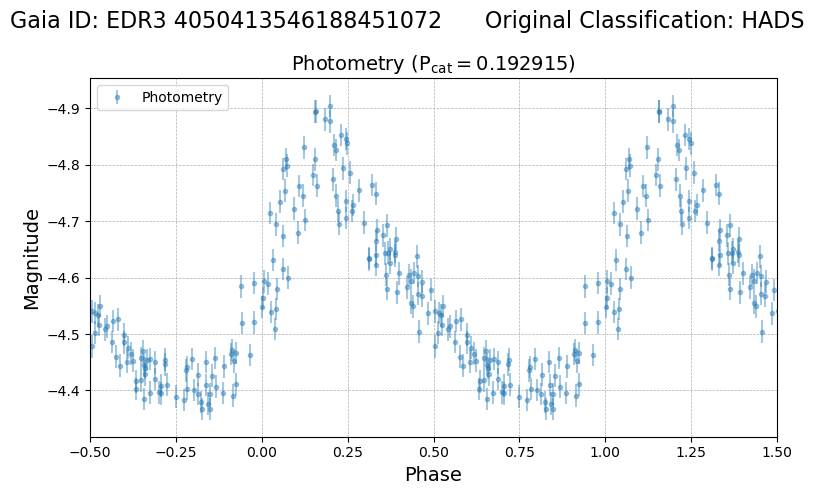

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
379908  36622f3d-baa4-5466-9feb-377cb06c7d3a  AP42872313   

                        asassn_name other_names    raj2000   dej2000  \
379908  ASASSN-VJ065829.95-574110.6         NaN  104.62479 -57.68628   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
379908  2.457874e+06  5.483907e+18  J065829.72-574110.1    42872313.0   

                  edr3_source_id galex_id         tic_id  
379908  EDR3 5483907465800542080      NaN  TIC 279361249   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
379908       0.31  0.12895            0.84       0.56 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
379908      12.01        13.413836           0.002761         13.804925   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
3799

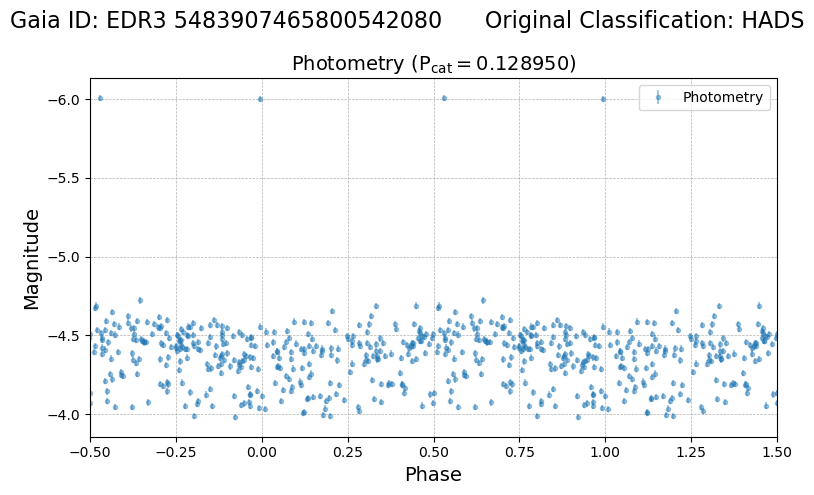

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
93334  71fc7911-a267-558e-aee4-f58a5264c580    130076   

                       asassn_name          other_names    raj2000   dej2000  \
93334  ASASSN-VJ071102.01+165131.9  ASAS J071102+1651.5  107.75839  16.85886   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
93334  2.457096e+06  3.360583e+18  J071102.08+165132.0    24516900.0   

                 edr3_source_id                galex_id        tic_id  
93334  EDR3 3360582974480810368  GALEX J071102.1+165132  TIC 26519147   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude   period  lksl_statistic  rfr_score
93334       0.19  0.14063            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
93334      11.88        11.692223           0.004651         12.082117   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_

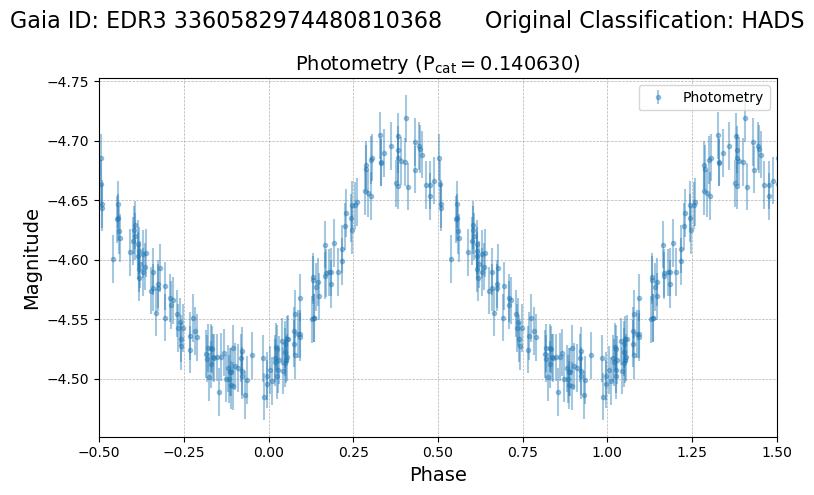

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
286172  15699dd0-0094-5590-a5a0-7a705440d1e3    110381   

                        asassn_name          other_names    raj2000   dej2000  \
286172  ASASSN-VJ084144.11+253030.2  ASAS J084144+2530.6  130.43378  25.50839   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
286172  2.457425e+06  6.907027e+17  J084144.17+253030.5     5561400.0   

                 edr3_source_id                galex_id         tic_id  
286172  EDR3 690702660426250880  GALEX J084144.1+253031  TIC 117254110   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
286172       0.41  0.159538            0.16       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
286172       12.1        12.075826           0.005519          12.25339   

        e_phot_bp_mean_mag  phot_rp_me

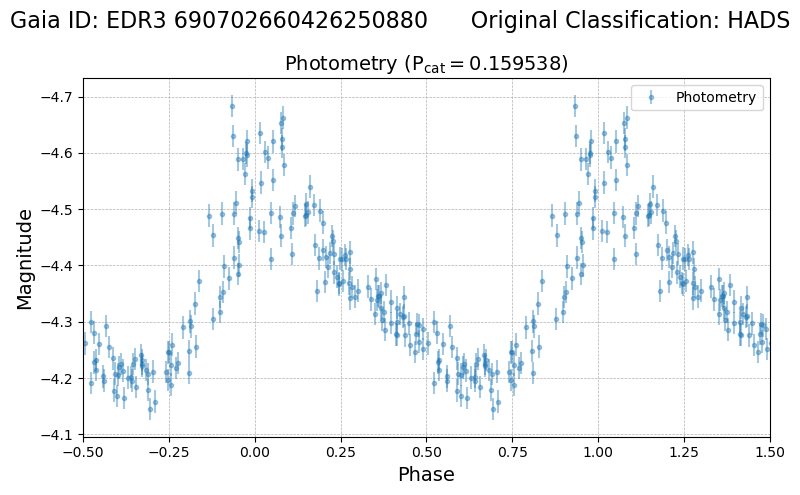

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
284319  9b93df85-acca-500c-98ec-5e98d65911c7    114855   

                        asassn_name other_names    raj2000   dej2000  \
284319  ASASSN-VJ213313.45+224424.3      BP Peg  323.30603  22.74007   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
284319  2.457961e+06  1.797023e+18  J213313.52+224424.2     9941138.0   

                  edr3_source_id                galex_id         tic_id  
284319  EDR3 1797022666064021376  GALEX J213313.4+224425  TIC 283561601   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
284319       0.43  0.109543            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
284319      11.99        11.946336           0.005848          12.10442   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

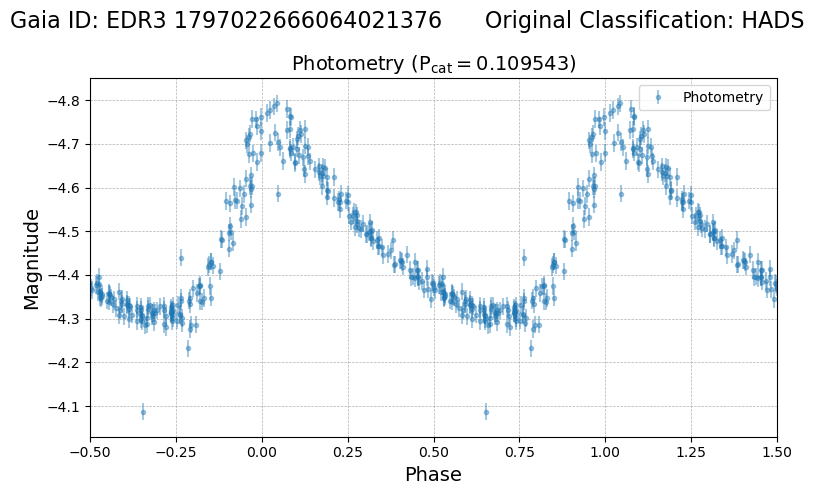

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
206333  b7c8bd42-7741-509f-89a2-fc0bf89b730c    149471   

                        asassn_name           other_names    raj2000  \
206333  ASASSN-VJ065122.72-272846.1  SSS_J065122.5-272845  102.84468   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
206333 -27.47947  2.457772e+06  2.919018e+18  J065122.68-272844.7   

        apass_dr9_id            edr3_source_id galex_id        tic_id  
206333    18591956.0  EDR3 2919018348854339968      NaN  TIC 53461036   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
206333       0.34  0.169933            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
206333       11.2        11.156275           0.005065         11.328479   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

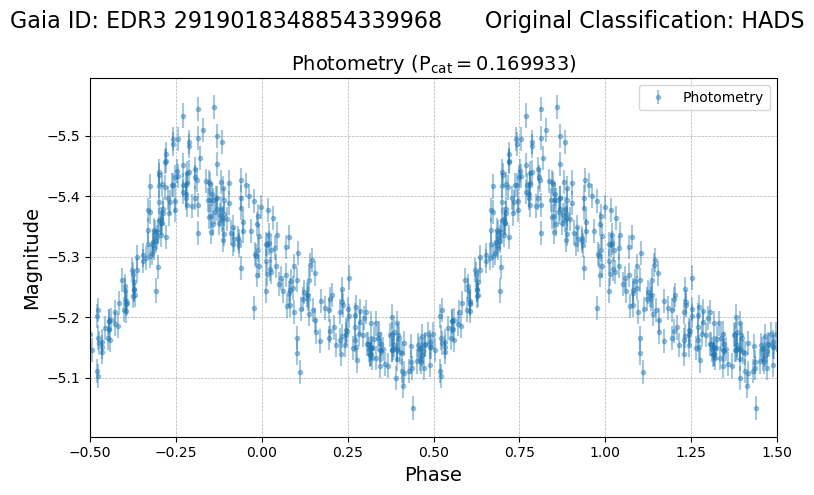

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
181419  31f9ffb4-3278-5bde-babd-b6937d53bb1f    202417   

                        asassn_name          other_names   raj2000   dej2000  \
181419  ASASSN-VJ050931.36+245119.3  ASAS J050931+2451.3  77.38065  24.85537   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
181419  2.458349e+06  3.419224e+18  J050931.37+245120.1    25299632.0   

                  edr3_source_id galex_id        tic_id  
181419  EDR3 3419224499434739840      NaN  TIC 69673357   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
181419       0.19  0.192651            0.18       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
181419      11.66        11.521153           0.004007         11.905434   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     b

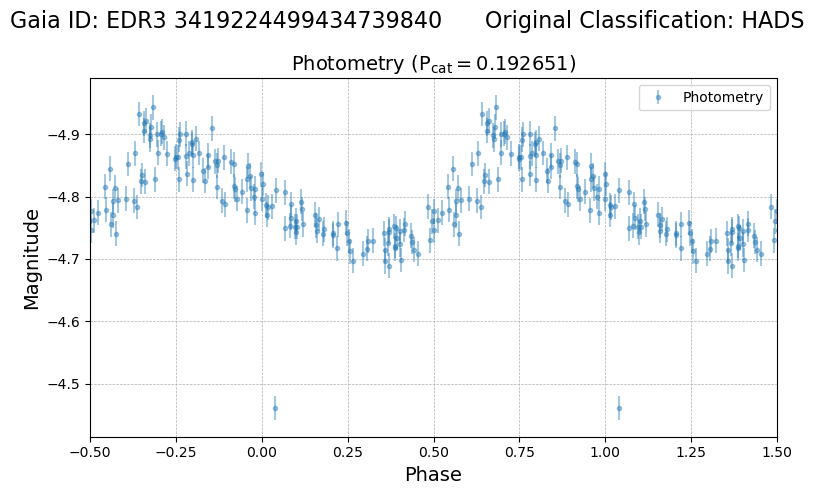

spec-58428-KII050806N241554V01_sp04-204.fits.gz


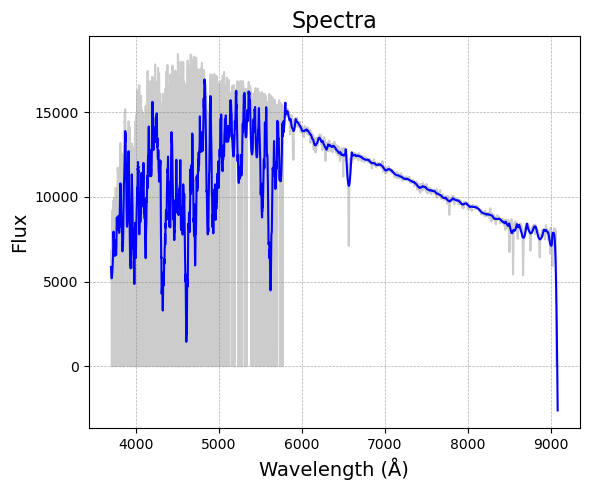

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
650590  b6ae63f3-42b3-59a0-988f-4c6ca0498dfa     55225   

                        asassn_name other_names    raj2000   dej2000  \
650590  ASASSN-VJ163016.41+165506.5   V1116 Her  247.56838  16.91846   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
650590  2.456818e+06  4.466256e+18  J163016.39+165506.0    34339142.0   

                  edr3_source_id                galex_id         tic_id  
650590  EDR3 4466256127980292096  GALEX J163016.4+165506  TIC 233685517   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
650590       0.25  0.094683            0.39       0.81 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
650590      11.26        11.269442           0.004963         11.404752   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

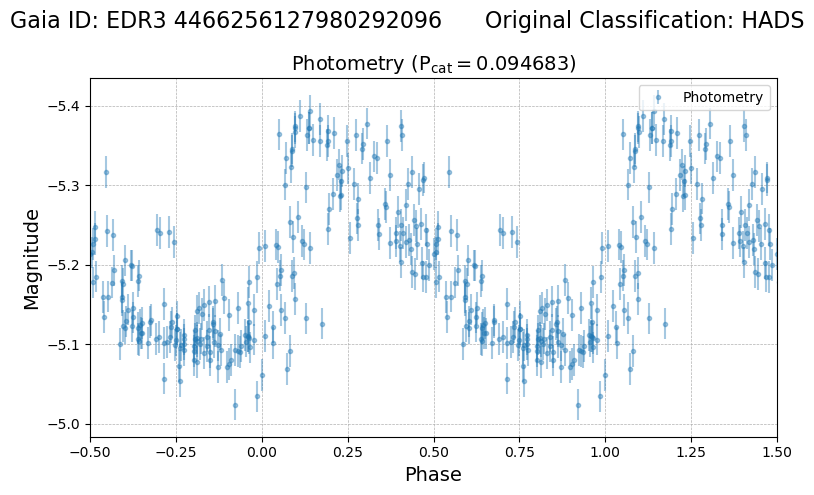

spec-56403-HD163229N165051B01_sp04-159.fits.gz


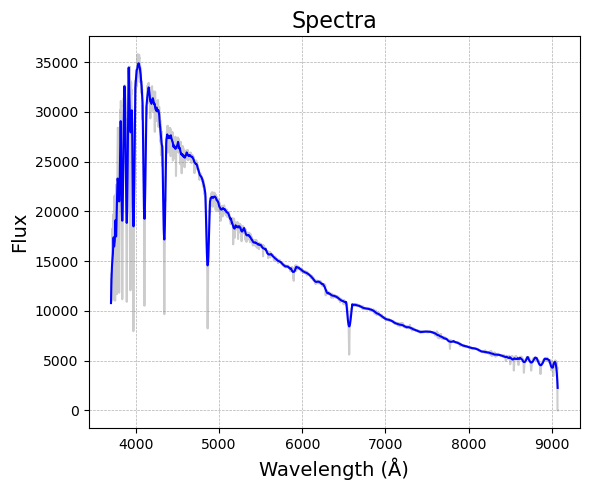

spec-57881-HD163229N165051V01_sp04-159.fits.gz


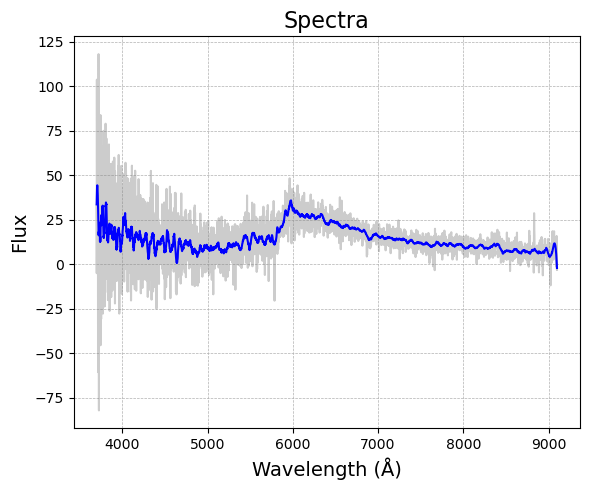

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
233235  566e59f2-3c7d-51bc-941d-b54a9459e98b    186252   

                        asassn_name          other_names   raj2000  dej2000  \
233235  ASASSN-VJ062442.79-181642.6  ASAS J062443-1816.7  96.17831 -18.2785   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
233235  2.457882e+06  2.943323e+18  J062442.85-181642.8    19019068.0   

                  edr3_source_id galex_id        tic_id  
233235  EDR3 2943323190824223744      NaN  TIC 60405689   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
233235        0.2  0.066731            0.26       0.87 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
233235      11.22        11.171396           0.003869         11.313662   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_

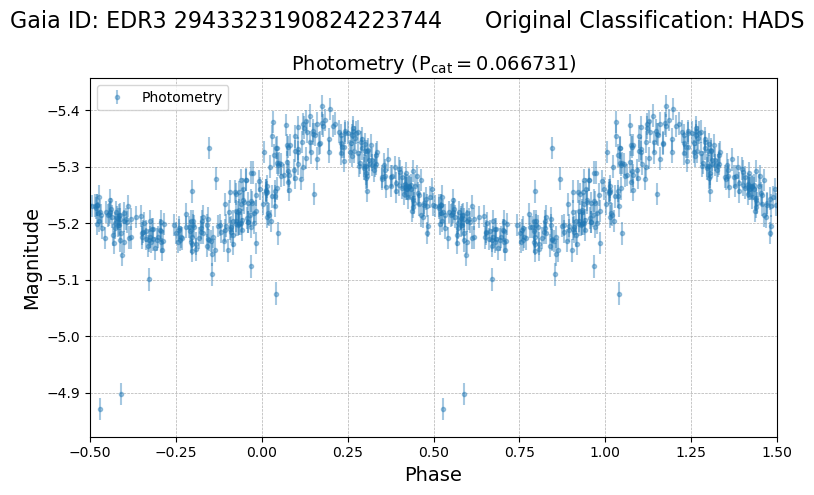

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
647532  833052be-a3ad-5cad-aedd-21ac7b88d597    285514   

                        asassn_name          other_names    raj2000  dej2000  \
647532  ASASSN-VJ115229.13-024502.2  ASAS J115229-0245.1  178.12136 -2.75061   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
647532  2.457463e+06  3.602045e+18  J115229.13-024502.4    26512505.0   

                  edr3_source_id galex_id         tic_id  
647532  EDR3 3602045073788445184      NaN  TIC 446671806   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
647532       0.19  0.083582            0.13       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
647532      11.44        11.414012           0.004164         11.537752   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    

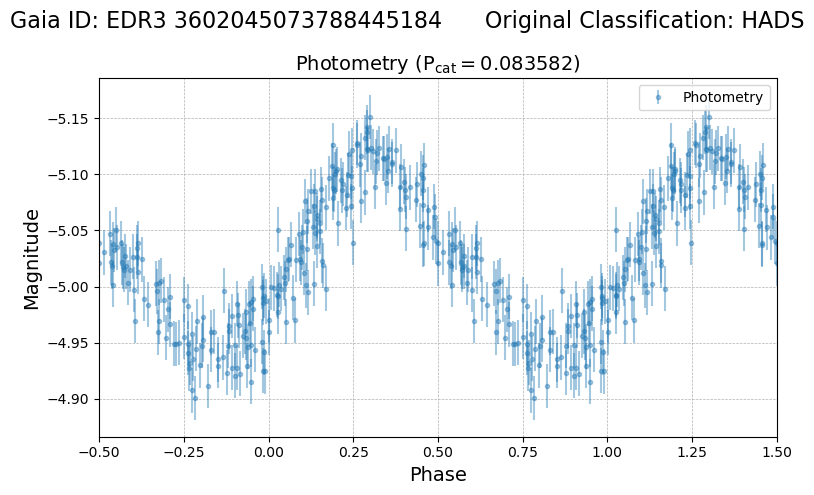

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
190637  af93713d-fb1f-5251-ba29-a513e2871c3d    125552   

                        asassn_name      other_names   raj2000  dej2000  \
190637  ASASSN-VJ073134.78+090922.4  GSC 00764-00444  112.8949  9.15622   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
190637  2.457406e+06  3.143437e+18  J073134.71+090922.9    22496973.0   

                  edr3_source_id galex_id         tic_id  
190637  EDR3 3143437085920584704      NaN  TIC 234385682   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
190637       0.18  0.161569            0.13       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
190637       12.2        12.178989           0.004319         12.363863   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \


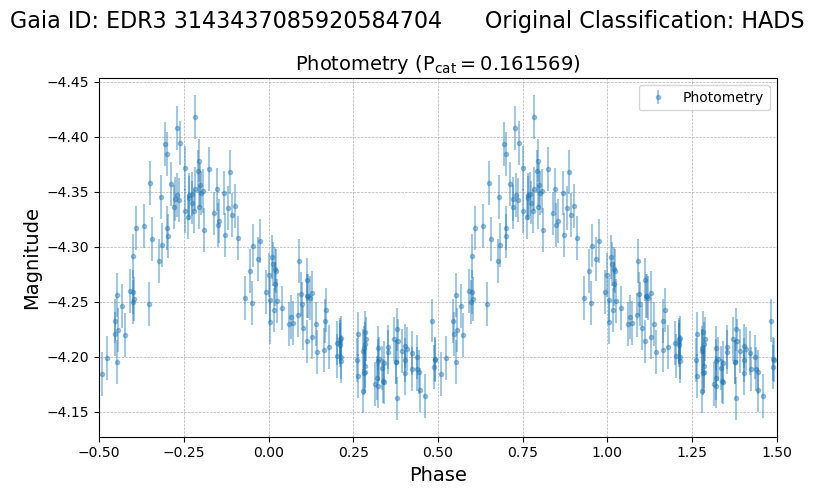

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
499328  352f2d57-542f-5bd8-bb64-d7841b4a293e  AP53444520   

                        asassn_name other_names    raj2000   dej2000  \
499328  ASASSN-VJ161521.79-322403.3         NaN  243.84078 -32.40092   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
499328  2.458200e+06  6.035657e+18  J161521.76-322403.4    53444520.0   

                  edr3_source_id galex_id        tic_id  
499328  EDR3 6035657106603217664      NaN  TIC 95976482   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
499328       0.36  0.129467            0.44       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
499328      12.24        12.116176           0.002759         12.760117   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
4993

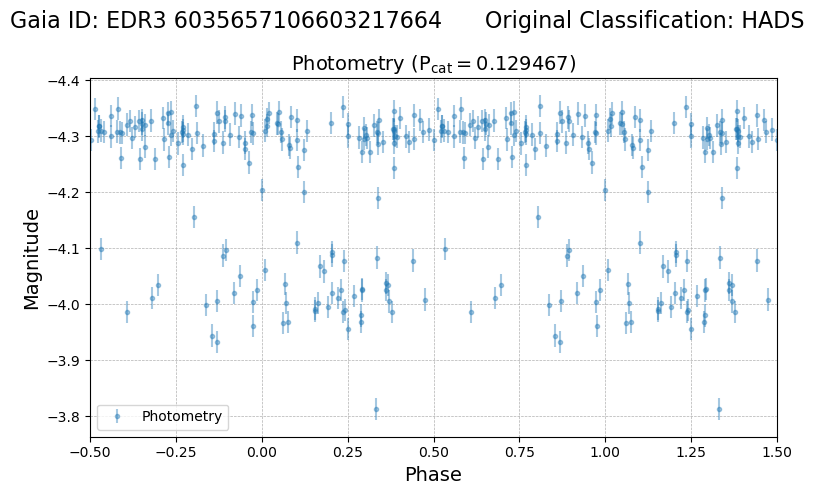

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
656893  960247f6-4ac5-58b2-9aa6-1fdc35d88c2f     82539   

                        asassn_name          other_names   raj2000   dej2000  \
656893  ASASSN-VJ180507.90+200501.1  ASAS J180508+2005.1  271.2829  20.08363   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
656893  2.457164e+06  4.527748e+18  J180507.93+200501.2           NaN   

                  edr3_source_id galex_id         tic_id  
656893  EDR3 4527748239913380096      NaN  TIC 135419876   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
656893       0.19  0.129442            0.14       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
656893      11.05        10.992822           0.003307         11.189302   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    

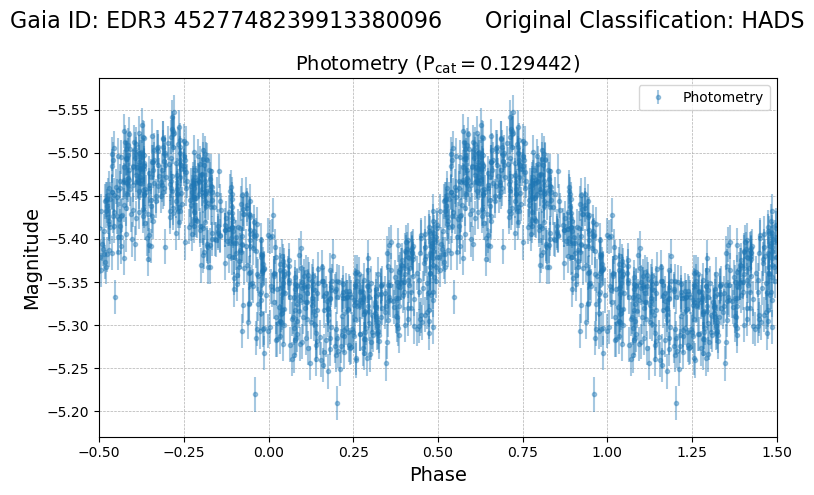

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
650992  36920f98-705c-5818-beb7-3c2a697c185d    503921   

                        asassn_name other_names    raj2000   dej2000  \
650992  ASASSN-VJ194144.71+273717.5         NaN  295.43591  27.62151   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
650992  2.457898e+06  2.031137e+18  J194144.70+273717.3           NaN   

                  edr3_source_id galex_id         tic_id  
650992  EDR3 2031137485077202560      NaN  TIC 216481549   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
650992       0.34  0.129768            0.03       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
650992       12.1        12.007965           0.004753         12.359457   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
650992

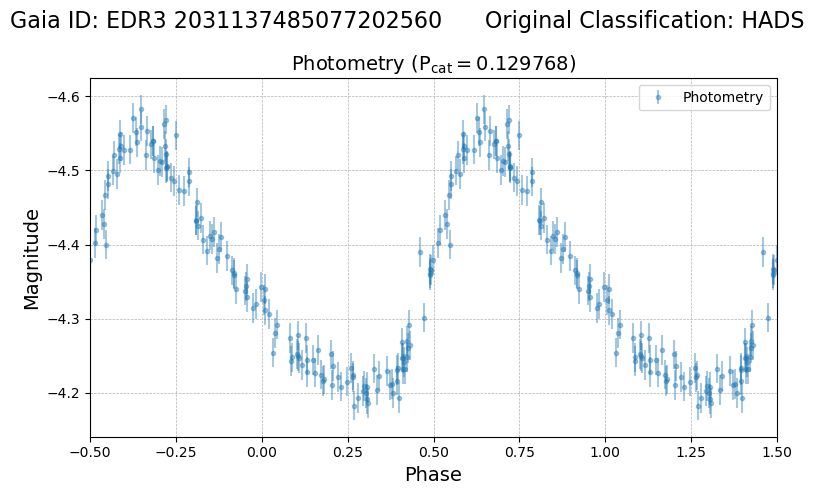

spec-57641-HD193711N282959V01_sp08-128.fits.gz


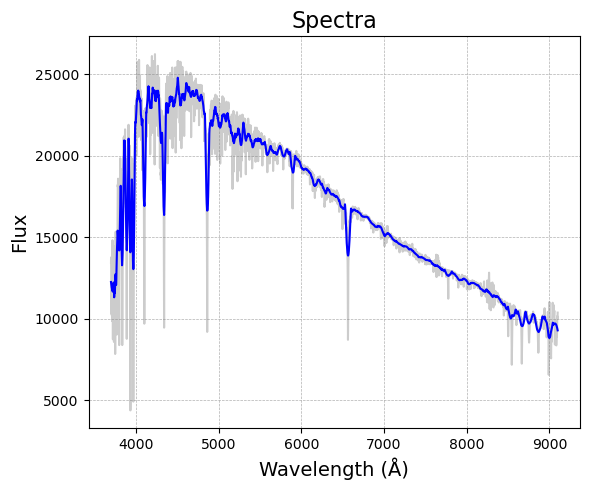

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
11187  210ed020-18a3-5b9e-ab2e-7630b999d8d7    104528   

                       asassn_name other_names    raj2000   dej2000  \
11187  ASASSN-VJ084301.31+405952.2      BO Lyn  130.75547  40.99784   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
11187  2.457458e+06  9.131869e+17  J084301.20+405951.7     6294243.0   

                edr3_source_id                galex_id        tic_id  
11187  EDR3 913186875504602624  GALEX J084301.2+405952  TIC 99091734   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
11187       0.21  0.093359            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
11187      11.93        11.886087            0.00465         12.030165   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp

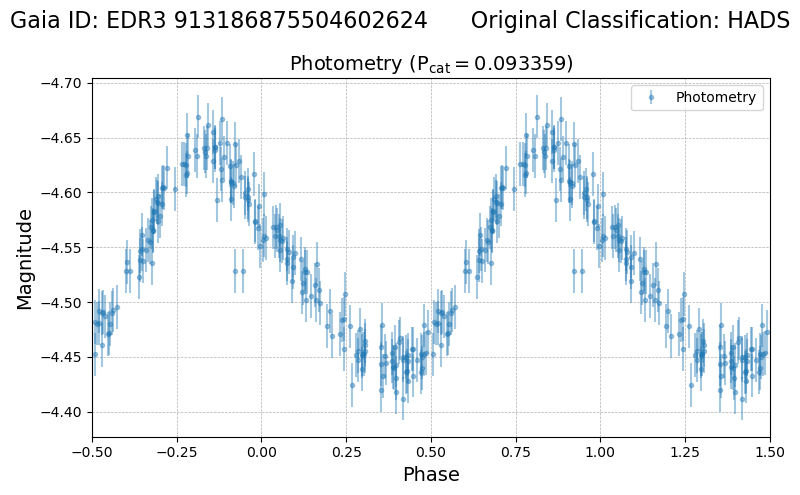

spec-56618-GAC131N42V1_sp05-048.fits.gz


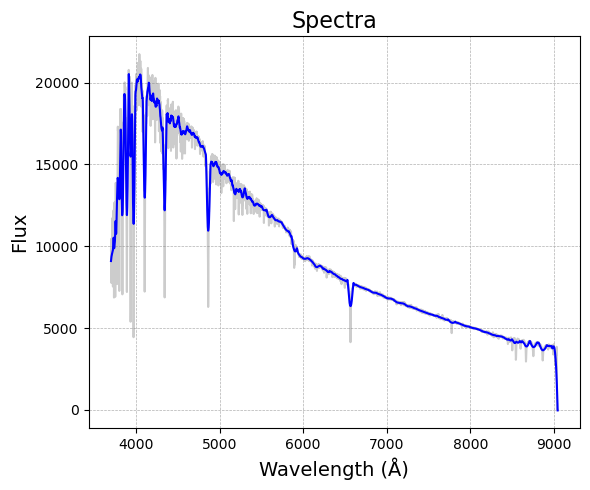

spec-56982-HD083110N401329V01_sp13-017.fits.gz


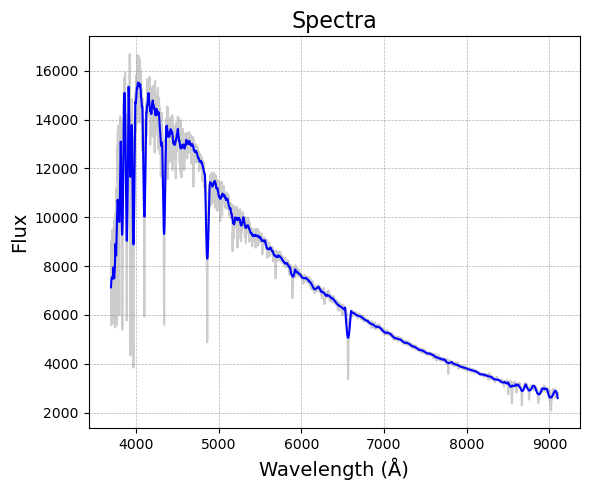

spec-57468-HD084415N420602V02_sp05-048.fits.gz


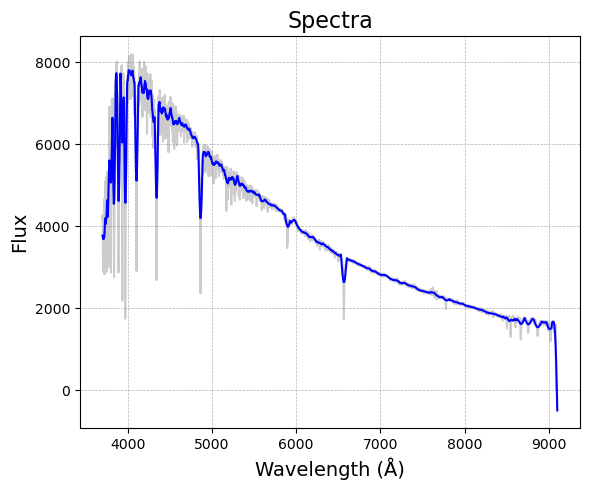

spec-59166-HD083110N401329V02_sp13-013.fits.gz


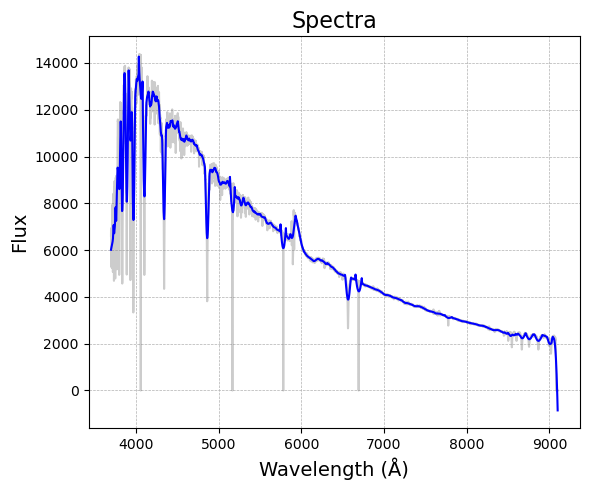

spec-57328-HD084415N420602V01_sp05-048.fits.gz


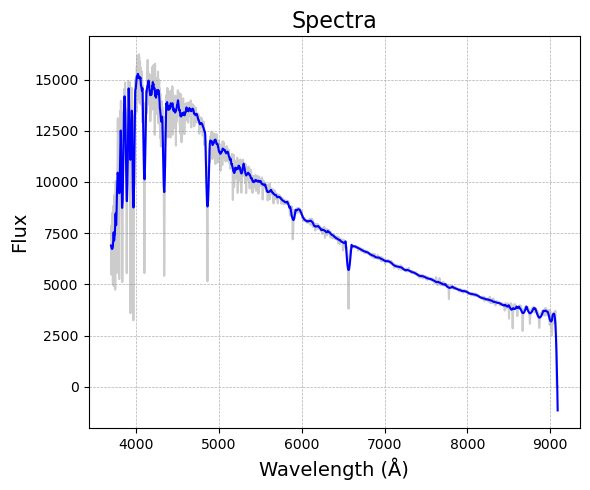

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
211510  0e97d5e1-c087-5936-9be1-79c38ce35f9c    124364   

                        asassn_name other_names   raj2000  dej2000  \
211510  ASASSN-VJ035407.19+075915.1   V1384 Tau  58.52994  7.98753   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
211510  2.457775e+06  3.301429e+18  J035407.26+075915.3    23648266.0   

                  edr3_source_id                galex_id         tic_id  
211510  EDR3 3301429283266171904  GALEX J035407.2+075915  TIC 415333069   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
211510       0.24  0.139791            0.56       0.68 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
211510      11.22        11.105948           0.005055         11.319457   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

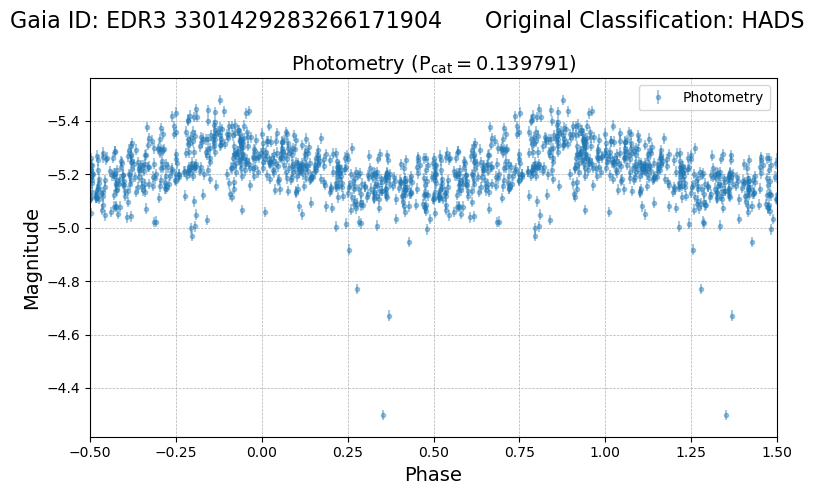

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
182312  0467cab2-772e-5fa8-9062-031a26808b2f    186059   

                        asassn_name          other_names    raj2000   dej2000  \
182312  ASASSN-VJ105851.03-261931.8  ASAS J105851-2619.5  164.71263 -26.32549   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
182312  2.457567e+06  5.457212e+18  J105851.00-261930.4    42656187.0   

                  edr3_source_id                galex_id         tic_id  
182312  EDR3 5457212216831322240  GALEX J105851.0-261930  TIC 393420032   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
182312       0.22  0.166362            0.26       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
182312      11.27        11.204623           0.003689         11.461036   

        e_phot_bp_mean_mag  phot_rp_

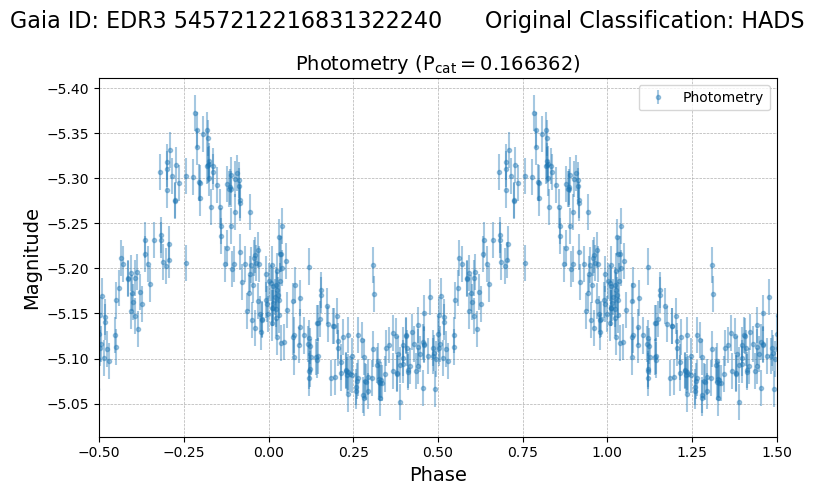

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
446066  d840bc58-34f0-5c18-aa4f-ded52b4861a5  AP16516933   

                        asassn_name              other_names  raj2000  \
446066  ASASSN-VJ002031.02-095135.0  Gaia2428159455851681792  5.12924   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
446066 -9.85971  2.456915e+06  2.428159e+18  J002031.01-095134.8   

        apass_dr9_id            edr3_source_id                galex_id  \
446066    16516933.0  EDR3 2428159455851681792  GALEX J002030.9-095134   

              tic_id  
446066  TIC 37752140   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
446066       0.21  0.078544            0.07       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
446066      11.79        11.765874           0.004483         11.926111   

        e_p

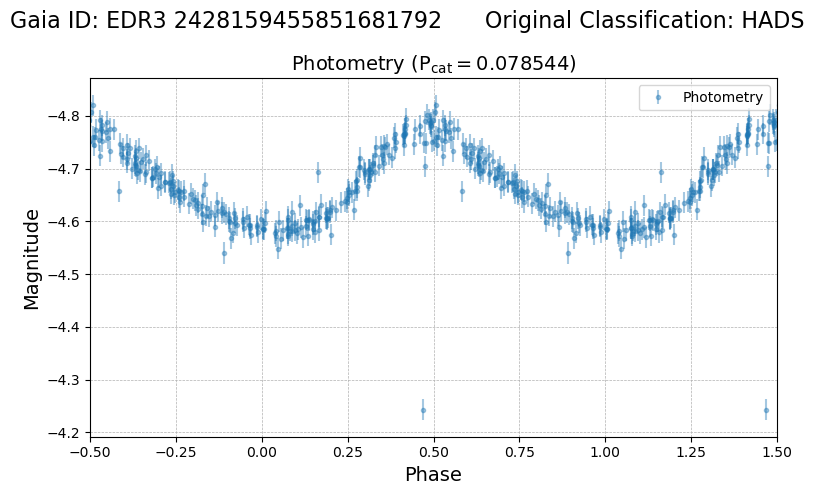

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
656861  272e8df5-9c52-5cb9-b6fa-2456428e8d86    110219   

                        asassn_name          other_names    raj2000  dej2000  \
656861  ASASSN-VJ215749.92-620144.4  ASAS J215750-6201.8  329.45802  -62.029   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
656861  2.457609e+06  6.408852e+18  J215749.98-620144.4    57387916.0   

                  edr3_source_id                galex_id         tic_id  
656861  EDR3 6408852381214047232  GALEX J215749.8-620144  TIC 277691934   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
656861        0.2  0.117641            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
656861      11.11        11.092432           0.003881         11.243739   

        e_phot_bp_mean_mag  phot_rp_me

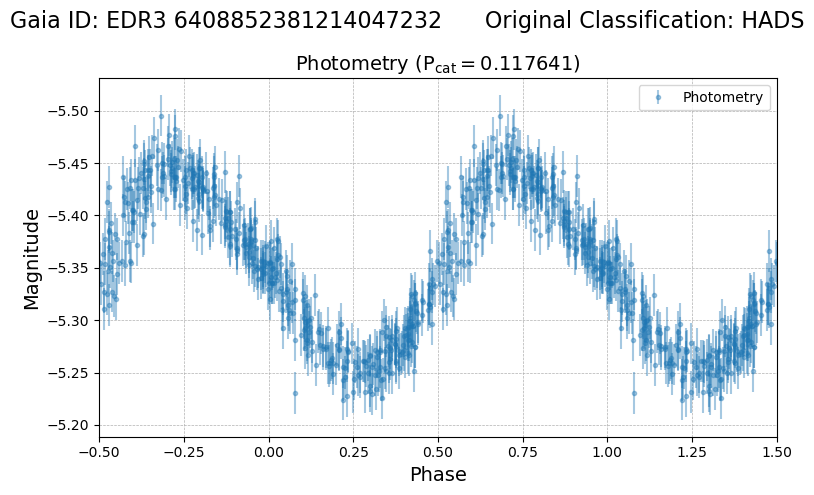

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
270259  44224a16-e21f-5952-9ebc-c5f0d174300d    203750   

                        asassn_name other_names    raj2000   dej2000  \
270259  ASASSN-VJ195523.83+372859.7   V2695 Cyg  298.84929  37.48324   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
270259  2.457965e+06  2.071911e+18  J195523.81+372859.5    14091082.0   

                  edr3_source_id galex_id         tic_id  
270259  EDR3 2071910502974356992      NaN  TIC 171409426   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
270259       0.33  0.129738            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
270259      11.96        12.014535           0.005859         12.216365   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
270259

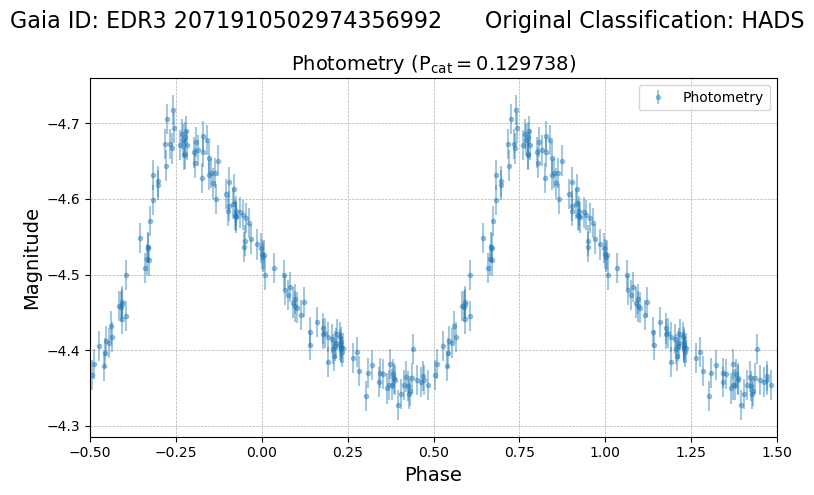

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
285123  05a9affe-3db3-5502-b0f7-65df2c768be1    149994   

                        asassn_name other_names    raj2000  dej2000  \
285123  ASASSN-VJ153530.20+853739.0      YZ UMi  233.87584  85.6275   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
285123  2.457452e+06  1.727329e+18  J153530.40+853739.0     9254907.0   

                  edr3_source_id galex_id         tic_id  
285123  EDR3 1727329331262393472      NaN  TIC 160120432   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
285123       0.45  0.096611            0.03       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
285123      12.07         12.06494           0.006586         12.254929   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
285123  

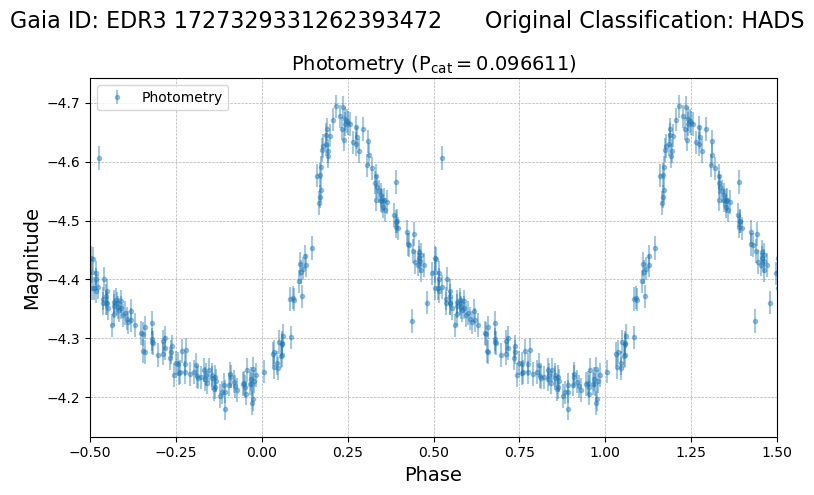

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
679334  31ab4847-e502-5d2b-81e8-cc8818eb5aaf    186068   

                        asassn_name other_names   raj2000   dej2000  \
679334  ASASSN-VJ120317.18+803342.8   V0572 Cam  180.8216  80.56189   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
679334  2.457180e+06  1.718078e+18  J120317.28+803342.6     9222344.0   

                  edr3_source_id                galex_id         tic_id  
679334  EDR3 1718077769844575744  GALEX J120316.9+803344  TIC 156198986   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
679334        0.4  0.086343            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
679334      11.38         11.49836           0.004666         11.675478   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

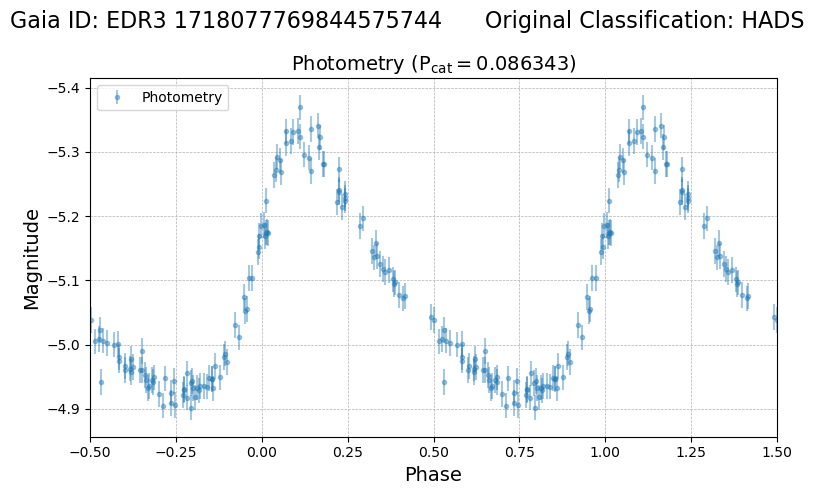

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
521068  48245297-955e-5f07-bb1d-f822b8c626ee  AP54358709   

                        asassn_name         other_names    raj2000   dej2000  \
521068  ASASSN-VJ123425.29-521407.0  ASASJ123425-5214.1  188.60536 -52.23529   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
521068  2.457847e+06  6.078026e+18  J123425.29-521407.1    54358709.0   

                  edr3_source_id galex_id         tic_id  
521068  EDR3 6078026198749820416      NaN  TIC 403959423   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
521068       0.18  0.16766            0.19       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
521068      11.62        11.485005           0.003715         11.767637   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

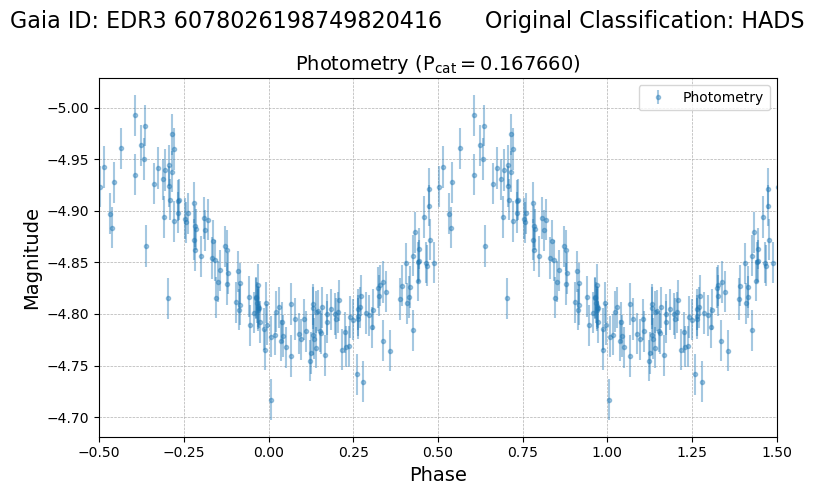

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
653599  dde49e8c-255f-5317-af95-76a208327c76    103040   

                        asassn_name other_names   raj2000   dej2000  \
653599  ASASSN-VJ021507.50+180427.2      RV Ari  33.78124  18.07421   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
653599  2.457603e+06  8.063757e+16  J021507.50+180427.8      280846.0   

                edr3_source_id                galex_id         tic_id  
653599  EDR3 80637568601414144  GALEX J021507.5+180429  TIC 306517089   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
653599       0.52  0.093128            0.21        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
653599      12.06        11.974779           0.008698         12.170811   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

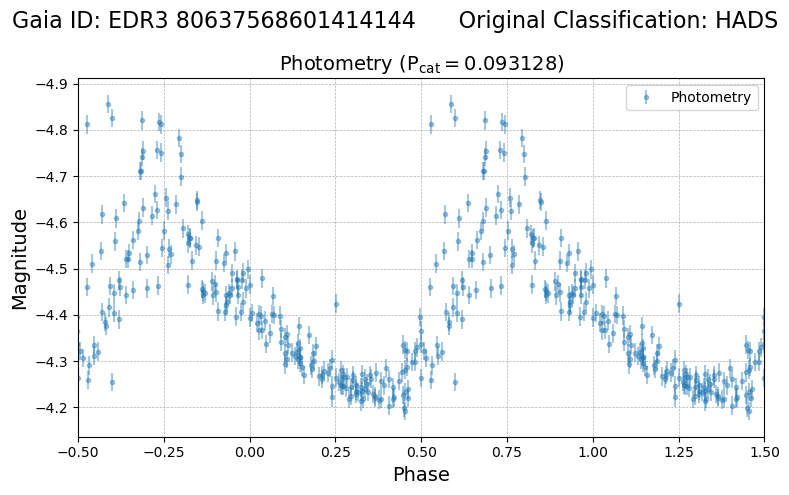

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
453405  df35100a-e993-5ed1-857d-6bc214dcfe74    311802   

                        asassn_name other_names    raj2000   dej2000  \
453405  ASASSN-VJ180357.82-295700.3   V5505 Sgr  270.99092 -29.95008   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
453405  2.457466e+06  4.050200e+18  J180357.92-295700.0           NaN   

                  edr3_source_id galex_id         tic_id  
453405  EDR3 4050200309665738496      NaN  TIC 194025647   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
453405       0.28  0.084401            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
453405      11.33        11.207026           0.005812         11.399254   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
453405

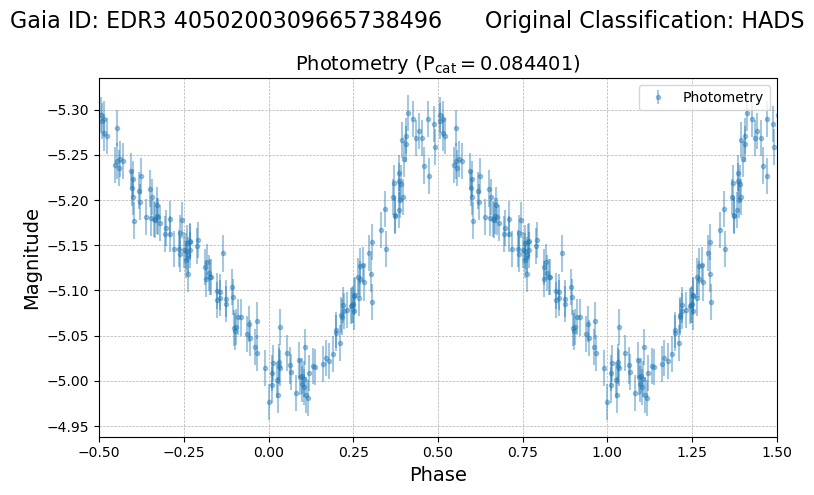

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
432026  c92e1b7e-f7dc-54c5-bfa5-e4ed5445588c    196441   

                        asassn_name          other_names    raj2000   dej2000  \
432026  ASASSN-VJ161309.99-132825.2  ASAS J161310-1328.4  243.29162 -13.47368   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
432026  2.457441e+06  4.329640e+18  J161310.01-132825.4    33064337.0   

                  edr3_source_id                galex_id        tic_id  
432026  EDR3 4329640193322564608  GALEX J161310.0-132825  TIC 52476440   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
432026       0.37  0.088523            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
432026      12.23        12.122422           0.008582          12.34379   

        e_phot_bp_mean_mag  phot_rp_me

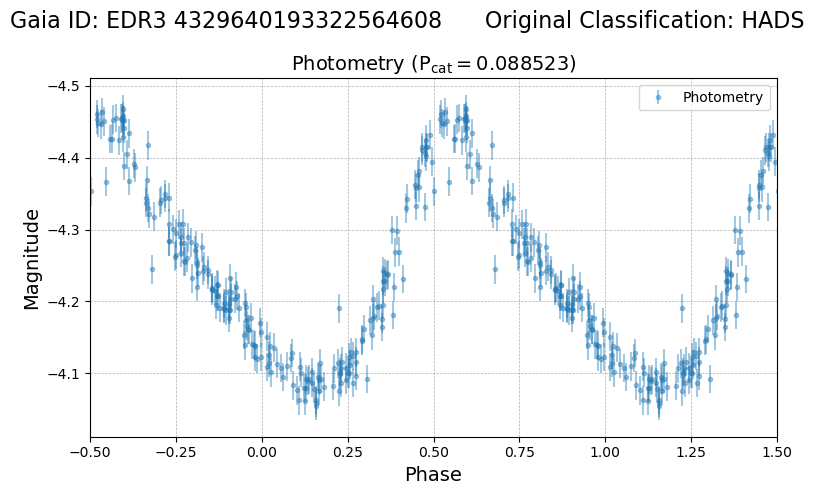

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
652088  c838bfdf-f779-5bb2-a876-2d5c31a1384c    167504   

                        asassn_name          other_names    raj2000  dej2000  \
652088  ASASSN-VJ175245.16+070042.8  ASAS J175245+0700.7  268.18817  7.01189   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
652088  2.457845e+06  4.475774e+18  J175245.12+070041.7    34521987.0   

                  edr3_source_id                galex_id         tic_id  
652088  EDR3 4475773809868887936  GALEX J175245.0+070040  TIC 277259743   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
652088       0.29  0.146322            0.41       0.82 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
652088      10.98        10.964506             0.0054         11.174215   

        e_phot_bp_mean_mag  phot_rp_me

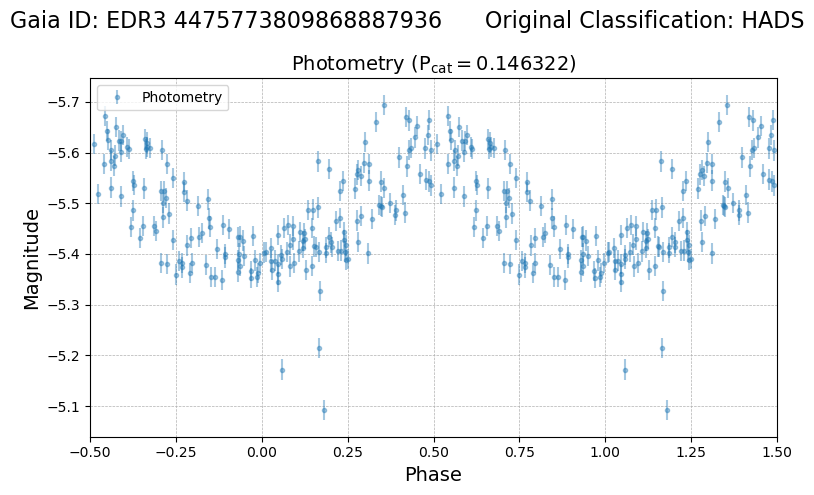

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
133951  83e8c738-1c61-542f-83d9-943c5e290e4b    102009   

                        asassn_name          other_names    raj2000   dej2000  \
133951  ASASSN-VJ234003.29-473838.1  ASAS J234003-4738.7  355.01369 -47.64393   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
133951  2.457713e+06  6.525028e+18  J234003.31-473837.7    58035556.0   

                  edr3_source_id                galex_id         tic_id  
133951  EDR3 6525028291632102528  GALEX J234003.3-473837  TIC 144309524   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
133951       0.43  0.111421            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
133951      11.57        11.581233           0.006302          11.70516   

        e_phot_bp_mean_mag  phot_rp_

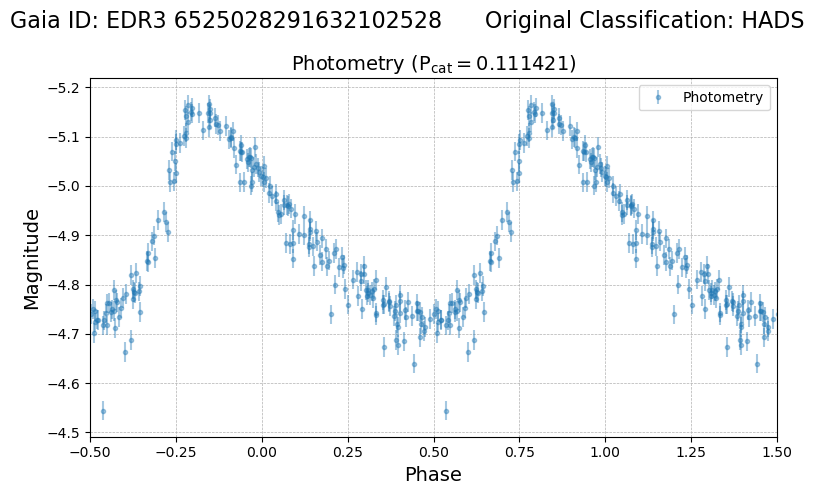

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
647691  59ebe8c1-8149-54d1-8c7b-a1005c2e559d    141751   

                        asassn_name other_names   raj2000   dej2000  \
647691  ASASSN-VJ015458.04+294737.9      BN Tri  28.74184  29.79386   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
647691  2.456904e+06  3.009279e+17  J015458.04+294737.0     2050421.0   

                 edr3_source_id                galex_id        tic_id  
647691  EDR3 300927948746366592  GALEX J015457.9+294737  TIC 28292974   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
647691       0.17  0.070035            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
647691      11.98        11.931273            0.00449         12.097846   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

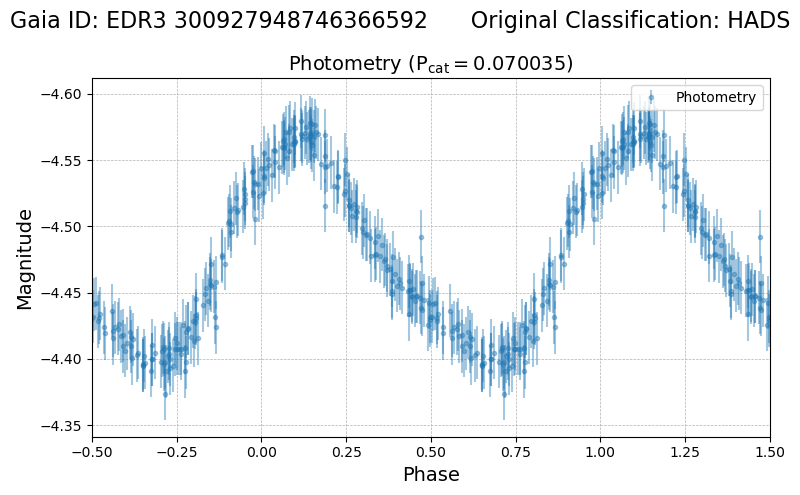

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
213357  3dee4104-8162-5c8c-9c30-803b0ad1ebe7    137355   

                        asassn_name   other_names   raj2000  dej2000  \
213357  ASASSN-VJ032242.47+390634.2  NSVS 4156098  50.67695  39.1095   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
213357  2.457256e+06  2.358912e+17  J032242.49+390634.5     1463468.0   

                 edr3_source_id                galex_id         tic_id  
213357  EDR3 235891221785573248  GALEX J032242.4+390634  TIC 194604292   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
213357       0.49  0.110105            0.01       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
213357       12.3         12.31301           0.007477         12.553337   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

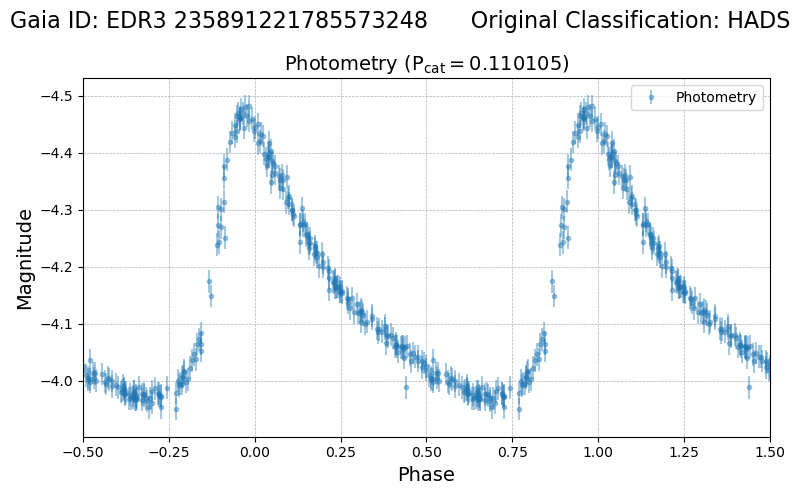

spec-56952-GAC049N39B1_sp08-037.fits.gz


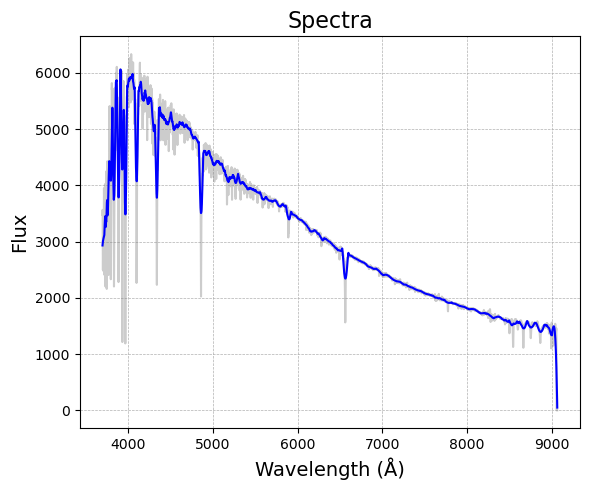

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
242425  addfd171-96e9-5e09-8437-55e0f48a8cc0    100808   

                        asassn_name          other_names   raj2000  dej2000  \
242425  ASASSN-VJ022429.72+081230.9  ASAS J022430+0812.5  36.12384  8.20859   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
242425  2.457604e+06  2.283947e+16  J022429.72+081230.6       63786.0   

                edr3_source_id galex_id         tic_id  
242425  EDR3 22839472144886528      NaN  TIC 365227352   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
242425       0.18  0.084299            0.16       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
242425      11.39          11.3753           0.003113         11.584235   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp

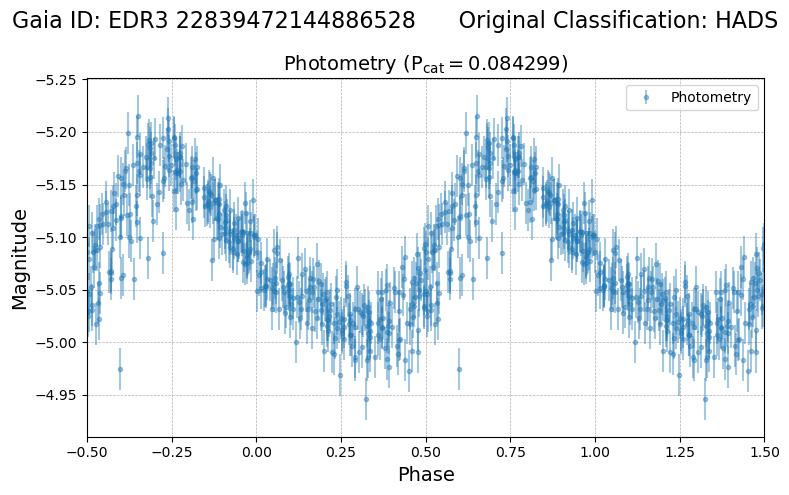

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
679950  81fc1c32-37b7-5303-b50e-4b90244fe02b    105379   

                        asassn_name           other_names    raj2000  dej2000  \
679950  ASASSN-VJ205846.62+014455.4  VSX J205846.6+014452  314.69427  1.74872   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
679950  2.456866e+06  1.729883e+18  J205846.68+014452.5     9266122.0   

                  edr3_source_id                galex_id         tic_id  
679950  EDR3 1729882500341502848  GALEX J205846.7+014451  TIC 396549403   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
679950        0.3  0.072396            0.01       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
679950      12.28         12.21626           0.006362         12.376488   

        e_phot_bp_mean_mag  phot_rp_

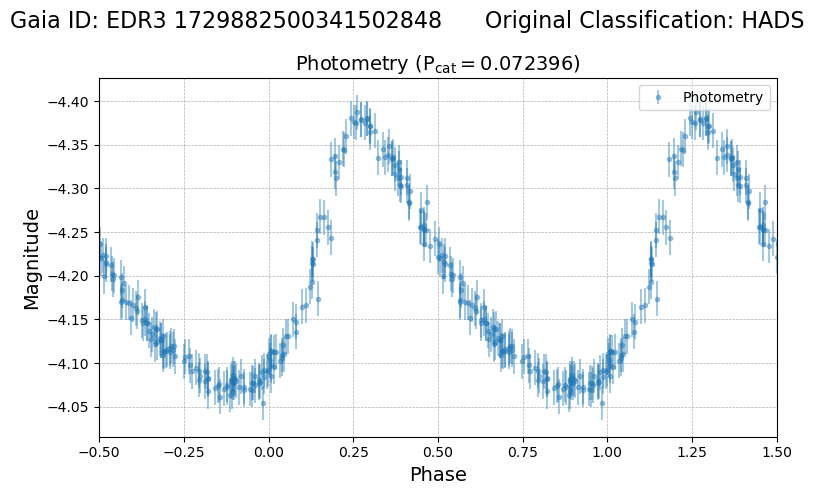

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
649403  6913a0c0-0392-50a9-99b8-937daaaf8e13    451575   

                        asassn_name other_names    raj2000  dej2000  \
649403  ASASSN-VJ195903.89+504639.4         NaN  299.76656  50.7777   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
649403  2.457163e+06  2.088660e+18  J195903.87+504639.2    14367045.0   

                  edr3_source_id galex_id         tic_id  
649403  EDR3 2088660192534344832      NaN  TIC 303178091   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
649403       0.19  0.087043            0.07       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
649403      11.65        11.649062           0.003658         11.793441   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
649403  

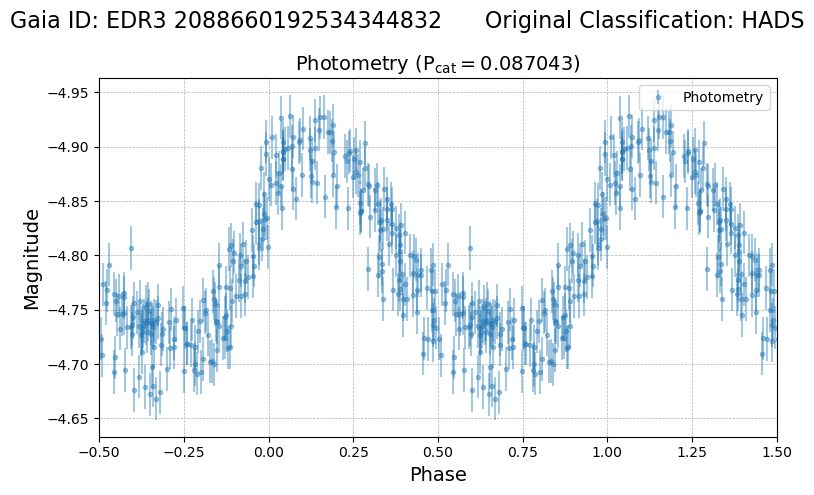

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
224200  7444b92e-b581-5c13-a3ff-c4d96bb54d46    377874   

                        asassn_name          other_names    raj2000   dej2000  \
224200  ASASSN-VJ133151.10-523226.4  ASAS J133151-5232.4  202.96291 -52.54066   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
224200  2.458123e+06  6.068950e+18  J133151.00-523226.6    54128377.0   

                  edr3_source_id galex_id         tic_id  
224200  EDR3 6068949975085707520      NaN  TIC 420010481   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
224200       0.16  0.160016            0.34       0.84 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
224200      11.12        11.022987           0.003403         11.240312   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

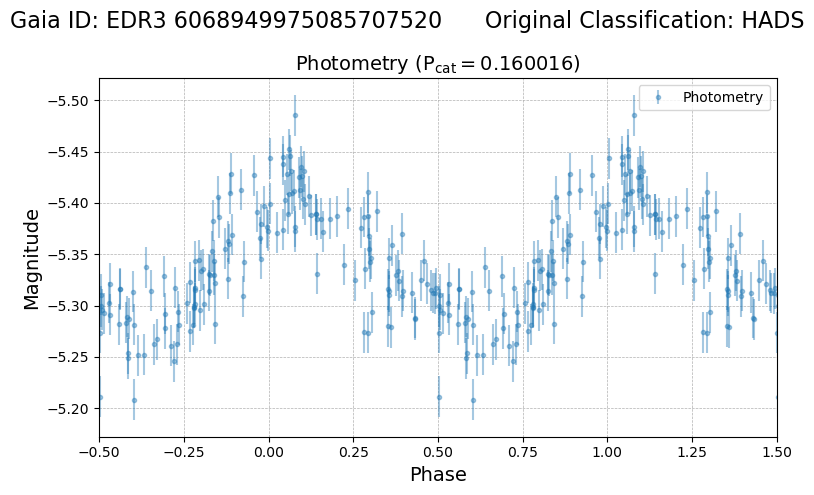

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
445314  63cfe2fb-9801-5a58-ae0a-124e33949be0  AP58569665   

                        asassn_name              other_names    raj2000  \
445314  ASASSN-VJ181110.12-582859.7  Gaia6647762200502135936  272.79217   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
445314 -58.48324  2.457229e+06  6.647762e+18  J181110.13-582859.4   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
445314    58569665.0  EDR3 6647762200502135936      NaN  TIC 118434563   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
445314       0.19  0.088735            0.43       0.79 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
445314      11.04        11.038081            0.00404         11.190433   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

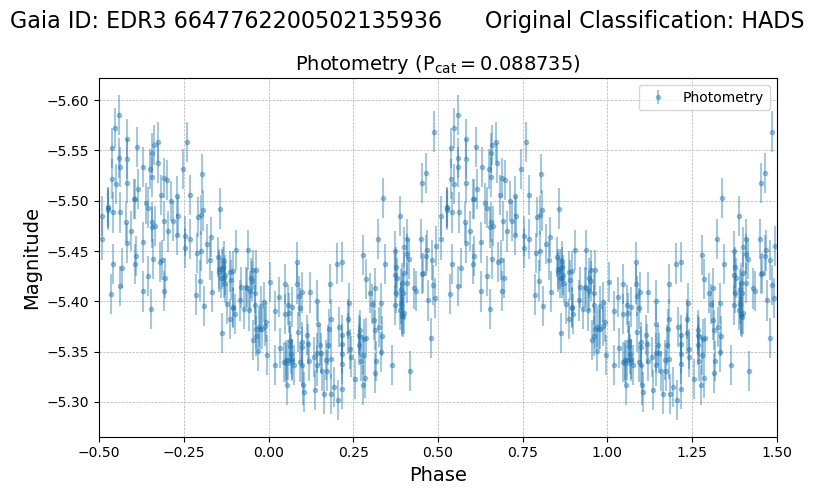

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
188420  27bc5b4e-2a42-5e76-a8d9-a5a711ec0381    193499   

                        asassn_name          other_names    raj2000   dej2000  \
188420  ASASSN-VJ200812.00+105052.2  ASAS J200812+1050.8  302.04998  10.84783   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
188420  2.457141e+06  4.300566e+18  J200811.94+105051.7    32576384.0   

                  edr3_source_id galex_id         tic_id  
188420  EDR3 4300565807362028928      NaN  TIC 366212477   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
188420       0.33  0.086864            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
188420      12.08        12.029366           0.004546         12.220946   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

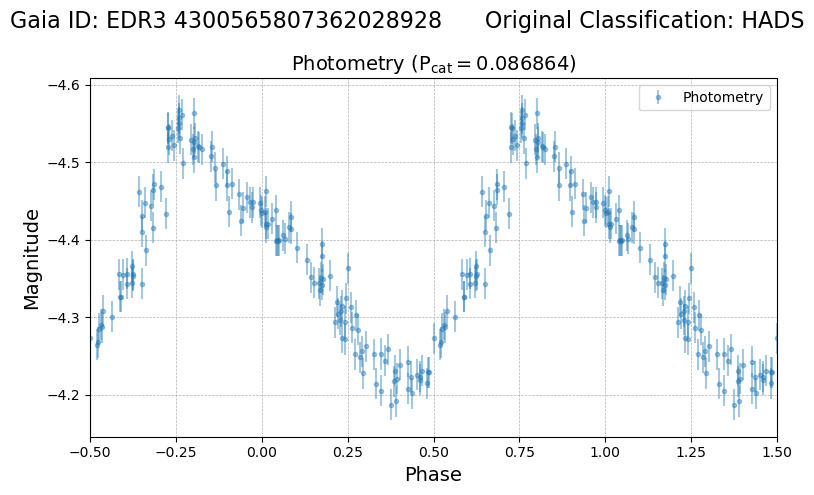

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
286803  d113e254-38e9-5513-a615-d6f71b877198     93269   

                        asassn_name other_names    raj2000   dej2000  \
286803  ASASSN-VJ224721.58+390922.3   V0547 Lac  341.83991  39.15619   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
286803  2.457973e+06  1.929106e+18  J224721.42+390922.0    11652803.0   

                  edr3_source_id galex_id         tic_id  
286803  EDR3 1929105554799406592      NaN  TIC 129128212   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
286803       0.34  0.095255            0.09       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
286803      12.18        12.097202           0.004904         12.312194   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
286803

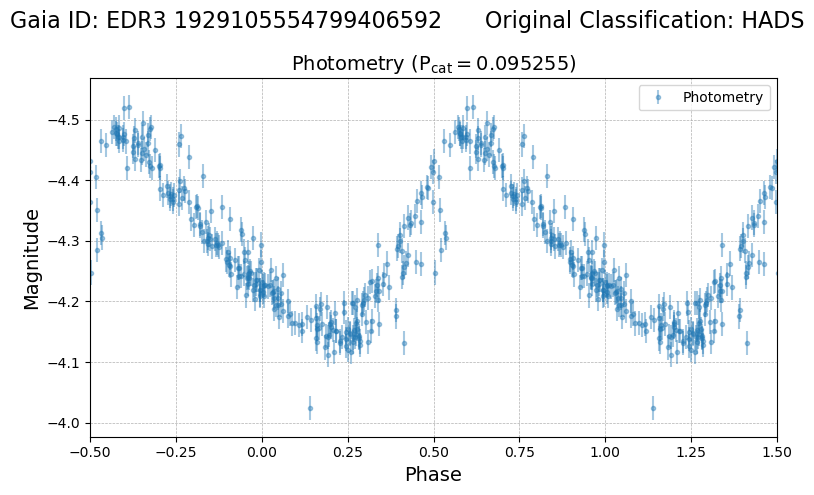

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
643320  3cfdfb52-3bfc-5bde-9a39-0ee3b5433e4c  AP10814741   

                        asassn_name             other_names    raj2000  \
643320  ASASSN-VJ211856.54+342641.5  ATLASJ319.7356+34.4448  319.73559   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
643320  34.44485  2.457914e+06  1.855325e+18  J211856.55+342641.4   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
643320    10814741.0  EDR3 1855325030345846272      NaN  TIC 117287285   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
643320       0.22  0.133153            0.15       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
643320      11.42        11.407042           0.003946         11.584086   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

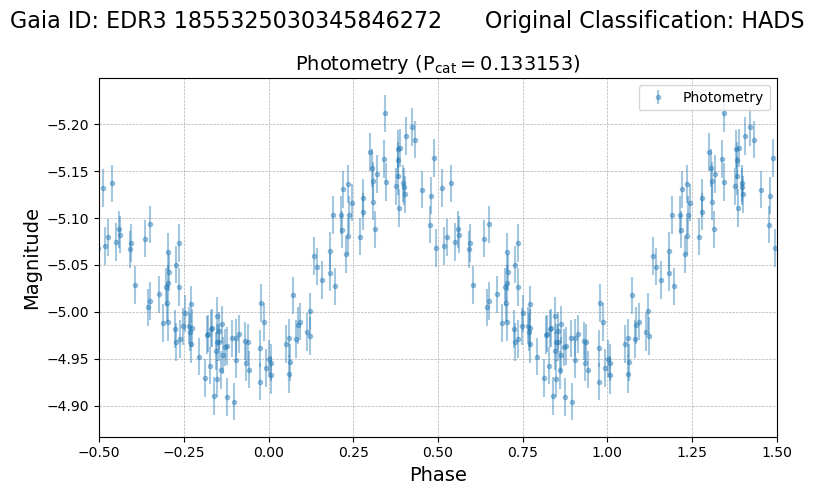

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
174745  c73d433a-4ea1-5241-a4b0-52cb54faff0d     84373   

                        asassn_name          other_names   raj2000   dej2000  \
174745  ASASSN-VJ014554.20-473012.3  ASAS J014554-4730.2  26.47583 -47.50342   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
174745  2.457690e+06  4.953999e+18  J014554.19-473012.6    37361161.0   

                  edr3_source_id                galex_id         tic_id  
174745  EDR3 4953998932007980288  GALEX J014554.1-473012  TIC 401840644   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
174745       0.16  0.150849            0.12       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
174745      11.27         11.23887           0.003423         11.378216   

        e_phot_bp_mean_mag  phot_rp_me

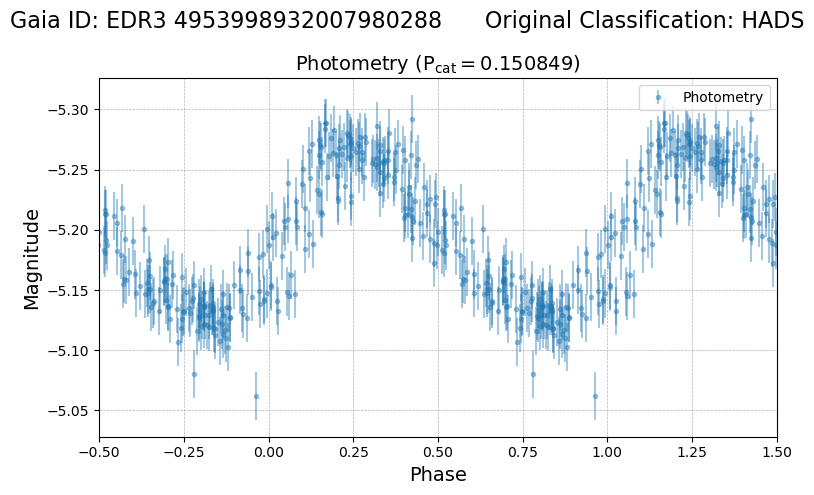

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
59695  33d641c1-b24e-5dad-988e-93f127efc29f    152364   

                       asassn_name          other_names    raj2000   dej2000  \
59695  ASASSN-VJ201341.34-132927.3  ASAS J201341-1329.5  303.42223 -13.49093   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
59695  2.457930e+06  6.879566e+18  J201341.43-132927.2    60902727.0   

                 edr3_source_id                galex_id        tic_id  
59695  EDR3 6879565919091009024  GALEX J201341.4-132926  TIC 14422256   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
59695       0.32  0.066177             0.2        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
59695      12.09        12.112911           0.005385         12.320177   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_pho

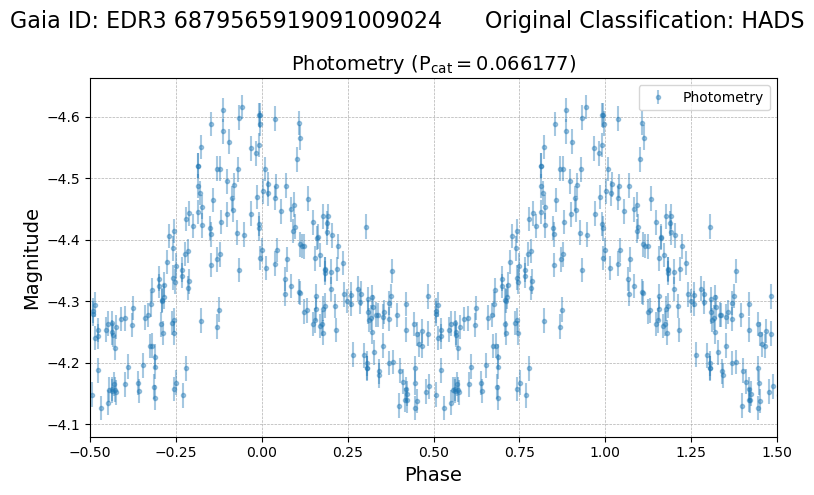

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
370510  b94a3850-d033-5929-9dd5-2115cf8cc6a9  AP51004804   

                        asassn_name other_names    raj2000   dej2000  \
370510  ASASSN-VJ171153.35-532357.9         NaN  257.97231 -53.39941   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
370510  2.457958e+06  5.924031e+18  J171153.33-532358.0    51004804.0   

                  edr3_source_id galex_id         tic_id  
370510  EDR3 5924031314585433984      NaN  TIC 213701037   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
370510       0.16  0.072803            0.57       0.74 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
370510       11.0        10.848837           0.003657         11.037213   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
37

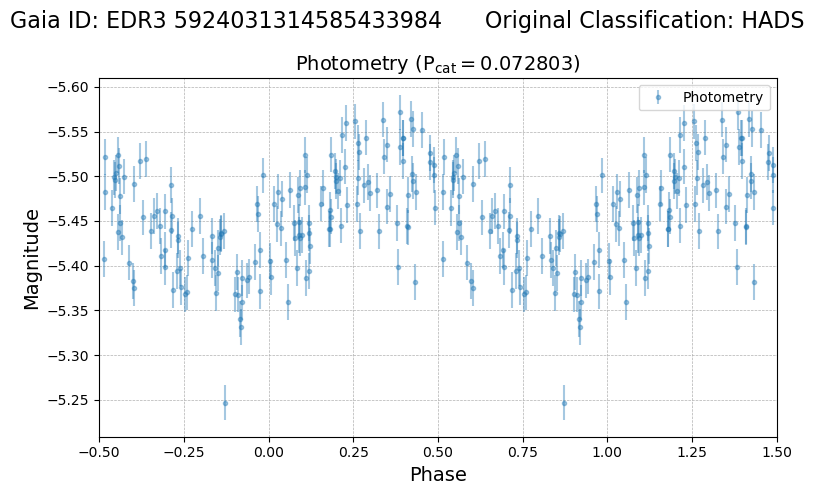

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
166292  82d7690d-b523-5bcb-b4c2-44bec1978389    422731   

                        asassn_name          other_names    raj2000   dej2000  \
166292  ASASSN-VJ172814.71-462842.6  ASAS J172815-4628.7  262.06128 -46.47851   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
166292  2.457916e+06  5.951840e+18  J172814.66-462842.5    51736919.0   

                  edr3_source_id galex_id         tic_id  
166292  EDR3 5951839685985116928      NaN  TIC 218260102   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
166292       0.17  0.180336            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
166292       11.2        11.151898           0.004351         11.378929   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

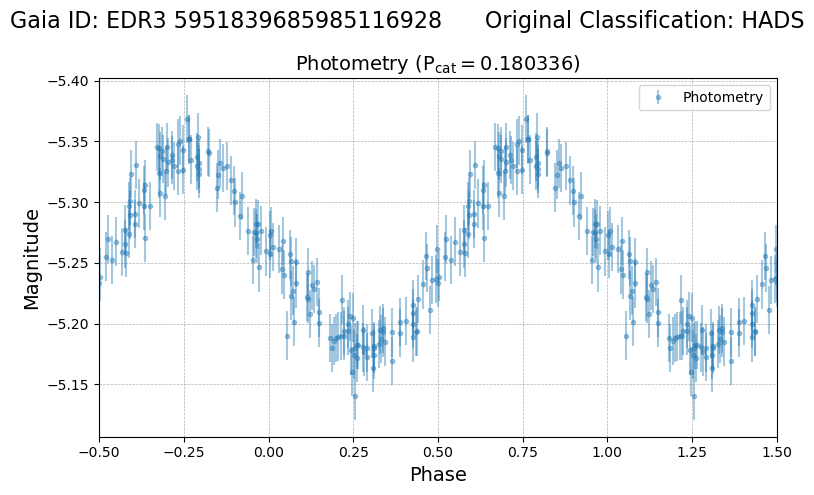

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
553048  41f2db1b-4177-52bc-8516-b8893cbcdf41  AP11666106   

                        asassn_name           other_names    raj2000  \
553048  ASASSN-VJ230931.87+412525.4  WISEJ230931.8+412525  347.38281   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
553048  41.42371  2.457979e+06  1.930476e+18  J230931.87+412525.3   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
553048    11666106.0  EDR3 1930475653664118400      NaN  TIC 374140788   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
553048       0.29  0.16784            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
553048      12.39        12.251631           0.005173         12.665648   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_m

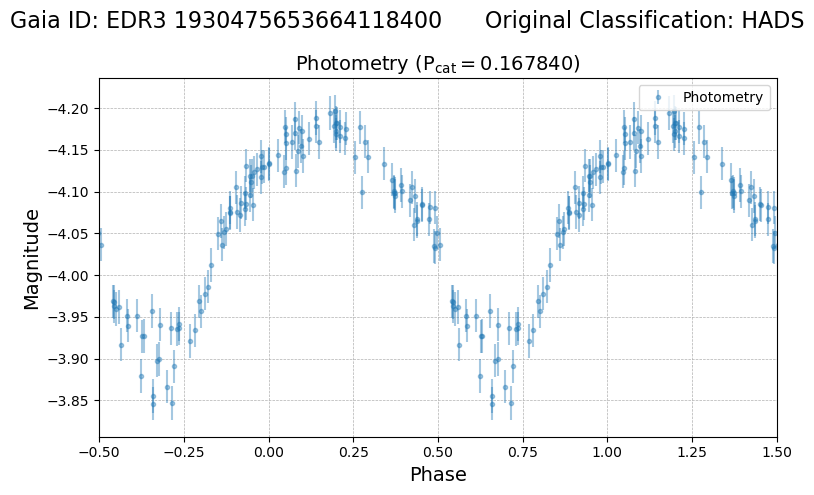

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
175712  dbbf1911-5472-584b-9ee0-1689369b01c1    256566   

                        asassn_name              other_names    raj2000  \
175712  ASASSN-VJ225254.93+492202.9  USNO-A2.0 1350-17486565  343.22886   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
175712  49.36746  2.458011e+06  1.985504e+18  J225254.87+492202.5   

        apass_dr9_id            edr3_source_id galex_id        tic_id  
175712    12947164.0  EDR3 1985504350912545536      NaN  TIC 67311425   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
175712       0.26  0.128311            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
175712      12.17        12.069831           0.004185         12.306339   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

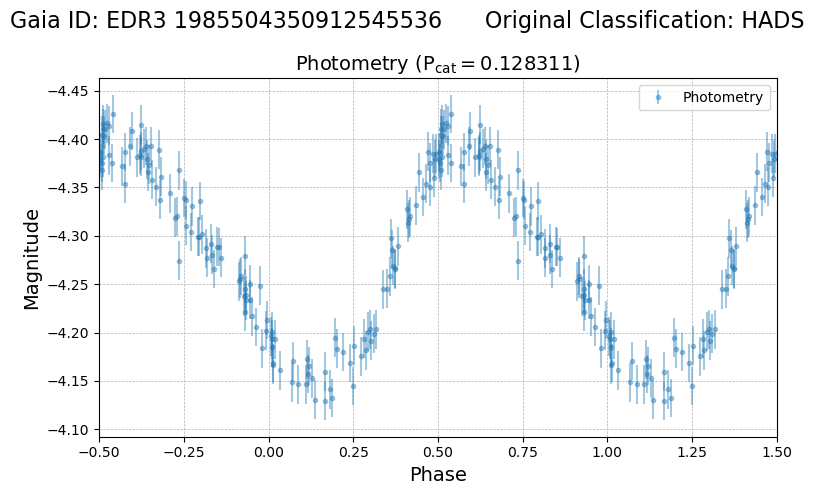

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
167294  8ad50dfc-2ce7-59a9-819b-d29d5244a324    246926   

                        asassn_name          other_names    raj2000   dej2000  \
167294  ASASSN-VJ095736.16-720206.6  ASAS J095737-7202.1  149.40066 -72.03518   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
167294  2.457857e+06  5.242211e+18  J095736.36-720206.0    38725046.0   

                  edr3_source_id galex_id         tic_id  
167294  EDR3 5242210895641311360      NaN  TIC 453335857   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
167294       0.32  0.168709             0.6       0.65 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
167294      12.03        11.931738            0.00401         12.178309   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

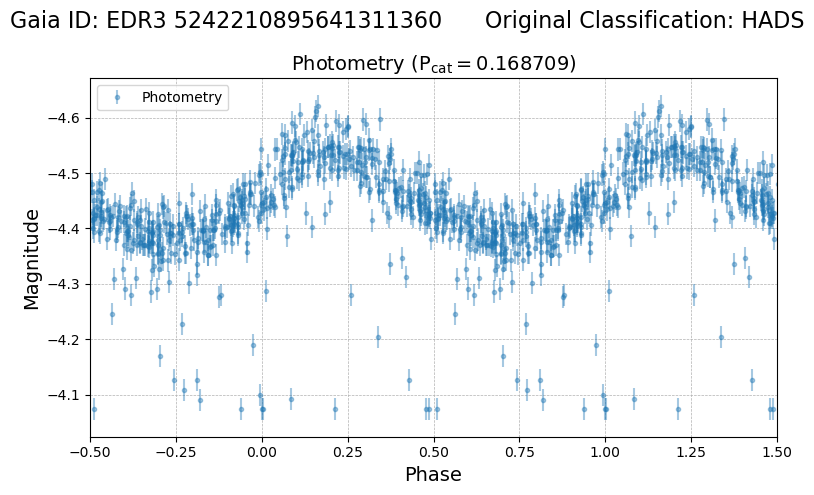

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
438656  b87b3cd8-ebe9-5391-9e33-143afd49c32b  AP9707894   

                        asassn_name             other_names    raj2000  \
438656  ASASSN-VJ214253.92+140633.2  ATLASJ325.7246+14.1092  325.72466   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
438656  14.10922  2.456915e+06  1.770629e+18  J214253.92+140633.2   

        apass_dr9_id            edr3_source_id                galex_id  \
438656     9707894.0  EDR3 1770628790654744320  GALEX J214253.9+140633   

               tic_id  
438656  TIC 314910124   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
438656       0.17  0.121378            0.48       0.77 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
438656      11.48        11.426499            0.00381         11.673619   

       

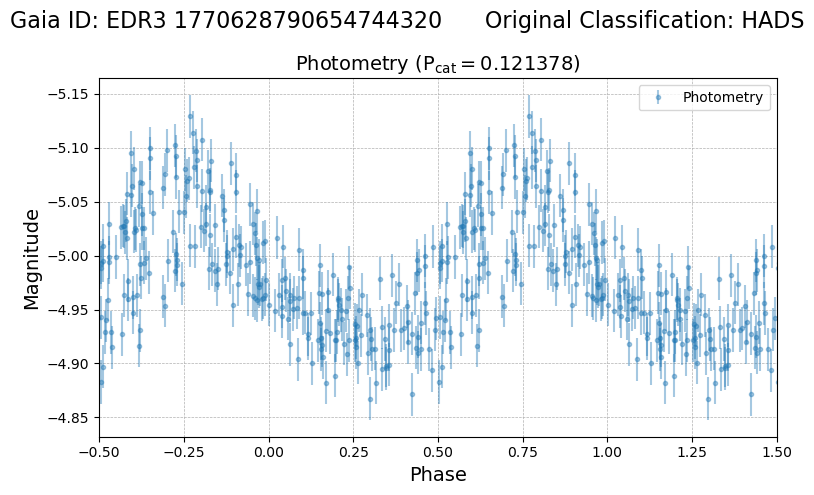

spec-56966-HD213605N150455V01_sp06-008.fits.gz


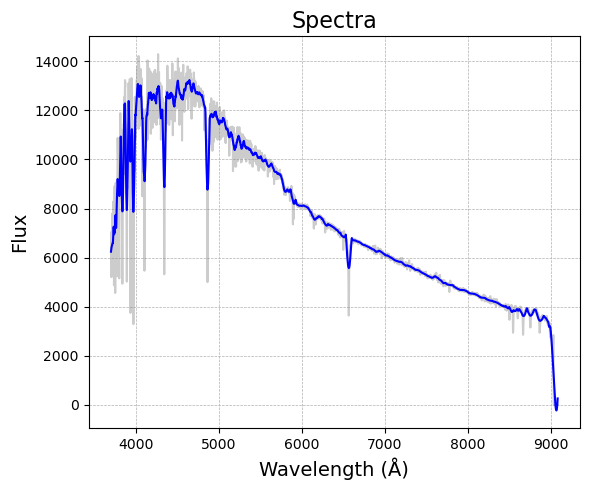

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
465990  bea5cae5-59ce-56d9-9321-ba03ef11a2fc  AP734889   

                        asassn_name other_names   raj2000   dej2000  \
465990  ASASSN-VJ042901.42+323532.9         NaN  67.25591  32.59248   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
465990  2.457361e+06  1.724411e+17  J042901.41+323532.8      734889.0   

                 edr3_source_id galex_id         tic_id  
465990  EDR3 172441051445614592      NaN  TIC 349696156   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
465990       0.15  0.143153            0.36       0.83 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
465990      11.36        11.206135             0.0037         11.597172   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    bp_rp  \
465990     

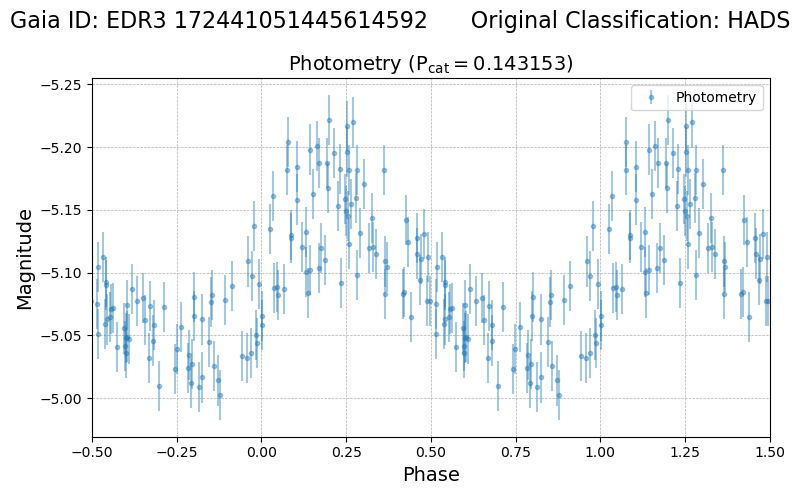

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
274566  5a7c8804-ef0b-5625-aa01-1e9a0063b571    407117   

                        asassn_name          other_names  raj2000   dej2000  \
274566  ASASSN-VJ141441.28-614457.2  ASAS J141441-6145.0  213.672 -61.74923   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
274566  2.457911e+06  5.854501e+18  J141441.20-614456.9    48966329.0   

                  edr3_source_id galex_id         tic_id  
274566  EDR3 5854500844943412480      NaN  TIC 334436767   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
274566       0.32  0.133733            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
274566      11.49        11.413473            0.00429          11.67114   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     b

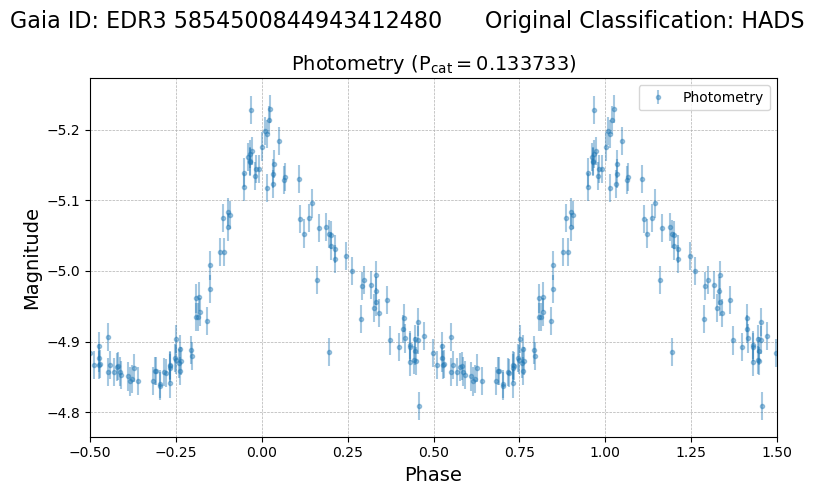

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
452252  c982e758-7dad-5408-a069-c4ca1d2c254f  AP8153101   

                        asassn_name other_names    raj2000   dej2000  \
452252  ASASSN-VJ161331.69+323442.5       AUCrB  243.38203  32.57846   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
452252  2.456815e+06  1.322504e+18  J161331.69+323442.4     8153101.0   

                  edr3_source_id                galex_id        tic_id  
452252  EDR3 1322503791460292608  GALEX J161331.6+323442  TIC 17539022   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
452252       0.18  0.05172            0.13       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
452252      11.89          11.9058           0.003633         12.020865   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

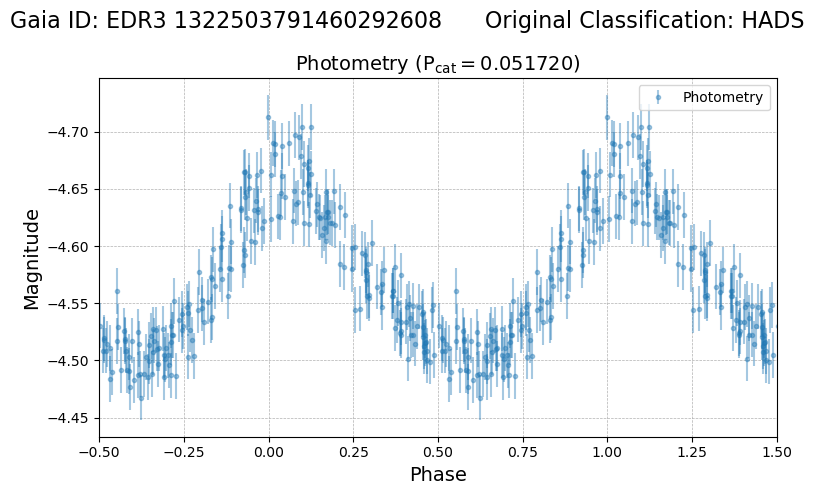

spec-56723-HD162301N323735V01_sp10-005.fits.gz


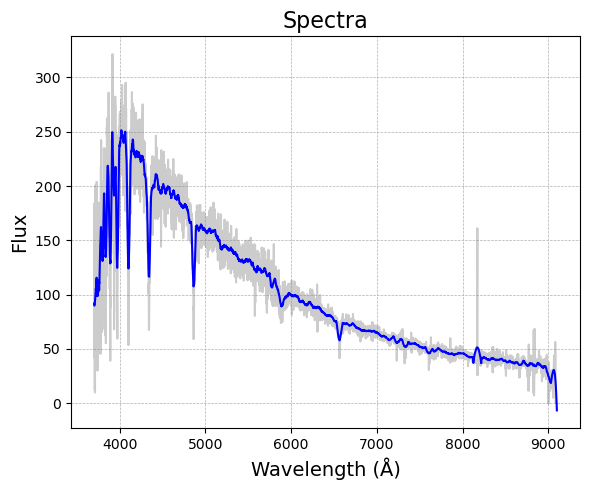

spec-57502-HD162301N323735V02_sp10-005.fits.gz

💥⬇️💥 THIS SPECTRA WAS MARKED AS AN OUTLIER 💥⬇️💥



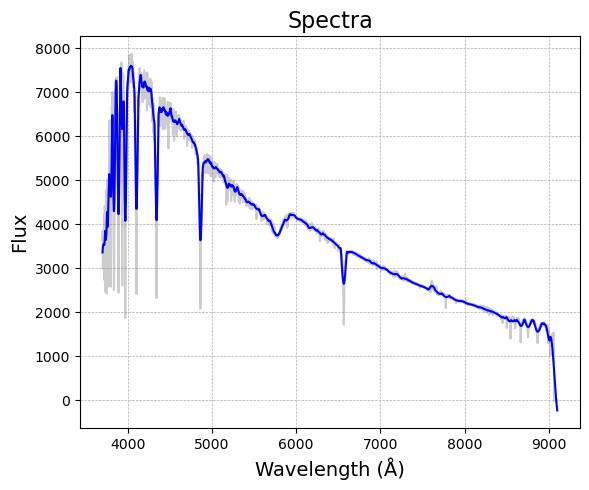

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287888  243e39f5-fd61-5b90-9d77-9576dba85f64     56730   

                        asassn_name          other_names    raj2000   dej2000  \
287888  ASASSN-VJ080102.29-634029.4  ASAS J080102-6340.5  120.25954 -63.67483   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287888  2.457125e+06  5.277450e+18  J080102.38-634030.1    39466737.0   

                  edr3_source_id galex_id         tic_id  
287888  EDR3 5277450208946461568      NaN  TIC 308396022   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
287888       0.27  0.075737            0.14       0.93 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287888      11.35        11.326256           0.004138          11.49825   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

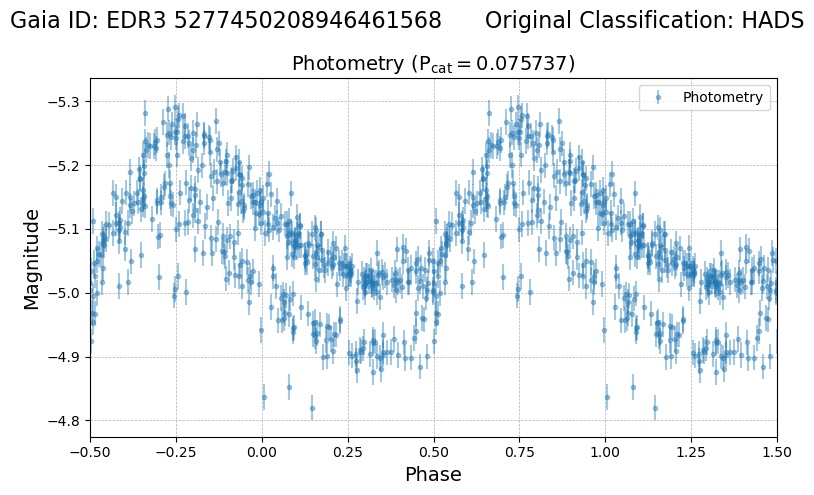

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
553154  e57c0cce-2288-5bf9-8eb8-d709284a7f9a  AP605201   

                        asassn_name             other_names   raj2000  \
553154  ASASSN-VJ045317.08+285141.5  ATLASJ073.3211+28.8615  73.32117   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
553154  28.86153  2.457720e+06  1.552425e+17  J045317.07+285141.4   

        apass_dr9_id           edr3_source_id                galex_id  \
553154      605201.0  EDR3 155242490564157696  GALEX J045317.0+285141   

              tic_id  
553154  TIC 60334458   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
553154       0.22  0.13144            0.03       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
553154      11.73        11.509832           0.004437         11.967381   

        e_phot_bp

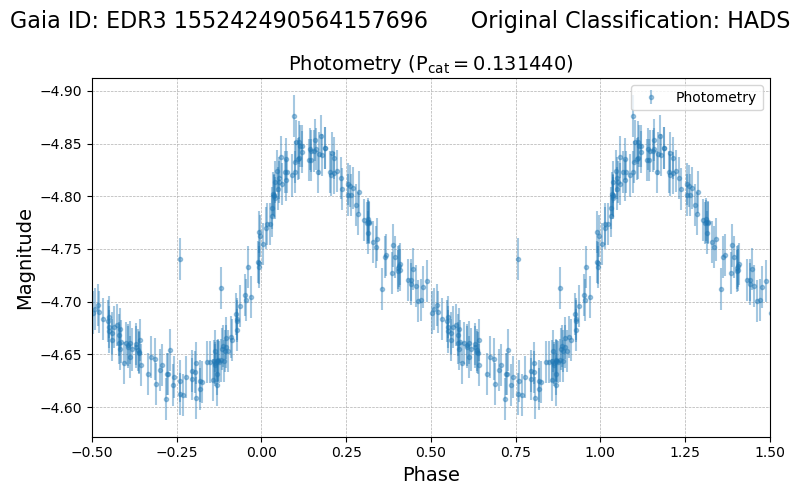

spec-58848-HD045545N303304V01_sp02-051.fits.gz


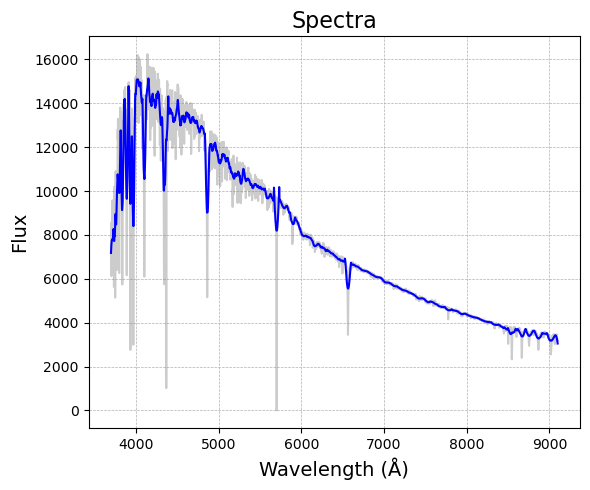

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
520365  3d926097-9d5b-54b0-81dc-5a14398d60e0  AP15522474   

                        asassn_name             other_names    raj2000  \
520365  ASASSN-VJ215512.82+580226.4  ATLASJ328.8034+58.0406  328.80343   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
520365  58.04068  2.457905e+06  2.199393e+18  J215512.82+580226.2   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
520365    15522474.0  EDR3 2199393176802588288      NaN  TIC 276116556   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
520365       0.24  0.194648            0.07       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
520365      11.77        11.484845           0.004296         11.935539   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

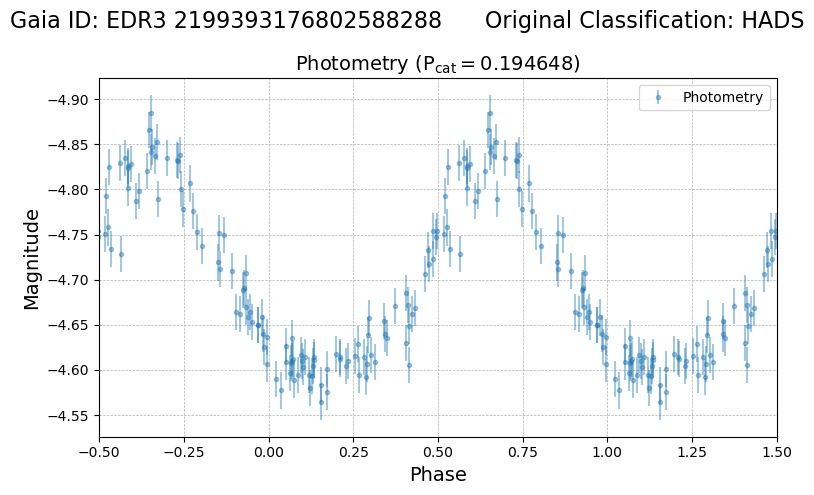

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
441283  6cafae17-17f9-5963-b1d8-f8a4c3a77668    166892   

                        asassn_name          other_names    raj2000  dej2000  \
441283  ASASSN-VJ180756.89+090148.8  ASAS J180757+0901.8  271.98703  9.03022   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
441283  2.457549e+06  4.482256e+18  J180756.92+090148.8    34671026.0   

                  edr3_source_id galex_id        tic_id  
441283  EDR3 4482255705793765120      NaN  TIC 24676978   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
441283       0.15  0.105314            0.12       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
441283      11.48        11.410997           0.003953         11.674348   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     b

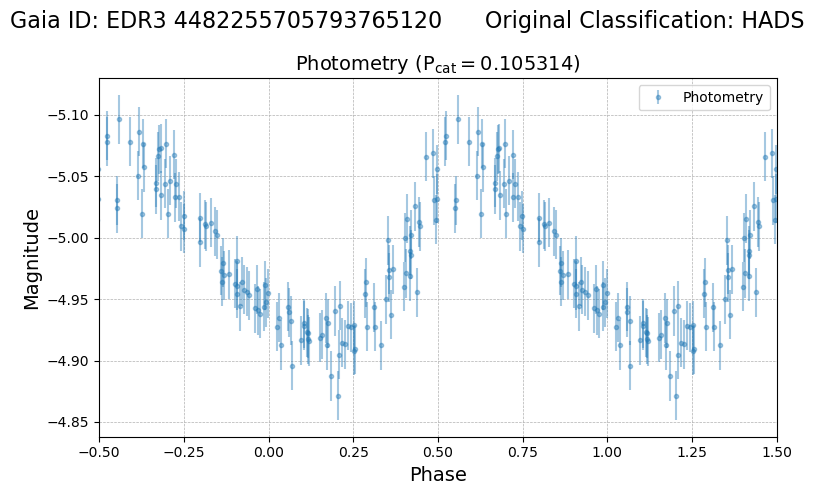

spec-57166-HD180717N064205V01_sp11-215.fits.gz


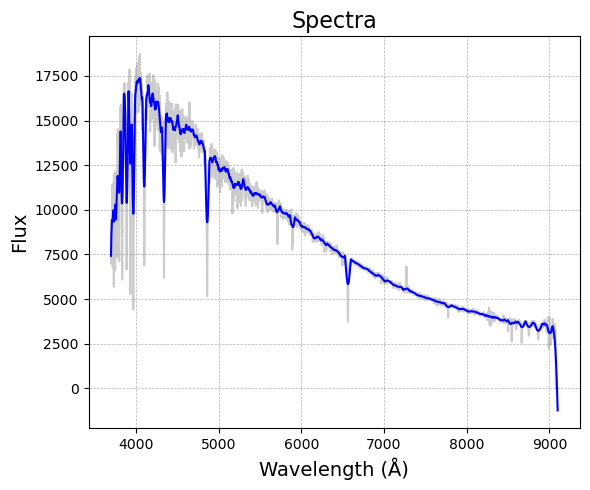

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
468099  dcca7868-5212-5115-ab1c-5d876a88d566     71578   

                        asassn_name          other_names    raj2000   dej2000  \
468099  ASASSN-VJ184737.52-361003.4  ASAS J184738-3610.1  281.90633 -36.16762   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
468099  2.456860e+06  6.732045e+18  J184737.53-361003.1    59661009.0   

                  edr3_source_id galex_id         tic_id  
468099  EDR3 6732044783293356416      NaN  TIC 253709825   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
468099       0.18  0.076947            0.15       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
468099      11.29        11.250041            0.00417         11.440344   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

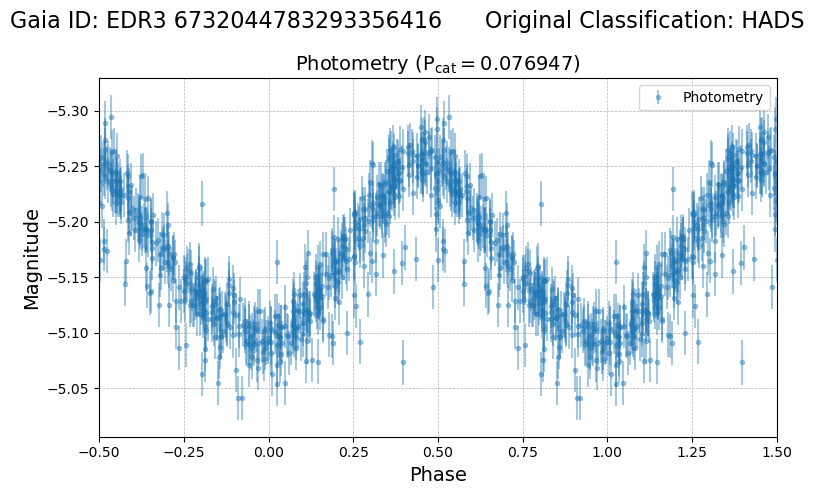

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
196101  ef93d840-6c86-57eb-8908-73f7ad8167fd    205638   

                        asassn_name          other_names   raj2000   dej2000  \
196101  ASASSN-VJ050456.18+232948.5  ASAS J050456+2329.8  76.23408  23.49681   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
196101  2.458025e+06  3.418475e+18  J050456.19+232948.0    25290729.0   

                  edr3_source_id galex_id        tic_id  
196101  EDR3 3418475044822244224      NaN  TIC 69272575   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
196101       0.22  0.171749            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
196101      11.84        11.663451           0.004694         12.030501   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     b

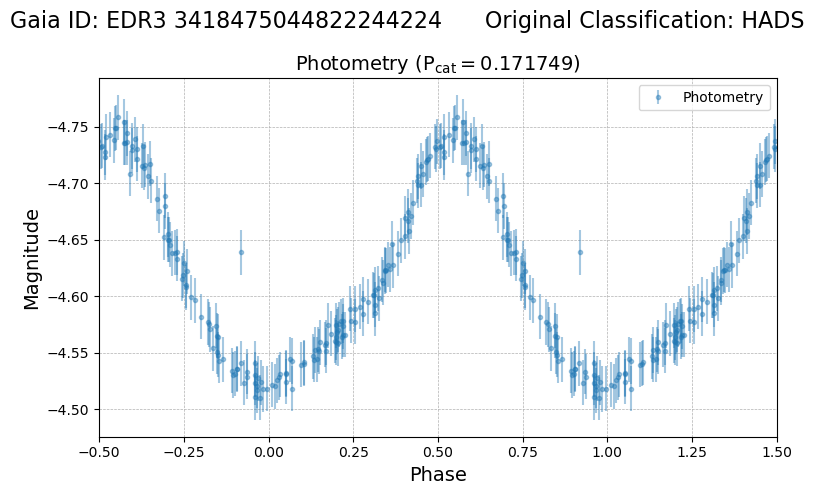

spec-58428-KII050806N241554V01_sp05-064.fits.gz


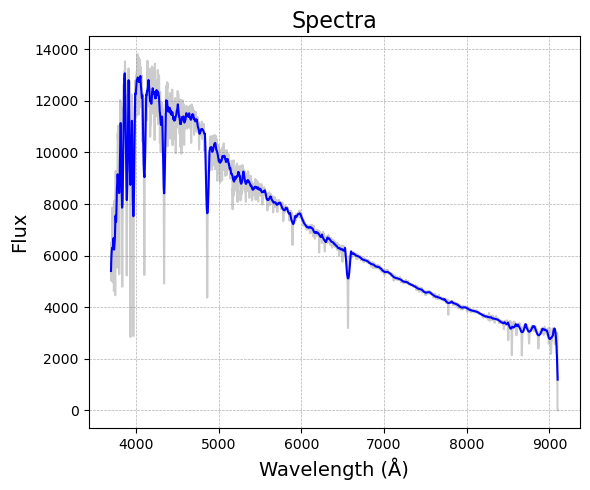

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
271973  f86c260e-0837-514c-a141-b64151aab0c3    407444   

                        asassn_name other_names   raj2000   dej2000  \
271973  ASASSN-VJ150012.86-625401.5      ES Cir  225.0536 -62.90042   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
271973  2.457567e+06  5.874413e+18  J150012.93-625403.2    49610436.0   

                  edr3_source_id galex_id         tic_id  
271973  EDR3 5874412523819015808      NaN  TIC 298112357   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
271973       0.61  0.101565            0.03       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
271973      11.01        10.921667           0.008164         11.095573   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
271973  

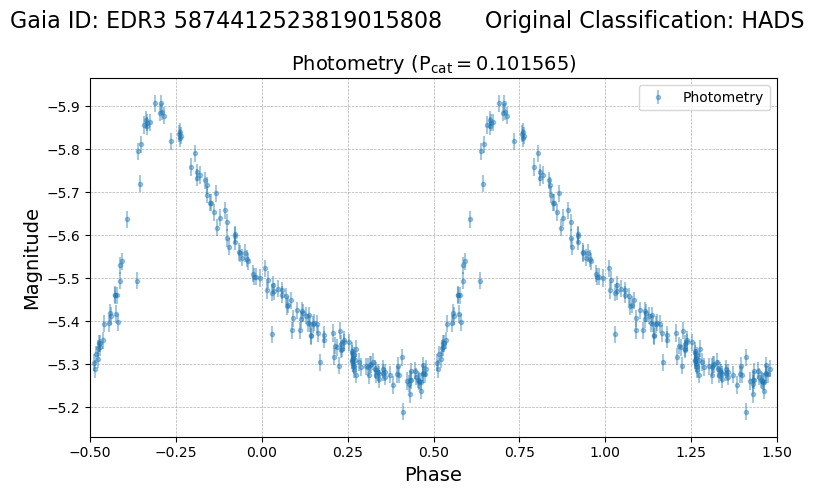

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
195406  3ca0ad5c-47b8-5637-8608-d36b51a64939    181945   

                        asassn_name          other_names    raj2000   dej2000  \
195406  ASASSN-VJ111722.94-135301.1  ASAS J111723-1353.0  169.34557 -13.88363   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
195406  2.457329e+06  3.564646e+18  J111722.89-135301.1    26406693.0   

                  edr3_source_id                galex_id         tic_id  
195406  EDR3 3564645662509811200  GALEX J111722.9-135300  TIC 421152005   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
195406       0.22  0.08949            0.23       0.88 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
195406      11.98        11.974681           0.005021         12.123258   

        e_phot_bp_mean_mag  phot_rp_me

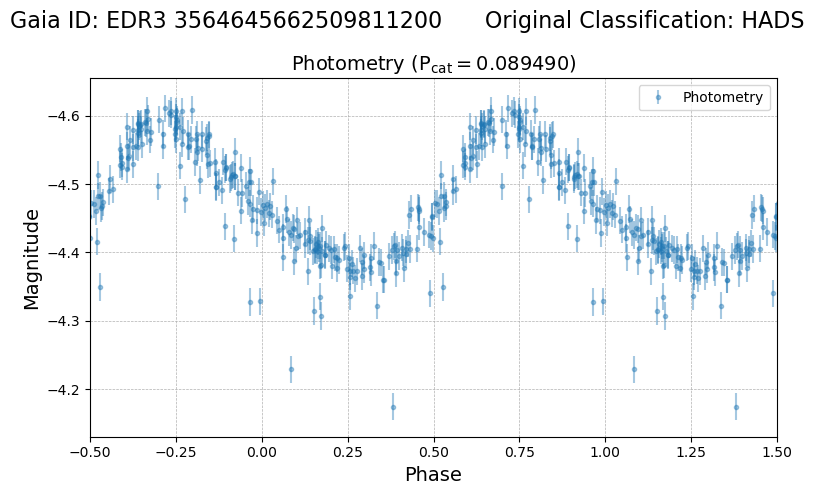

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
445306  46d28e62-5419-5031-9fdf-6366a10a1d96  AP31243981   

                        asassn_name             other_names   raj2000  \
445306  ASASSN-VJ203814.02-033046.7  ATLASJ309.5584-03.5129  309.5584   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
445306 -3.51296  2.457266e+06  4.224613e+18  J203814.02-033046.6   

        apass_dr9_id            edr3_source_id                galex_id  \
445306    31243981.0  EDR3 4224612643612459776  GALEX J203814.0-033046   

               tic_id  
445306  TIC 248088175   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
445306       0.18  0.075367            0.38       0.81 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
445306      11.62        11.560082           0.003871         11.712068   

        e

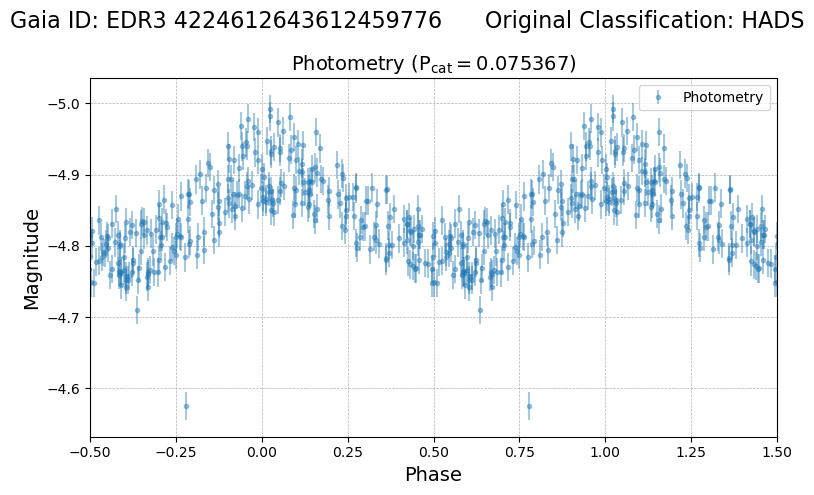

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
429204  25177712-dbfd-52ba-a624-0f82f1ddc15b     80513   

                        asassn_name          other_names    raj2000   dej2000  \
429204  ASASSN-VJ071426.75-690735.8  ASAS J071427-6907.6  108.61147 -69.12661   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
429204  2.458125e+06  5.268342e+18  J071426.60-690736.0    39355527.0   

                  edr3_source_id galex_id         tic_id  
429204  EDR3 5268341545385457152      NaN  TIC 300139147   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
429204       0.17  0.096469             0.3       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
429204      11.39        11.331357           0.003866         11.574255   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

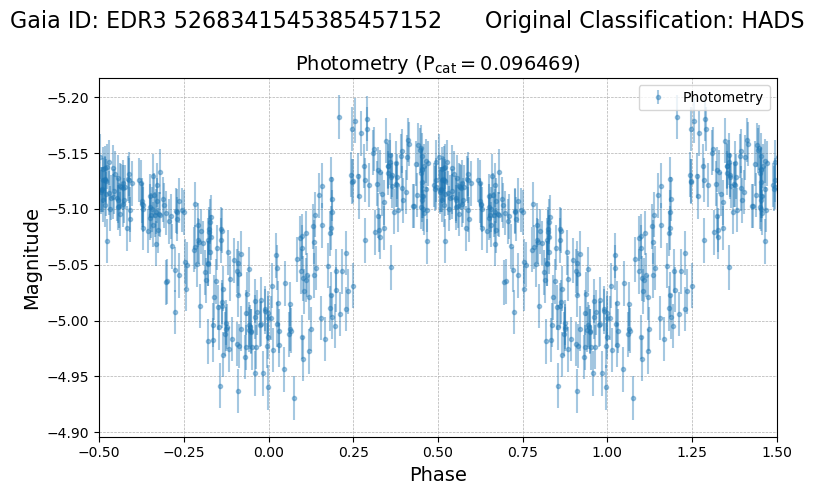

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
370120  6b4a53a6-9cd5-5ac8-9fbe-824b57caa4b5  AP19496824   

                        asassn_name other_names   raj2000   dej2000  \
370120  ASASSN-VJ063524.28-110448.9         NaN  98.85115 -11.08025   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
370120  2.457458e+06  3.001814e+18  J063524.27-110448.8    19496824.0   

                  edr3_source_id galex_id        tic_id  
370120  EDR3 3001813807809279488      NaN  TIC 25642774   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
370120       0.25  0.110781            0.22       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
370120      11.17        11.098313           0.004637         11.294748   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
370120

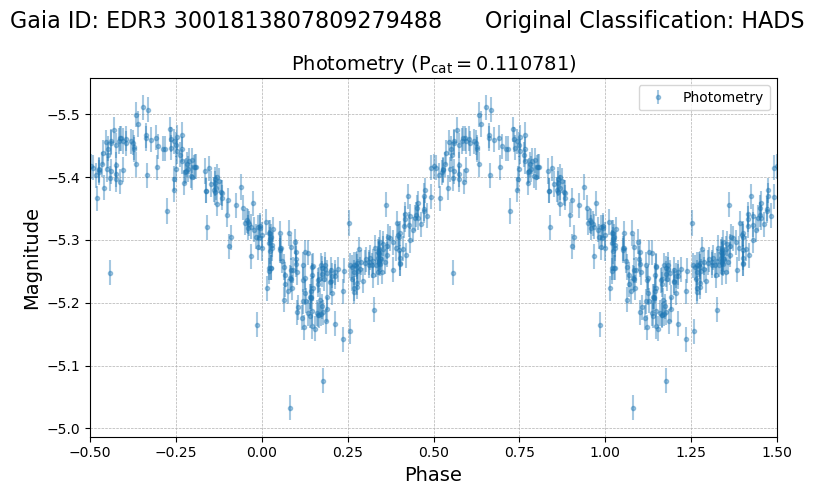

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
370121  3927bb9d-251c-5a59-a8d0-65d6d3033481  AP51232510   

                        asassn_name other_names    raj2000   dej2000  \
370121  ASASSN-VJ163912.66-514737.2         NaN  249.80276 -51.79366   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
370121  2.457894e+06  5.931214e+18  J163912.63-514737.6    51232510.0   

                  edr3_source_id galex_id        tic_id  
370121  EDR3 5931214462799925760      NaN  TIC 34889574   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
370121       0.22  0.171013            0.22       0.88 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
370121      11.65        11.527964            0.00405         11.796275   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
3701

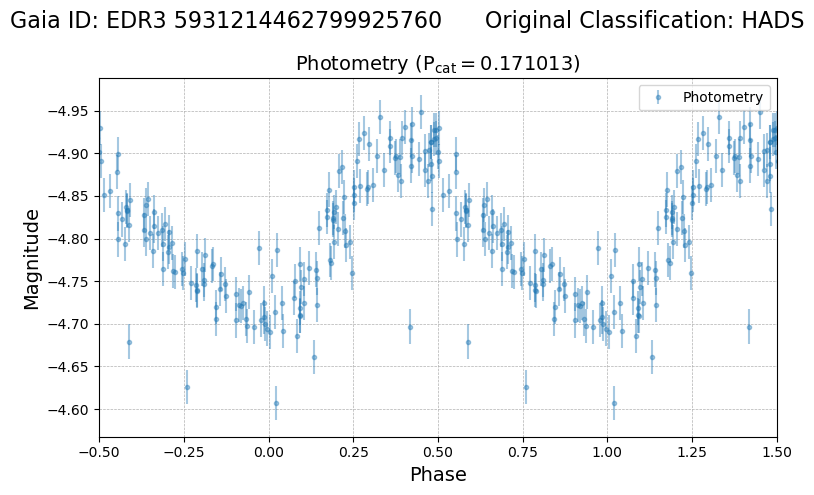

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                         id  source_id  \
3673  e5cfedaf-356d-5f28-80bf-d3ad68fb6de2  AP7462688   

                      asassn_name             other_names    raj2000  \
3673  ASASSN-VJ065305.78+702131.0  ATLASJ103.2740+70.3586  103.27408   

       dej2000     epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
3673  70.35861  2.457837e+06  1.112533e+18  J065305.76+702130.9     7462688.0   

                edr3_source_id                galex_id         tic_id  
3673  EDR3 1112532972186053376  GALEX J065305.8+702130  TIC 456294741   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
       amplitude    period  lksl_statistic  rfr_score
3673       0.17  0.171659            0.08       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
      mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
3673       11.8        11.752061           0.003478         12.034863   

      e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

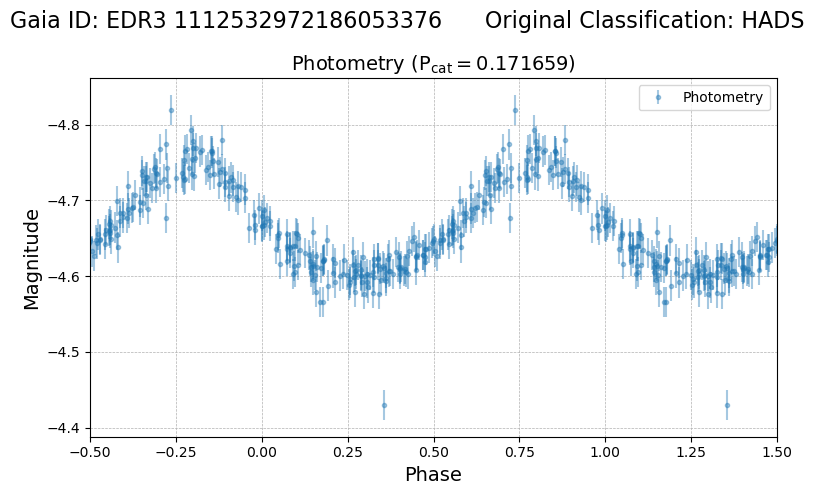

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
254916  797be095-c3b9-5ba1-a784-a72686f060ca     73301   

                        asassn_name other_names    raj2000   dej2000  \
254916  ASASSN-VJ183206.33+403556.4   V0593 Lyr  278.02636  40.59901   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
254916  2.457622e+06  2.110335e+18  J183206.43+403556.4    14510452.0   

                  edr3_source_id                galex_id         tic_id  
254916  EDR3 2110335067109433472  GALEX J183206.4+403556  TIC 289325437   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
254916       0.56  0.102151            0.01        1.0 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
254916      12.36        12.353205           0.010164         12.479681   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

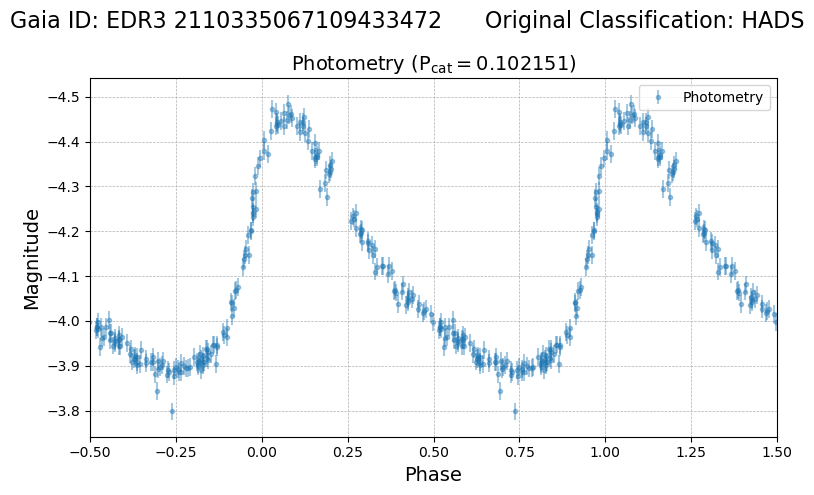

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
553024  1abea46a-8546-54e1-892f-a98152a258c8  AP17551207   

                        asassn_name             other_names   raj2000  \
553024  ASASSN-VJ230357.22+090528.4  ATLASJ345.9883+09.0912  345.9884   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
553024  9.09121  2.458005e+06  2.713948e+18  J230357.21+090528.3   

        apass_dr9_id            edr3_source_id                galex_id  \
553024    17551207.0  EDR3 2713947610519754112  GALEX J230357.1+090528   

               tic_id  
553024  TIC 344144930   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
553024       0.16  0.115846            0.46       0.78 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
553024      12.14         12.10916           0.003899         12.305203   

        e

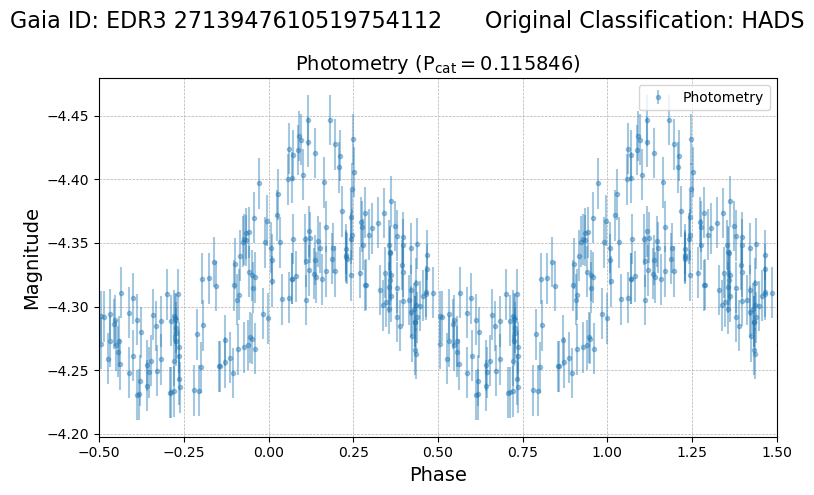

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
260672  9d039153-2ef5-5354-bd9f-7efd7d06ed92     74937   

                        asassn_name          other_names   raj2000   dej2000  \
260672  ASASSN-VJ110239.38-442357.2  ASAS J110239-4423.9  165.6641 -44.39923   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
260672  2.457132e+06  5.387366e+18  J110239.43-442357.0    41698481.0   

                  edr3_source_id galex_id         tic_id  
260672  EDR3 5387365981196492544      NaN  TIC 178616716   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
260672        0.3  0.102421            0.05       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
260672      11.99        11.945738           0.004353         12.139544   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    

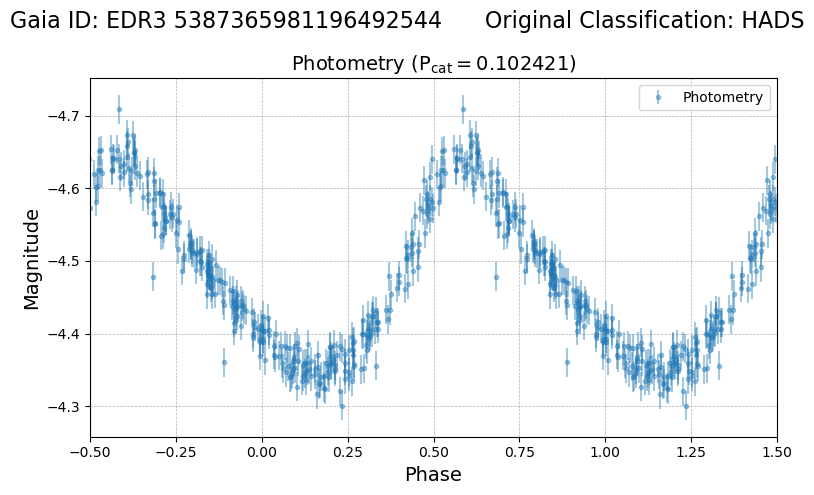

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
482373  9b6e5bb5-693c-528d-ac48-012c6c90a68f  AP13755286   

                        asassn_name             other_names    raj2000  \
482373  ASASSN-VJ190736.20+280237.3  ATLASJ286.9009+28.0437  286.90083   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
482373  28.0437  2.458334e+06  2.037422e+18  J190736.21+280237.4   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
482373    13755286.0  EDR3 2037422366570691328      NaN  TIC 451788436   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
482373       0.15  0.156288            0.38       0.83 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
482373      12.04        11.924425           0.003365          12.18855   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

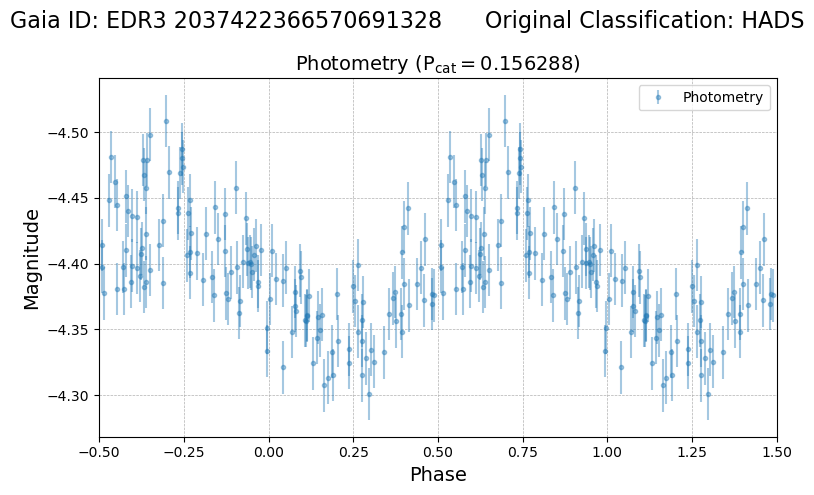

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
76525  c3b31394-31f5-5a8b-b96b-4fa9ef7ace0a    270410   

                       asassn_name      other_names    raj2000  dej2000  \
76525  ASASSN-VJ230141.84+420252.8  TYC 3224-2602-1  345.42434   42.048   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
76525  2.457165e+06  1.931168e+18  J230141.76+420252.6    11672278.0   

                 edr3_source_id galex_id         tic_id  
76525  EDR3 1931168449069465216      NaN  TIC 155005957   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
76525       0.19  0.088664            0.11       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
76525      11.66         11.63866           0.003553         11.827775   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
76525      

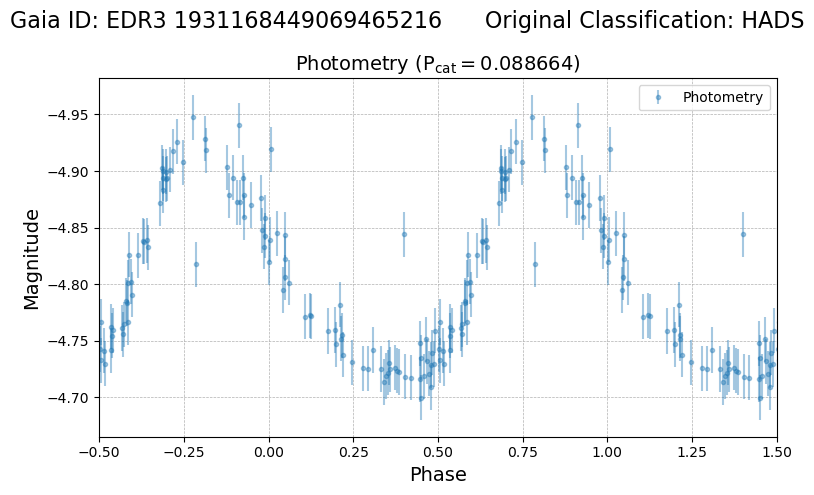

spec-56616-HD231029N411918V01_sp14-207.fits.gz


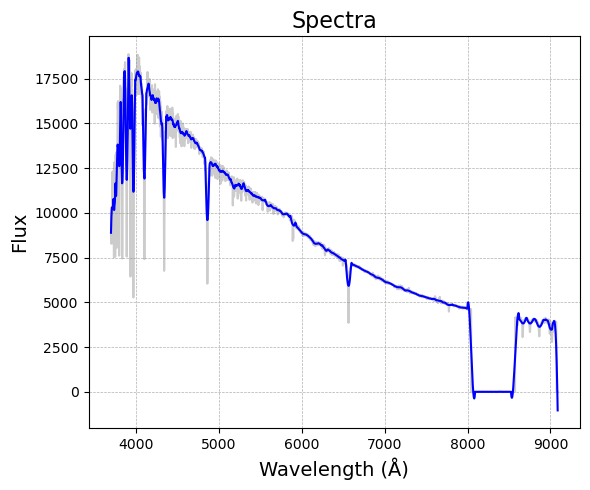

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
553870  6a680ccd-8040-52a2-b7d3-a91852707bfa  AP4911702   

                        asassn_name           other_names   raj2000   dej2000  \
553870  ASASSN-VJ014345.89+771841.3  WISEJ014345.8+771841  25.94121  77.31148   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
553870  2.456908e+06  5.605949e+17  J014345.87+771841.3     4911702.0   

                 edr3_source_id galex_id         tic_id  
553870  EDR3 560594936954552576      NaN  TIC 395392756   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
553870       0.32  0.178756            0.07       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
553870      12.53        12.505174           0.006403         12.858081   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

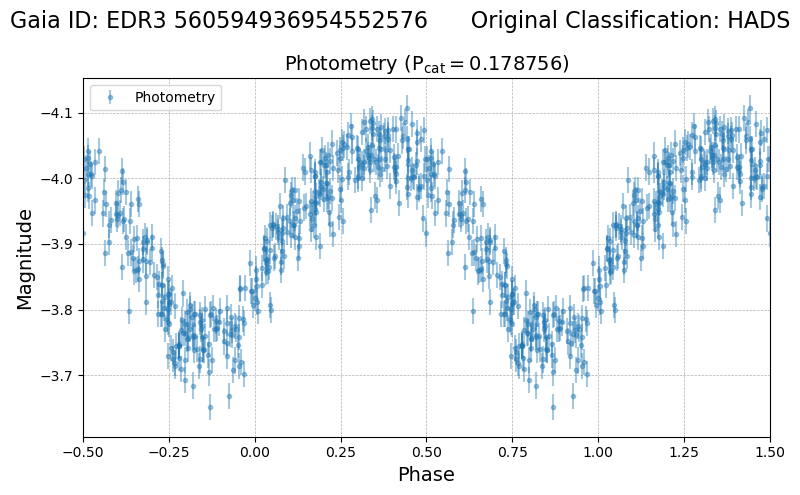

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
206130  983b5aff-ed92-5dd4-b2c7-5069fa1e9db5     82879   

                        asassn_name          other_names    raj2000   dej2000  \
206130  ASASSN-VJ175837.07-602021.3  ASAS J175837-6020.4  269.65447 -60.33925   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
206130  2.456882e+06  5.911730e+18  J175836.98-602021.8    50691008.0   

                  edr3_source_id                galex_id         tic_id  
206130  EDR3 5911729536119333632  GALEX J175837.0-602021  TIC 380780063   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
206130       0.25  0.105604            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
206130      11.38        11.366982           0.005141         11.523394   

        e_phot_bp_mean_mag  phot_rp_

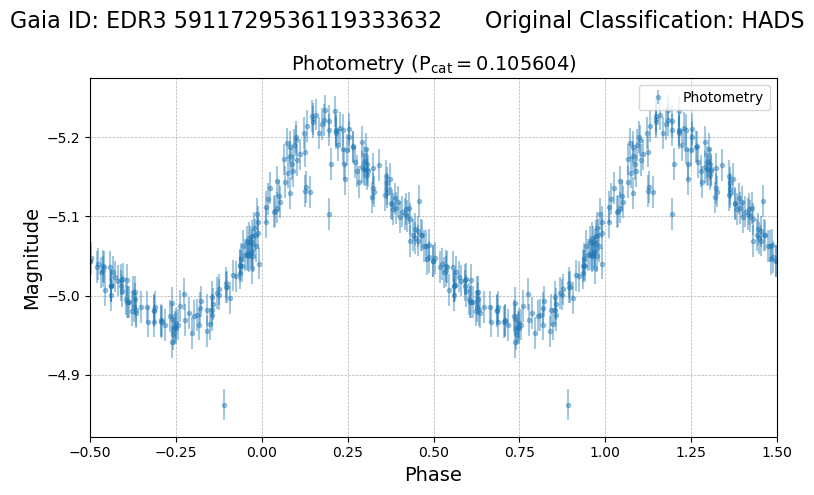

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
236382  fc7e3661-e316-52ac-b1a9-88015a2287c0    247761   

                        asassn_name other_names    raj2000  dej2000  \
236382  ASASSN-VJ192227.39-562227.5   V0388 Tel  290.61411 -56.3743   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
236382  2.457924e+06  6.640099e+18  J192227.39-562228.3    58502563.0   

                  edr3_source_id                galex_id         tic_id  
236382  EDR3 6640099227226634368  GALEX J192227.4-562230  TIC 360736543   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
236382       0.22  0.14909             0.4        0.8 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
236382      11.86        11.821646           0.004992         11.994349   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

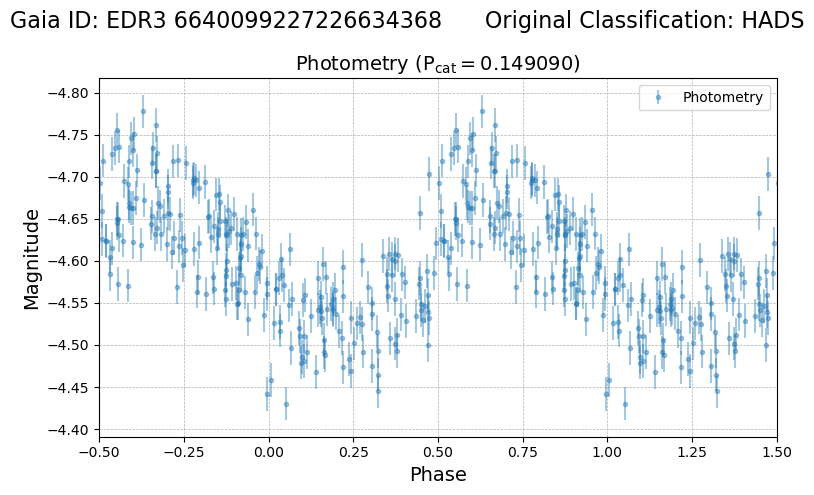

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
236401  93a7a743-5c79-50ed-bffe-a310c830f69a    180956   

                        asassn_name other_names    raj2000   dej2000  \
236401  ASASSN-VJ195316.65+203342.9   V0494 Vul  298.31938  20.56193   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
236401  2.457078e+06  1.826333e+18  J195316.61+203342.9    10478428.0   

                  edr3_source_id galex_id         tic_id  
236401  EDR3 1826332695470212992      NaN  TIC 301065481   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
236401       0.22  0.135713            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
236401      12.17        12.126327           0.004483         12.429276   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
236401

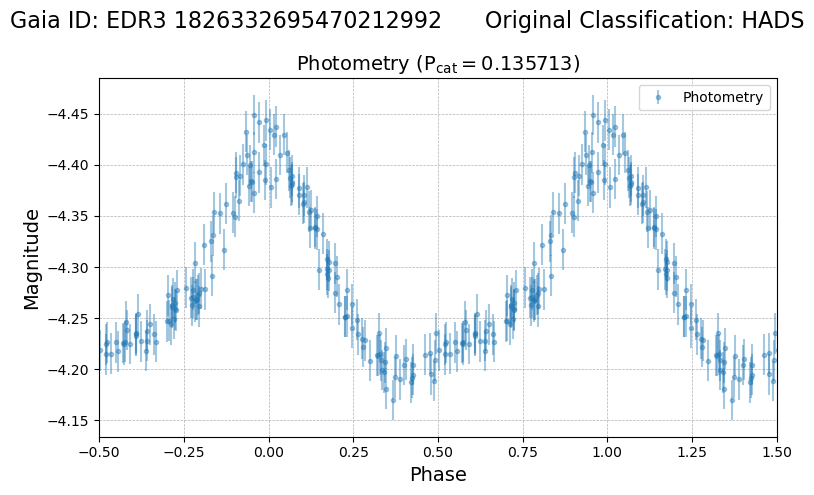

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
520357  a0faf208-8a48-5423-861f-0b2b494774c9  AP24263094   

                        asassn_name             other_names   raj2000  \
520357  ASASSN-VJ055624.86+164839.7  ATLASJ089.1036+16.8110  89.10359   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
520357  16.81102  2.458003e+06  3.349766e+18  J055624.87+164839.7   

        apass_dr9_id            edr3_source_id galex_id        tic_id  
520357    24263094.0  EDR3 3349766318388949632      NaN  TIC 92017453   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
520357       0.24  0.113363            0.02       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
520357      11.69        11.592441           0.004923         11.823422   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

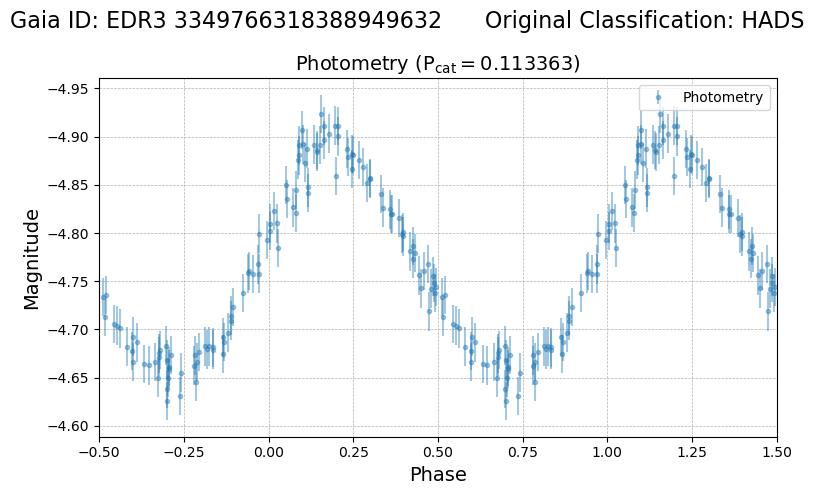

spec-56292-GAC089N16V1_sp04-045.fits.gz


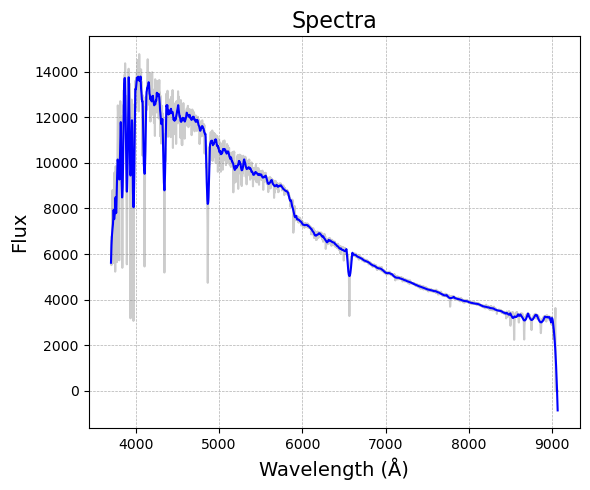

In [94]:
for name in eb_out_names:
    plot_photometry_flux(name)

# Only meta outliers

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
552510  9af306aa-c81e-5d5a-b498-0d9f7cac0039  AP5080168   

                        asassn_name             other_names    raj2000  \
552510  ASASSN-VJ085346.83+050547.4  ATLASJ133.4451+05.0965  133.44512   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
552510   5.0965  2.457049e+06  5.819709e+17  J085346.83+050547.3   

        apass_dr9_id           edr3_source_id                galex_id  \
552510     5080168.0  EDR3 581970890402681344  GALEX J085346.8+050547   

               tic_id  
552510  TIC 265340465   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
552510       0.15  0.17224            0.21        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
552510      12.22          12.0915           0.003693          12.33967   

        e_pho

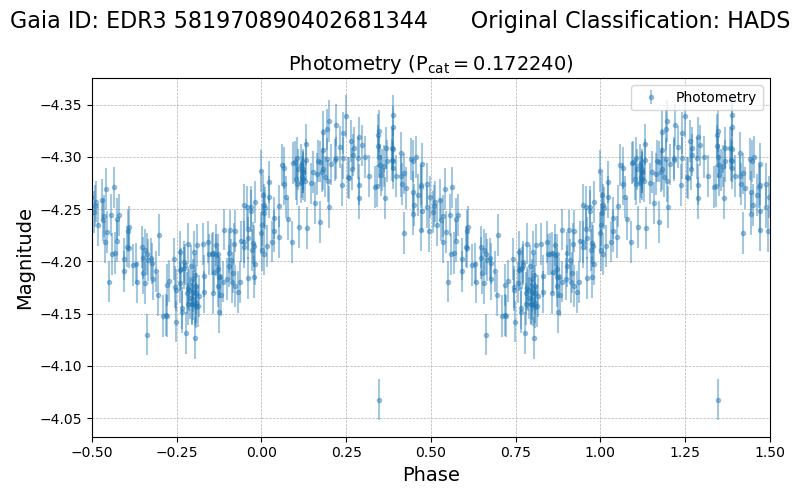

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
496619  590e1b83-6329-5701-986b-7057ea7b9b0a  AP38014623   

                        asassn_name           other_names    raj2000  \
496619  ASASSN-VJ112926.06-790251.3  WISEJ112926.0-790251  172.35859   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
496619 -79.04757  2.457727e+06  5.199884e+18  J112926.10-790251.3   

        apass_dr9_id            edr3_source_id                galex_id  \
496619    38014623.0  EDR3 5199883580619777408  GALEX J112926.3-790251   

               tic_id  
496619  TIC 356591030   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
496619       0.15  0.096493            0.36       0.82 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
496619      12.84        12.538057           0.003317         12.994687   

        e

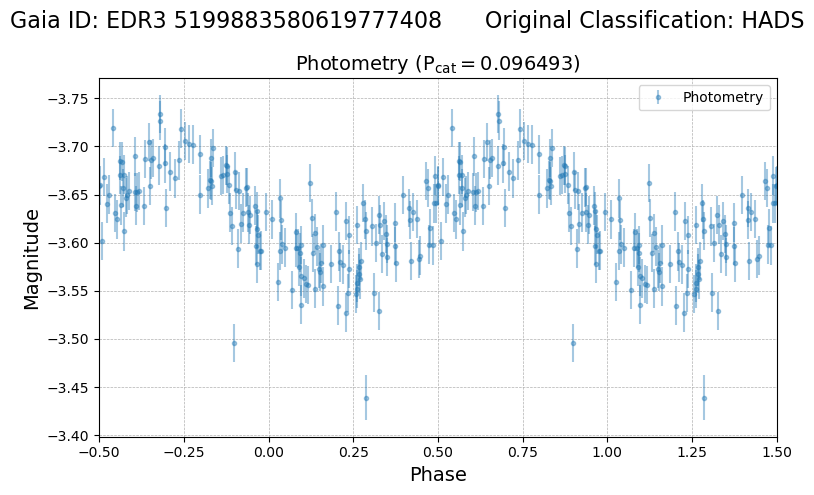

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
502985  093bbd01-b331-5aeb-83ed-f3b91e6ac129  AP35032339   

                        asassn_name other_names    raj2000   dej2000  \
502985  ASASSN-VJ183947.11+112537.8         NaN  279.94629  11.42716   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
502985  2.457820e+06  4.504784e+18  J183947.13+112537.7    35032339.0   

                  edr3_source_id galex_id         tic_id  
502985  EDR3 4504783633922108288      NaN  TIC 379761888   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
502985       0.15  0.110788             0.6        0.7 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
502985      11.02        10.633619           0.002758         11.257566   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
50

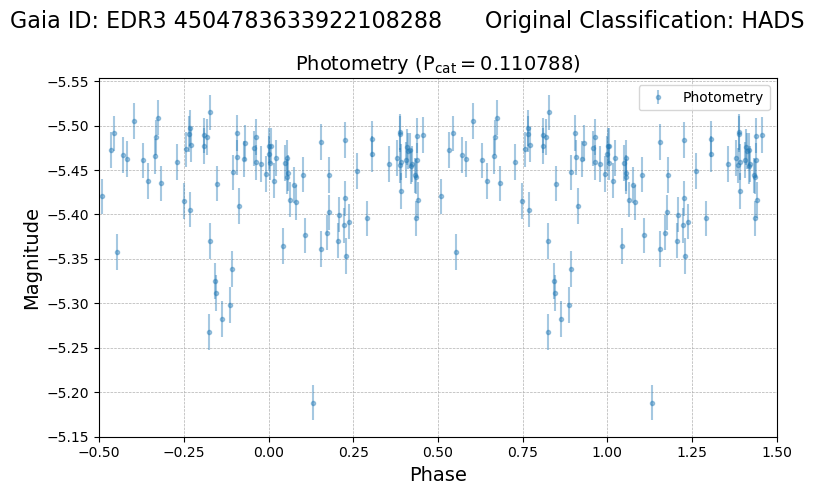

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
167474  d3e76b6d-1c26-5e4e-9bd4-1fca1441c7f5    333257   

                        asassn_name           other_names   raj2000   dej2000  \
167474  ASASSN-VJ025010.30+495506.6  VSX J025010.2+495507  42.54292  49.91851   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
167474  2.457630e+06  4.387881e+17  J025010.30+495507.4     3554631.0   

                 edr3_source_id                galex_id         tic_id  
167474  EDR3 438788053830490496  GALEX J025010.2+495508  TIC 428115612   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
167474       0.16  0.072972            0.09       0.96 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
167474      11.95        11.748013           0.003499         12.159132   

        e_phot_bp_mean_mag  phot_rp_me

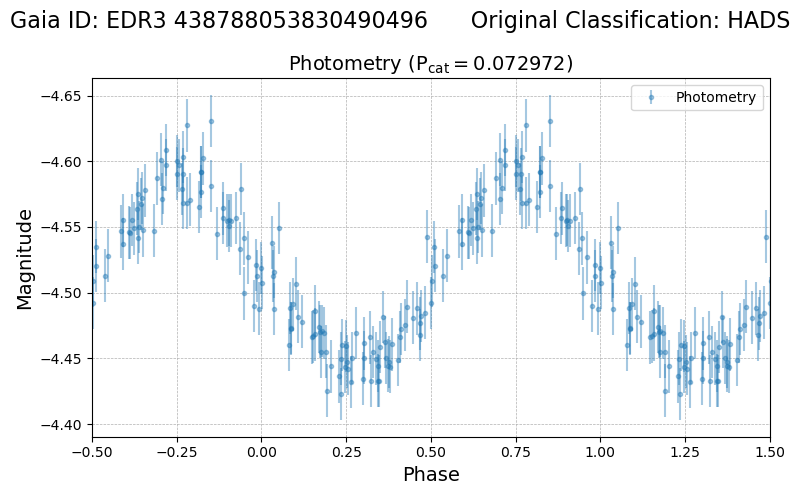

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
469644  7c0a0fae-ddb3-5dd6-8aa6-d8bf058414b1  AP36435694   

                        asassn_name other_names   raj2000   dej2000  \
469644  ASASSN-VJ011825.42-695140.2         NaN  19.60592 -69.86118   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
469644  2.458097e+06  4.690991e+18  J011825.39-695140.6    36435694.0   

                  edr3_source_id                galex_id        tic_id  
469644  EDR3 4690991180799807616  GALEX J011825.3-695140  TIC 52205980   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
469644       0.38  0.143315            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
469644      13.33        13.219604           0.007158         13.586552   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

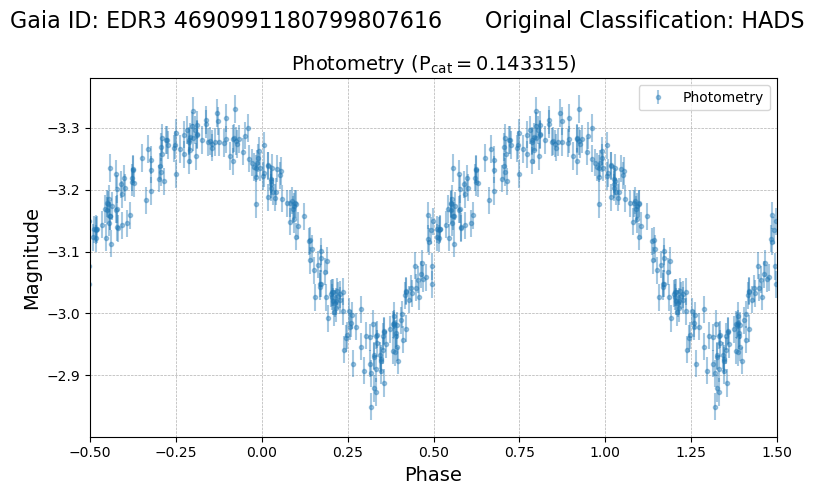

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
212074  39e51859-8ef0-5938-8429-917db4dd86f1    135048   

                        asassn_name other_names   raj2000   dej2000  \
212074  ASASSN-VJ045346.49+682826.1   V0542 Cam  73.44369  68.47391   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
212074  2.457274e+06  4.959963e+17  J045346.55+682826.3     4185979.0   

                 edr3_source_id galex_id         tic_id  
212074  EDR3 495996262296263552      NaN  TIC 281695001   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
212074       0.39  0.133985            0.44       0.79 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
212074      11.56        11.622709           0.005099         11.876186   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
212074    

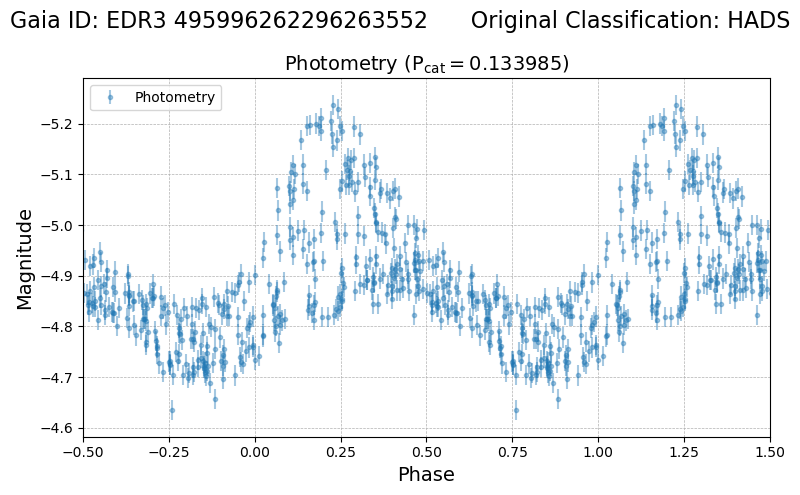

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
281658  751a18d7-0dc8-5ee0-8a83-f4da009e3f05    122597   

                        asassn_name          other_names   raj2000   dej2000  \
281658  ASASSN-VJ052705.65-833442.3  ASAS J052707-8334.7  81.77354 -83.57841   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
281658  2.457405e+06  4.614777e+18  J052705.66-833442.2    36022342.0   

                  edr3_source_id                galex_id         tic_id  
281658  EDR3 4614776676894701440  GALEX J052705.9-833442  TIC 261089835   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
281658       0.29  0.089645            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
281658      11.95        11.915108           0.005017          12.17929   

        e_phot_bp_mean_mag  phot_rp_me

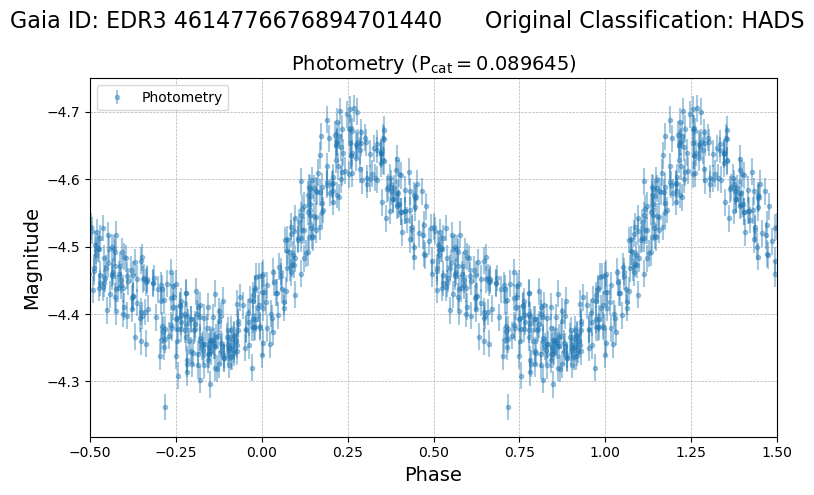

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
63564  e7e3f318-4577-53d3-8838-666790bca684     59264   

                       asassn_name          other_names    raj2000  dej2000  \
63564  ASASSN-VJ072307.17-543640.0  ASAS J072307-5436.7  110.77989 -54.6111   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
63564  2.457480e+06  5.490666e+18  J072307.13-543638.0    42953672.0   

                 edr3_source_id galex_id         tic_id  
63564  EDR3 5490666473015124992      NaN  TIC 339675323   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
63564       0.23  0.134299            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
63564      11.64        11.609256           0.005052            11.833   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
635

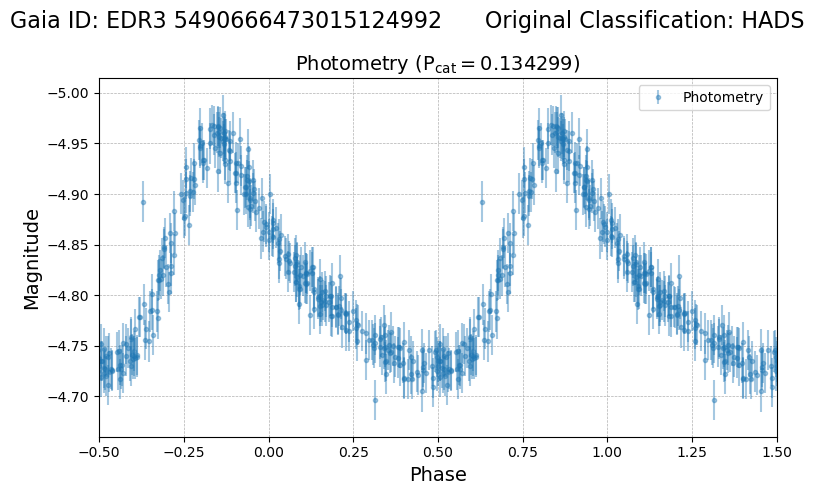

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
553865  5a81e66c-2b76-5421-96e5-4b5a69034d00  AP20948500   

                        asassn_name             other_names    raj2000  \
553865  ASASSN-VJ075232.24+040936.8  ATLASJ118.1325+04.1606  118.13432   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
553865  4.16021  2.457285e+06  3.089364e+18  J075232.50+040935.4   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
553865    20948500.0  EDR3 3089363692479514368      NaN  TIC 266325767   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
553865       0.18  0.176142            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
553865      12.79        12.992188           0.002762         13.545893   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

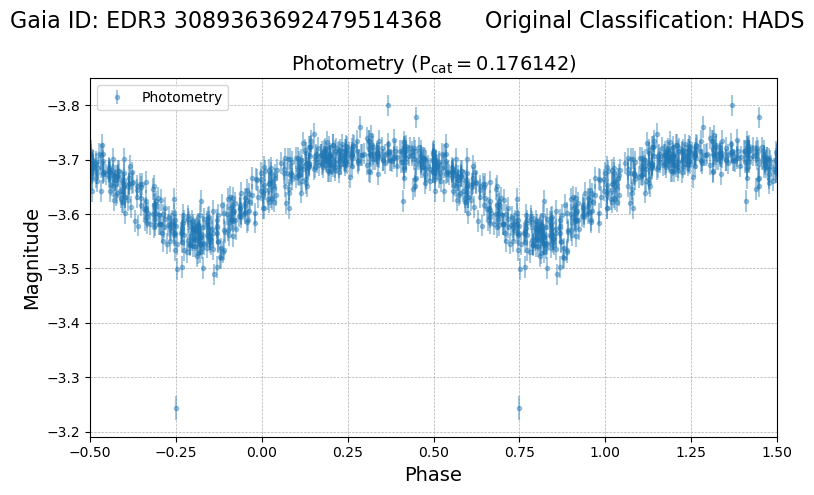

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
647481  9b47e1e8-8d61-5b99-89e1-64b2bdab789e    212769   

                        asassn_name other_names    raj2000   dej2000  \
647481  ASASSN-VJ205231.01+705440.1   V0973 Cep  313.12919  70.91115   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
647481  2.458038e+06  2.271867e+18  J205231.09+705440.5    16068634.0   

                  edr3_source_id                galex_id         tic_id  
647481  EDR3 2271866764182945664  GALEX J205231.1+705440  TIC 387627109   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
647481       0.39  0.080631            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
647481       12.4        12.258859           0.006491         12.562423   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_r

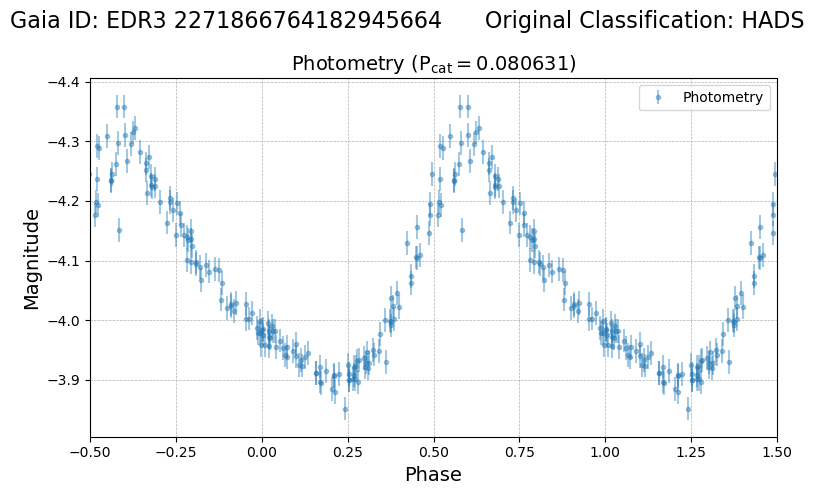

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
643151  6ed839e0-47e1-5aa6-ba89-8ed9fa25d58c  AP15810710   

                        asassn_name other_names    raj2000   dej2000  \
643151  ASASSN-VJ235620.91+751611.2         NaN  359.08713  75.26979   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
643151  2.457695e+06  2.232283e+18  J235620.89+751611.3    15810710.0   

                  edr3_source_id                galex_id         tic_id  
643151  EDR3 2232282799396329088  GALEX J235620.9+751611  TIC 406679287   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
643151       0.28  0.103017            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
643151      12.07        11.892228           0.005164         12.185647   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_ph

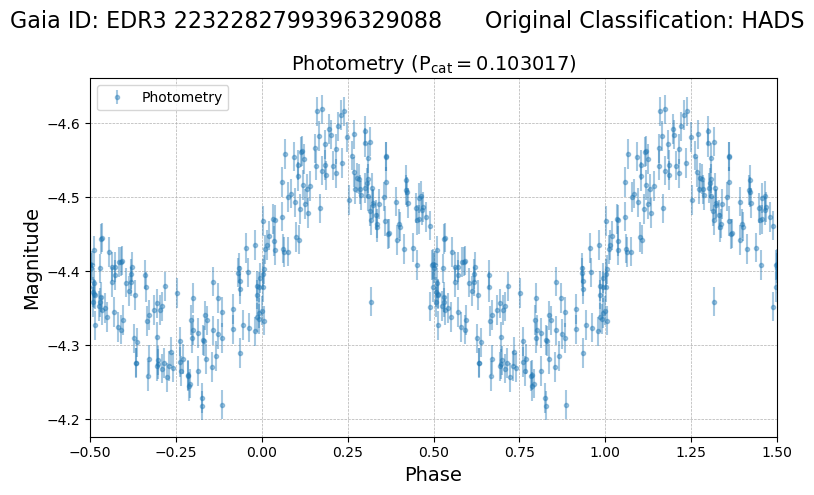

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
393093  20ecc0a4-3051-5353-b792-643141b575e3    145082   

                        asassn_name          other_names   raj2000   dej2000  \
393093  ASASSN-VJ061729.04-120252.0  ASAS J061729-1202.9  94.37098 -12.04779   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
393093  2.458153e+06  3.000754e+18  J061729.01-120251.7    19485149.0   

                  edr3_source_id galex_id        tic_id  
393093  EDR3 3000753981676048384      NaN  TIC 34137913   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
393093        0.4  0.076152            0.09       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
393093      12.43        12.252181           0.008996         12.507035   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     b

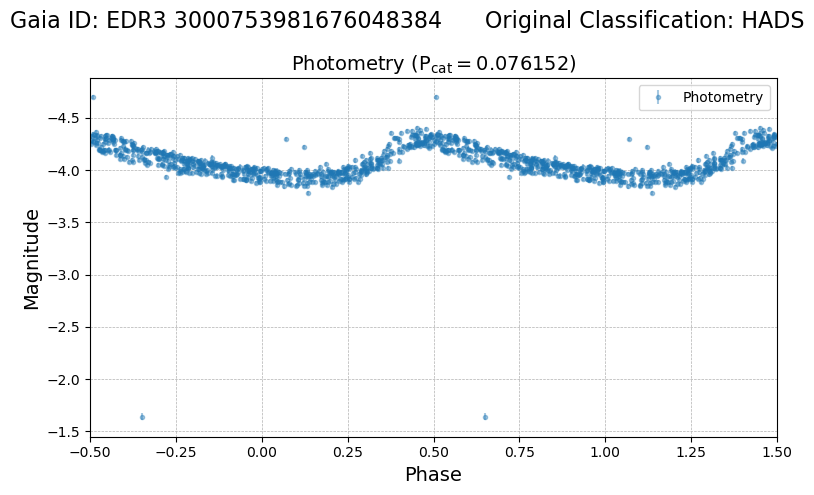

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
683488  8c218206-3e0c-5452-9eae-81744998518f  AP56673755   

                        asassn_name             other_names    raj2000  \
683488  ASASSN-VJ141435.82-250734.5  ATLASJ213.6492-25.1262  213.64926   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
683488 -25.12626  2.457826e+06  6.271233e+18  J141435.82-250734.5   

        apass_dr9_id            edr3_source_id                galex_id  \
683488    56673755.0  EDR3 6271232966098213120  GALEX J141435.8-250734   

             tic_id  
683488  TIC 7555359   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
683488       0.15  0.081507            0.22       0.89 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
683488      12.64        12.506683            0.00392         12.779035   

        e

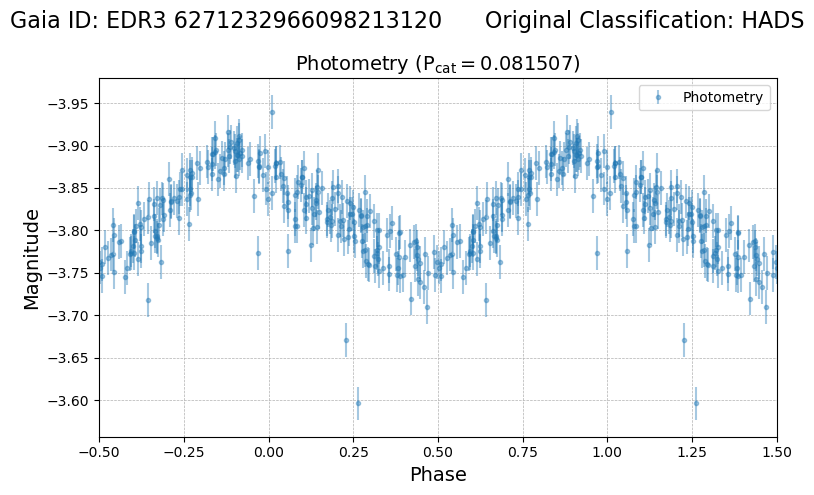

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
185621  7a84ea75-581e-5ef5-86f5-9c6996347960    285681   

                        asassn_name          other_names    raj2000  dej2000  \
185621  ASASSN-VJ073032.38-004940.3  ASAS J073032-0049.7  112.63493 -0.82785   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
185621  2.457107e+06  3.062324e+18  J073032.42-004940.2    20563247.0   

                  edr3_source_id galex_id        tic_id  
185621  EDR3 3062323609176979712      NaN  TIC 65150594   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
185621       0.18  0.12944            0.35       0.83 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
185621      11.29        11.251578           0.004903          11.42204   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_

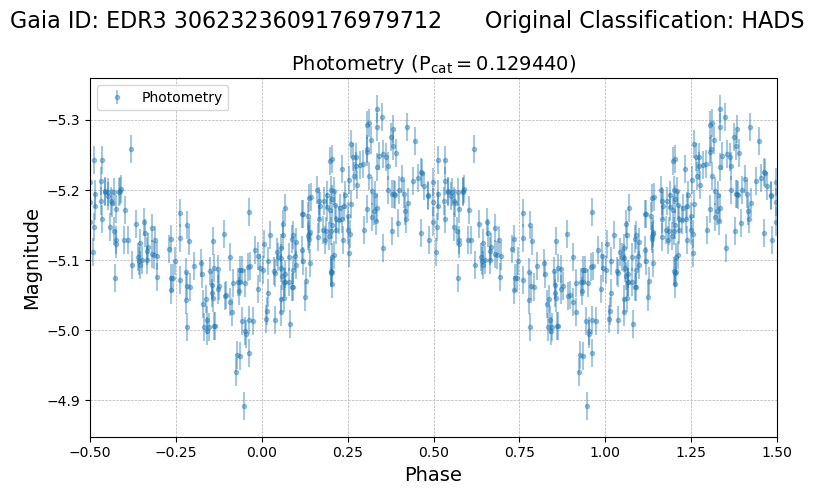

spec-58068-HD073149N010954V01_sp01-046.fits.gz


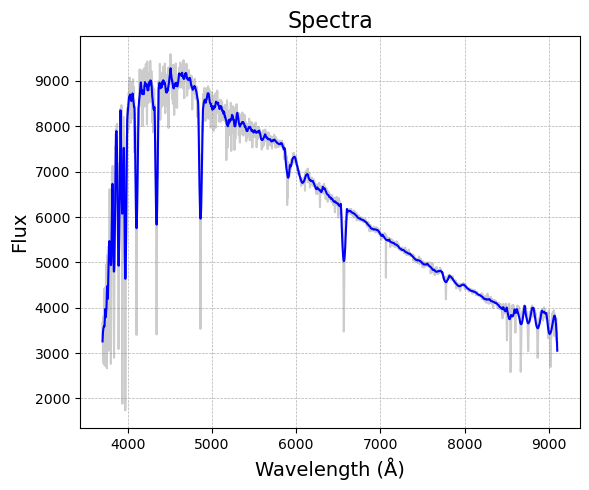

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
423388  5e1b079f-64fb-5831-b7df-22b32aa64363  AP59115372   

                        asassn_name other_names   raj2000   dej2000  \
423388  ASASSN-VJ183738.86-491036.6         NaN  279.4119 -49.17684   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
423388  2.457223e+06  6.703880e+18  J183738.86-491036.6    59115372.0   

                  edr3_source_id                galex_id         tic_id  
423388  EDR3 6703880277548075520  GALEX J183738.9-491036  TIC 200172725   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
423388       0.15  0.066417            0.17       0.92 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
423388       11.8        11.752745           0.003825          12.01852   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

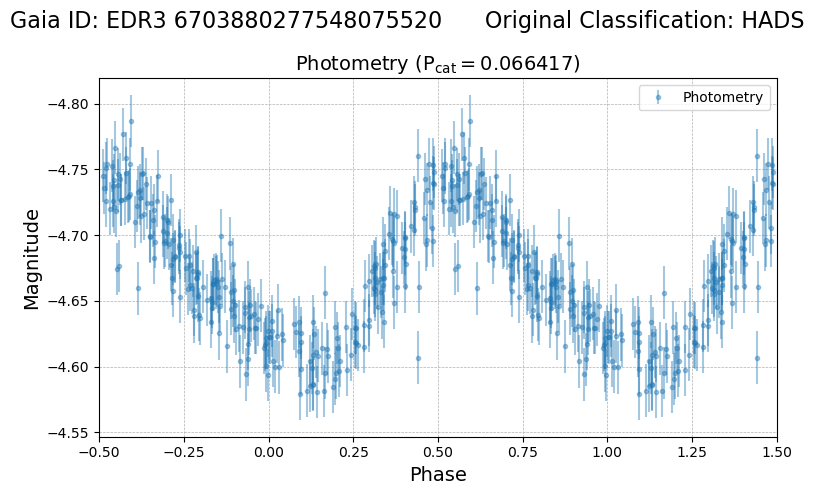

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
686533  58870a73-f75a-5499-9cac-24768410bf7b    201022   

                        asassn_name          other_names   raj2000  dej2000  \
686533  ASASSN-VJ062541.57+220620.2  ASAS J062542+2206.4  96.42322  22.1056   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
686533  2.457308e+06  3.376353e+18  J062541.59+220619.5    24786961.0   

                  edr3_source_id galex_id         tic_id  
686533  EDR3 3376353162381244544      NaN  TIC 430147460   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
686533       0.39  0.117308            0.36       0.81 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
686533      12.36        12.289309           0.009538         12.526709   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     b

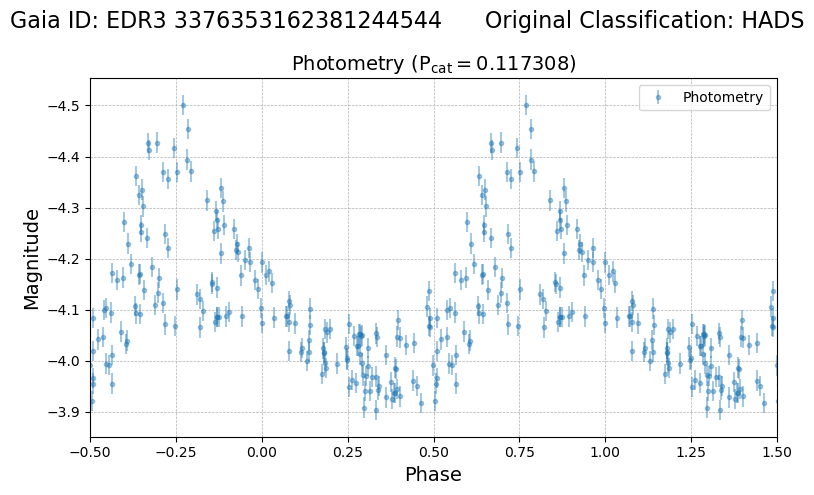

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
577830  7055ee50-e579-5dce-bf0e-84296c1cc20f    222068   

                        asassn_name  other_names    raj2000   dej2000  \
577830  ASASSN-VJ194938.38+405347.3  KIC 5641711  297.40992  40.89648   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
577830  2.457238e+06  2.073765e+18  J194938.39+405349.8    14120533.0   

                  edr3_source_id galex_id         tic_id  
577830  EDR3 2073765172933035008      NaN  TIC 169461359   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
577830       0.16  0.099805            0.62       0.66 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
577830      10.33        10.376393           0.002779         10.515593   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
5778

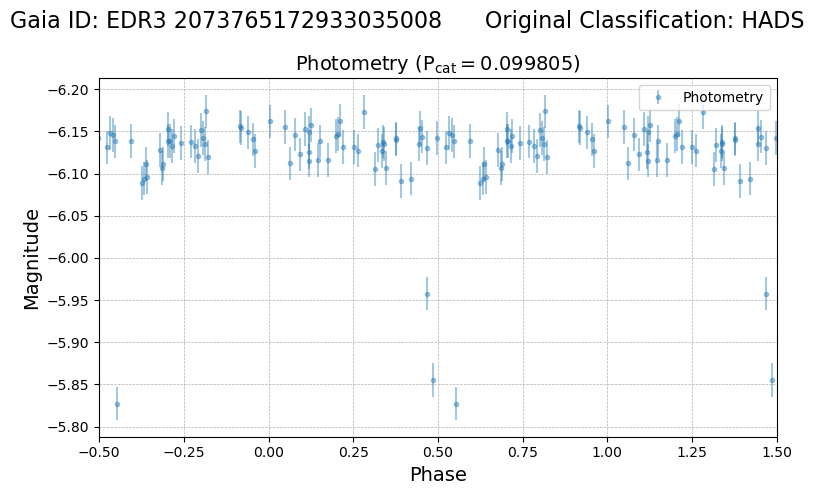

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
166319  7f14f583-fedb-547e-ba39-b8ebdacbc275    175358   

                        asassn_name          other_names    raj2000   dej2000  \
166319  ASASSN-VJ184743.83+231312.1  ASAS J184744+2313.2  281.93262  23.22002   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
166319  2.457883e+06  4.532485e+18  J184743.79+231312.0           NaN   

                  edr3_source_id galex_id         tic_id  
166319  EDR3 4532485039089757952      NaN  TIC 348217860   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
166319        0.2  0.098119            0.19       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
166319      11.27         11.18914           0.004073         11.407509   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

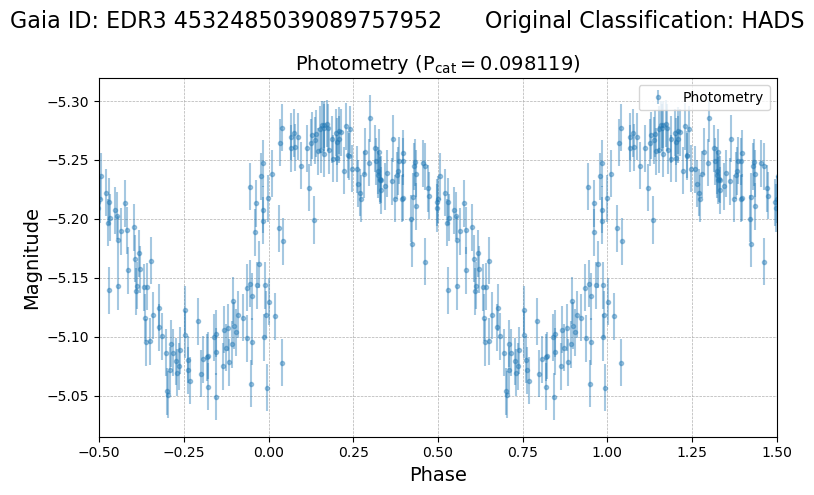

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
212164  163867ef-6a78-5a28-8099-4e824324e41e    430498   

                        asassn_name          other_names    raj2000   dej2000  \
212164  ASASSN-VJ074917.75-191119.6  ASAS J074918-1911.3  117.32397 -19.18878   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
212164  2.457688e+06  5.715897e+18  J074917.78-191119.0    46537799.0   

                  edr3_source_id galex_id         tic_id  
212164  EDR3 5715897268138370176      NaN  TIC 141457913   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
212164        0.3  0.105738             0.1       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
212164      12.28        12.190151           0.005427         12.413684   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

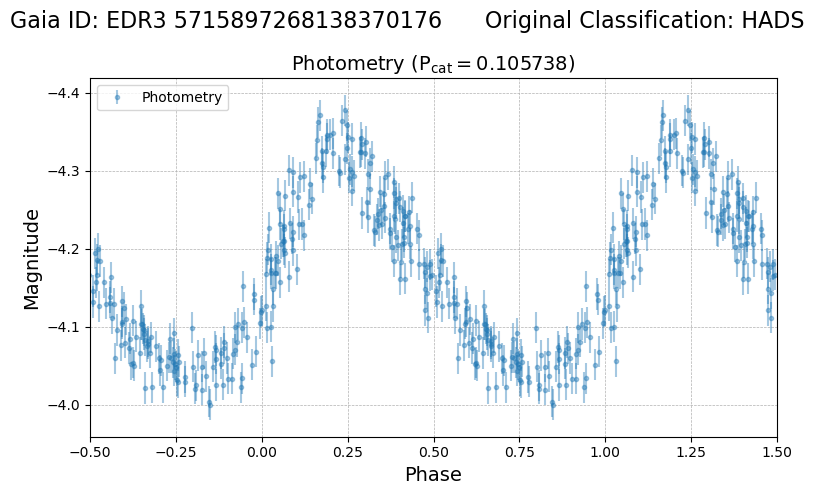

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
236450  04a5a217-1959-5f37-823c-ce9c60627d2d    382661   

                        asassn_name          other_names    raj2000  dej2000  \
236450  ASASSN-VJ090612.20-004808.6  ASAS J090612-0048.1  136.55085  -0.8024   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
236450  2.457437e+06  3.842713e+18  J090612.23-004808.9    27364004.0   

                  edr3_source_id                galex_id        tic_id  
236450  EDR3 3842713321408891776  GALEX J090612.2-004808  TIC 62628148   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
236450       0.21  0.120622            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
236450      12.44        12.402957           0.004927         12.571378   

        e_phot_bp_mean_mag  phot_rp_mean

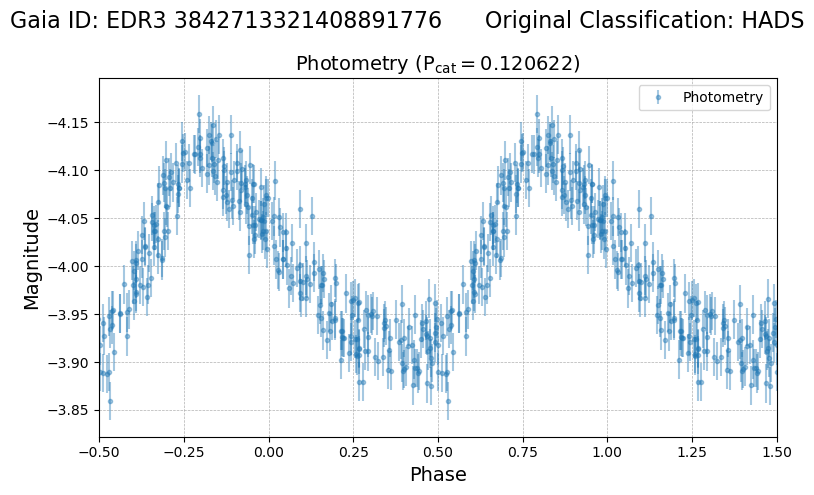

spec-57105-HD090135S000003V01_sp08-148.fits.gz


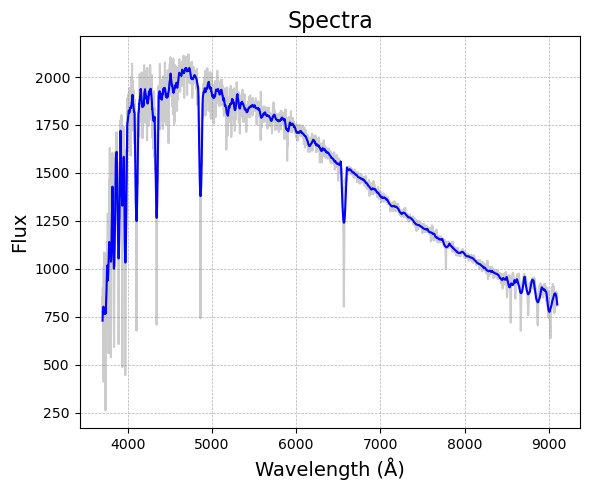

spec-56671-VB136N01V3_sp01-221.fits.gz


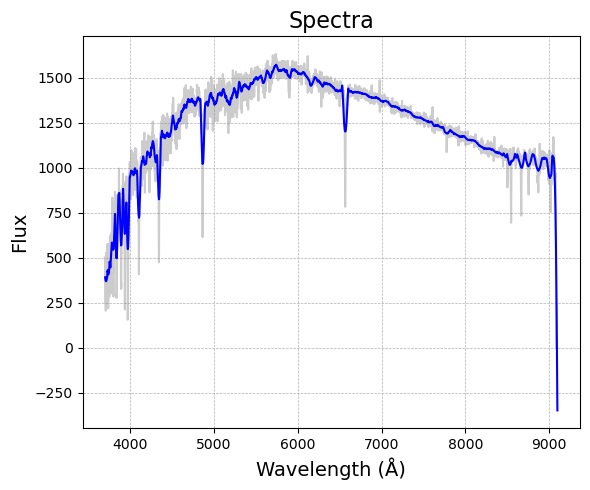

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
286098  74fe09f8-6c3f-5299-b50a-643233d57b55    120930   

                        asassn_name   other_names    raj2000   dej2000  \
286098  ASASSN-VJ074438.55+291223.5  NSVS 7293918  116.16064  29.20654   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
286098  2.457333e+06  8.788540e+17  J074438.59+291222.8     6058390.0   

                 edr3_source_id                galex_id         tic_id  
286098  EDR3 878853976389552896  GALEX J074438.6+291222  TIC 423085168   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
286098       0.37  0.088537            0.03       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
286098      12.21         12.13714           0.007848         12.264863   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot

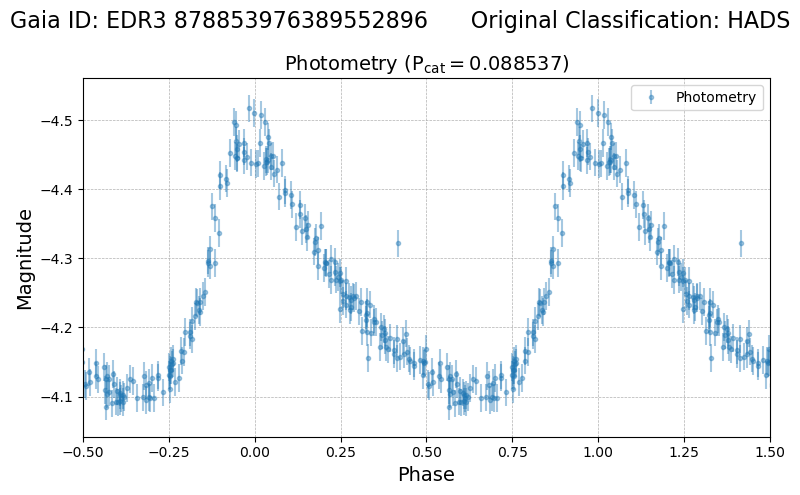

spec-56293-GAC118N28V1_sp14-019.fits.gz


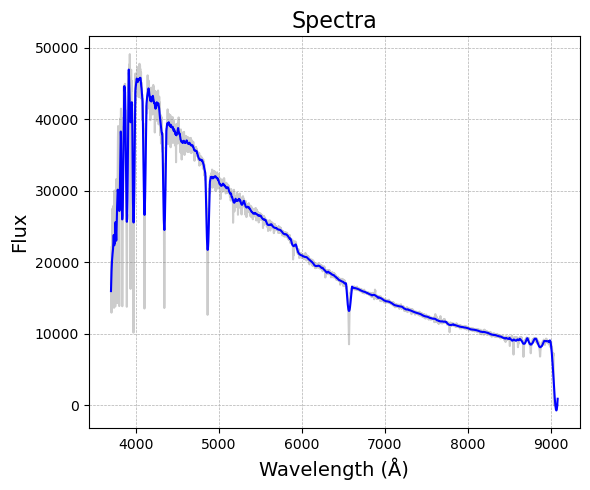

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
193878  de4b8369-6e8d-53f1-bbef-3c7932c7bcc5    128773   

                        asassn_name           other_names    raj2000  \
193878  ASASSN-VJ095237.20-232828.0  SSS_J095237.2-232827  148.15499   

         dej2000     epoch_hjd       gdr2_id           allwise_id  \
193878 -23.47444  2.458141e+06  5.660817e+18  J095237.23-232827.7   

        apass_dr9_id            edr3_source_id                galex_id  \
193878    45823526.0  EDR3 5660816618965671936  GALEX J095237.2-232827   

               tic_id  
193878  TIC 101316719   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
193878       0.24  0.090288            0.03       0.99 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
193878      12.08        12.021222           0.005447         12.182549   

        e_pho

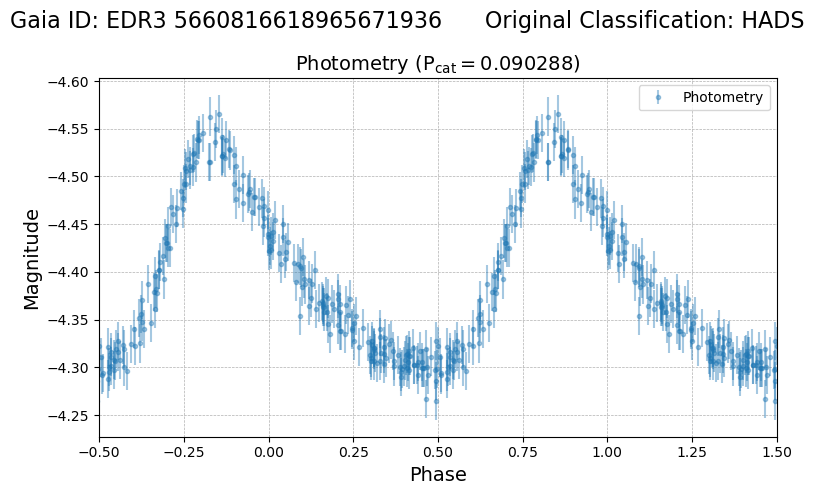

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
677730  9ce2be4b-9121-58f9-9e39-39135dfe34ab    560474   

                        asassn_name other_names    raj2000   dej2000  \
677730  ASASSN-VJ080321.63+550606.1         NaN  120.84048  55.10166   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
677730  2.457096e+06  1.032966e+18  J080321.64+550605.8     7120682.0   

                  edr3_source_id                galex_id        tic_id  
677730  EDR3 1032965546226754048  GALEX J080321.6+550606  TIC 80883924   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
677730       0.34  0.149181            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
677730      12.56        12.517943           0.006656         12.696591   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_

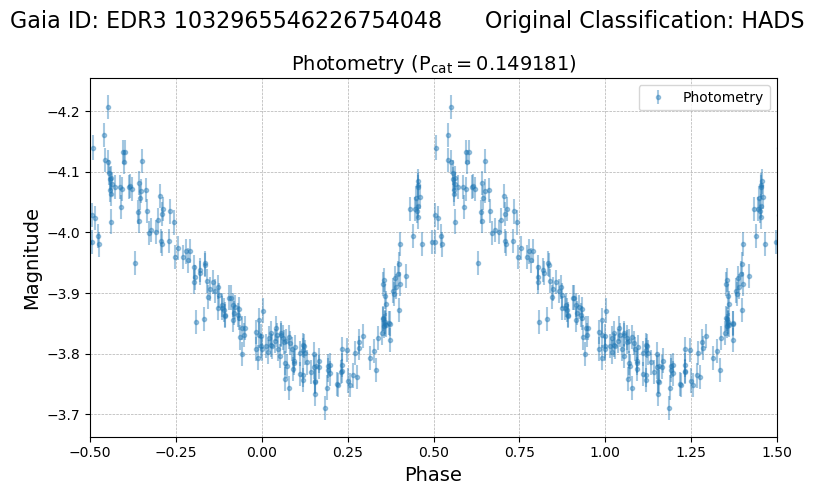

spec-56646-HD081012N554815V01_sp05-183.fits.gz


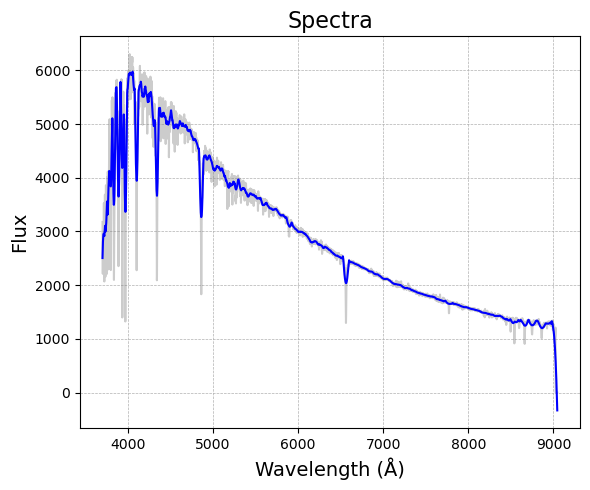

spec-56726-GAC117N54V1_sp13-219.fits.gz


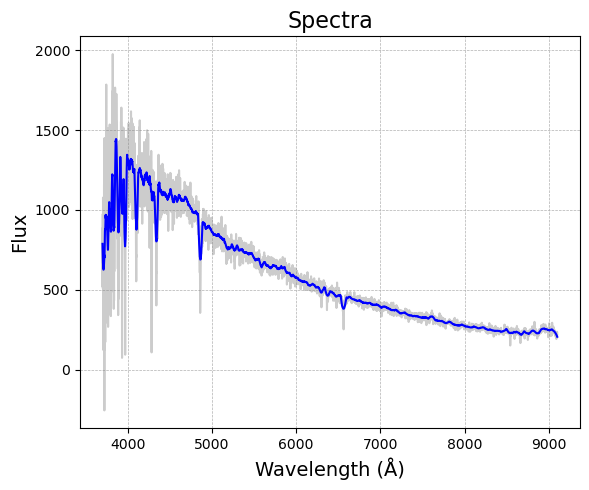

spec-57738-HD081012N554815V02_sp05-183.fits.gz


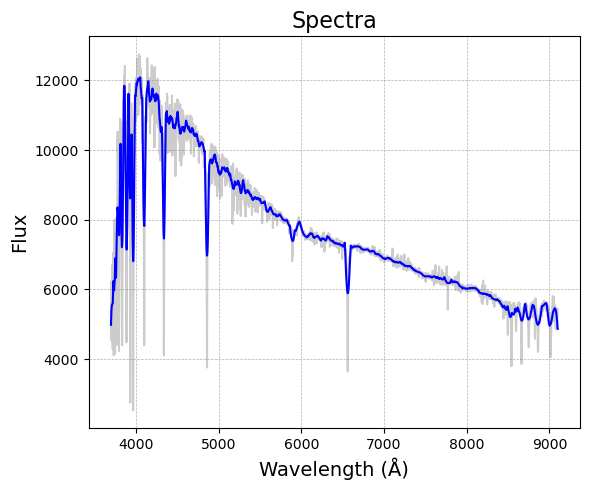

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
434331  e4e5e707-34d5-50eb-bfd9-276a376eb73a    419554   

                        asassn_name          other_names    raj2000   dej2000  \
434331  ASASSN-VJ120718.18-720322.6  ASAS J120718-7203.4  181.82574 -72.05629   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
434331  2.457761e+06  5.842681e+18  J120718.06-720322.8    48611135.0   

                  edr3_source_id galex_id         tic_id  
434331  EDR3 5842681271049006336      NaN  TIC 359208940   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
434331       0.27  0.177037            0.27       0.86 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
434331      11.15         10.95743           0.003977         11.268521   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

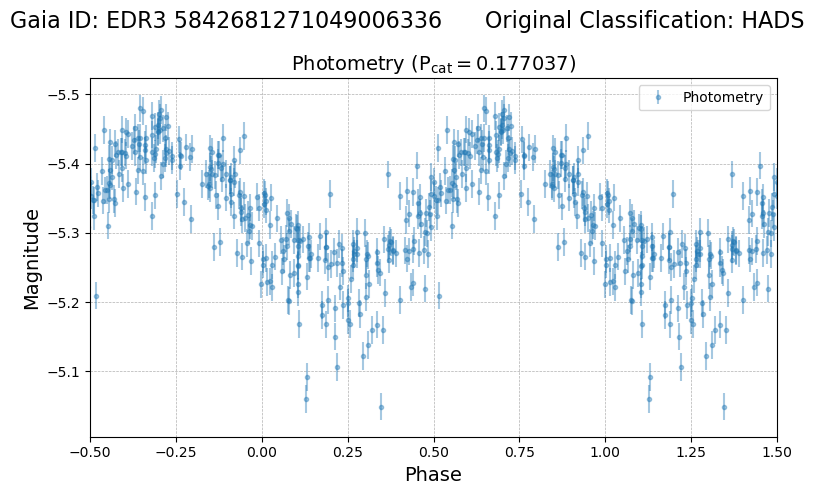

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
684791  5d0ac30e-ef38-547e-8bea-862db5f2f31d    192461   

                        asassn_name other_names  raj2000   dej2000  \
684791  ASASSN-VJ064400.96+224432.0   V0403 Gem  101.004  22.74223   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
684791  2.457845e+06  3.379476e+18  J064401.05+224431.7    24837102.0   

                  edr3_source_id galex_id         tic_id  
684791  EDR3 3379475710982501120      NaN  TIC 457035927   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude  period  lksl_statistic  rfr_score
684791       0.28  0.1177            0.46       0.78 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
684791      12.52        12.455837           0.005793         12.668525   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
684791        

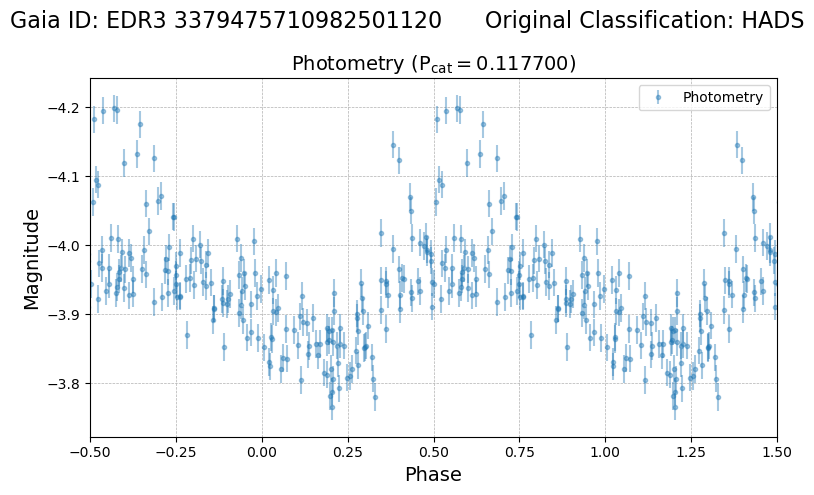

spec-57060-HD064747N214129V01_sp15-081.fits.gz


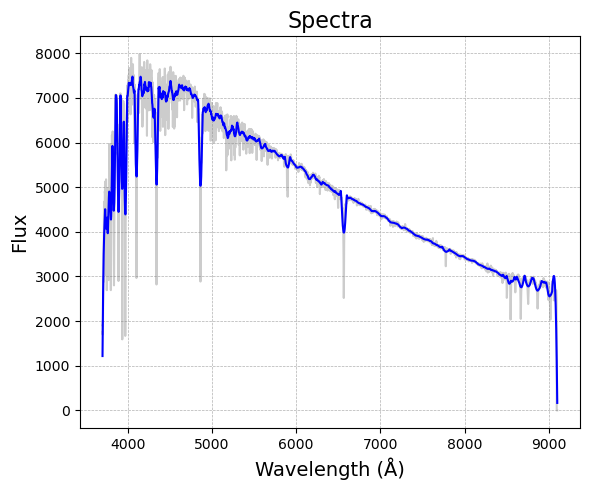

spec-57393-KP065159N233606V01_sp10-031.fits.gz


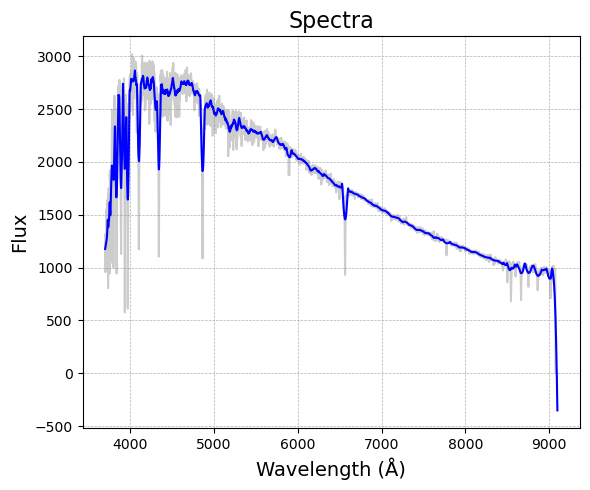

spec-57395-KP063752N233616V01_sp06-014.fits.gz


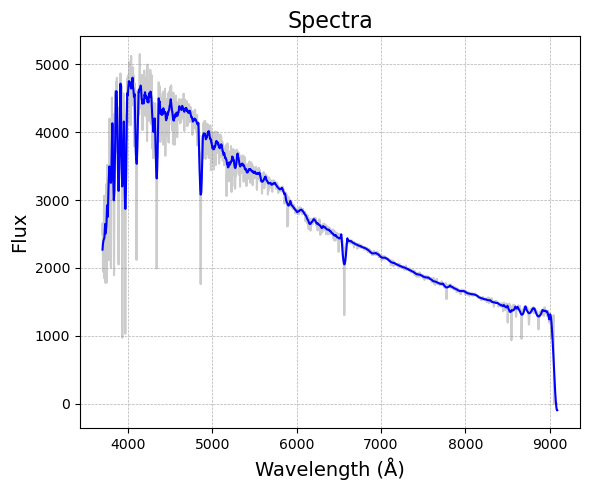

spec-58424-KII065159N233606V01_sp10-031.fits.gz


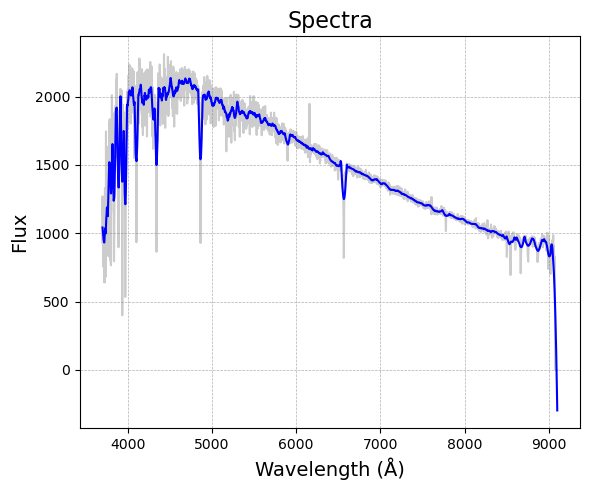

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
446725  cf5c361d-600f-54de-a528-8e60392e0eec  AP46963539   

                        asassn_name             other_names    raj2000  \
446725  ASASSN-VJ091023.07-083202.3  ATLASJ137.5962-08.5340  137.59614   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
446725 -8.53397  2.457040e+06  5.744098e+18  J091023.07-083202.2   

        apass_dr9_id            edr3_source_id galex_id        tic_id  
446725    46963539.0  EDR3 5744097993340592768      NaN  TIC 60588054   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
446725       0.29  0.103443            0.12       0.94 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
446725      12.67        12.572041           0.005063         12.748507   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean

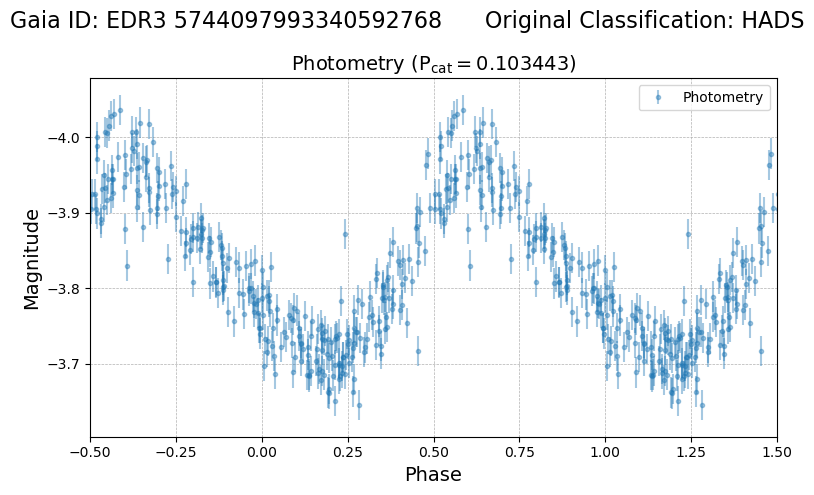

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
233822  1929210a-b36c-5b92-8ef8-6e8b14f01fc5    418898   

                        asassn_name          other_names    raj2000   dej2000  \
233822  ASASSN-VJ064634.98-145528.4  ASAS J064635-1455.5  101.64576 -14.92455   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
233822  2.457795e+06  2.947531e+18  J064635.06-145528.5    19073215.0   

                  edr3_source_id galex_id        tic_id  
233822  EDR3 2947530506428832768      NaN  TIC 35166984   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
233822       0.55  0.095373            0.03       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
233822      12.82        12.698756           0.009527         13.035436   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    

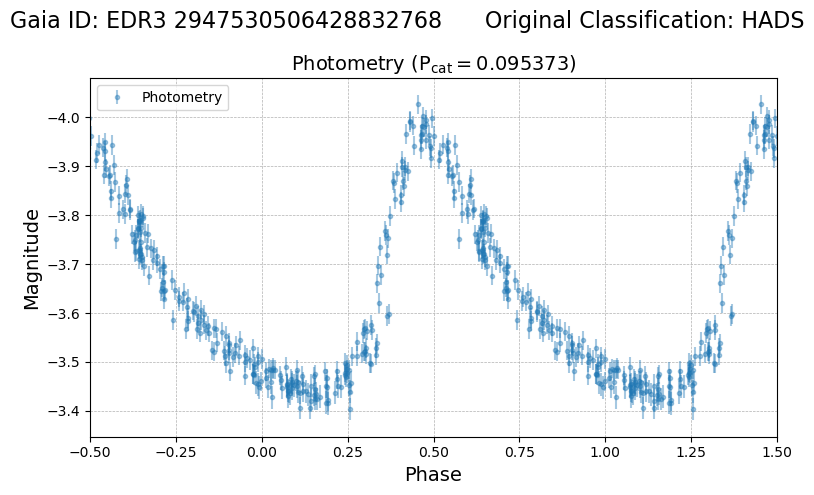

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
153816  ad50d829-b93d-53eb-bbe0-2361c9c9f34c     76278   

                        asassn_name   other_names    raj2000   dej2000  \
153816  ASASSN-VJ202109.55+620255.5  NSVS 3156852  305.28978  62.04876   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
153816  2.458371e+06  2.243125e+18  J202109.29+620255.9    15918380.0   

                  edr3_source_id galex_id         tic_id  
153816  EDR3 2243125461516358144      NaN  TIC 236980080   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
153816       0.41  0.092272            0.06       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
153816      12.31        12.255343           0.006377         12.464737   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
15

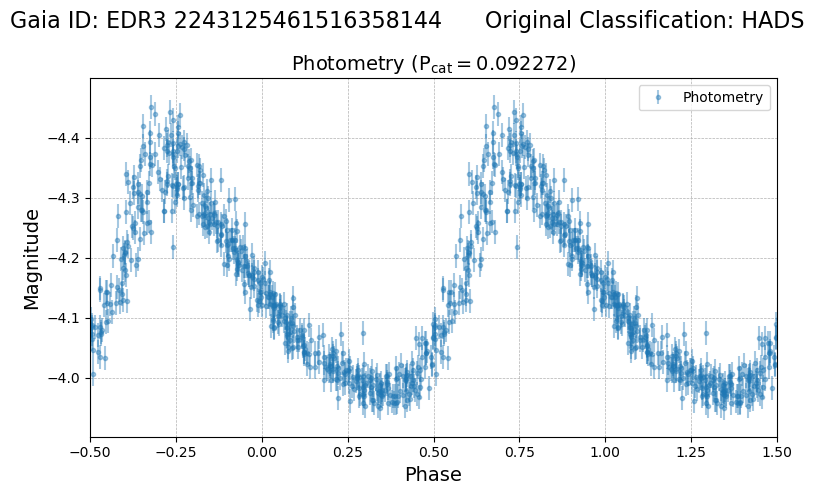

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
274845  b3496023-0ce9-5fc0-abf0-410801bb1d1d    419695   

                        asassn_name          other_names   raj2000   dej2000  \
274845  ASASSN-VJ070528.78-170516.9  ASAS J070529-1705.3  106.3699 -17.08803   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
274845  2.458191e+06  2.935415e+18  J070528.88-170516.8    18914947.0   

                  edr3_source_id galex_id         tic_id  
274845  EDR3 2935414712929612928      NaN  TIC 148357344   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
274845       0.54  0.090093            0.04       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
274845      12.46        12.284957           0.007593         12.493059   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    

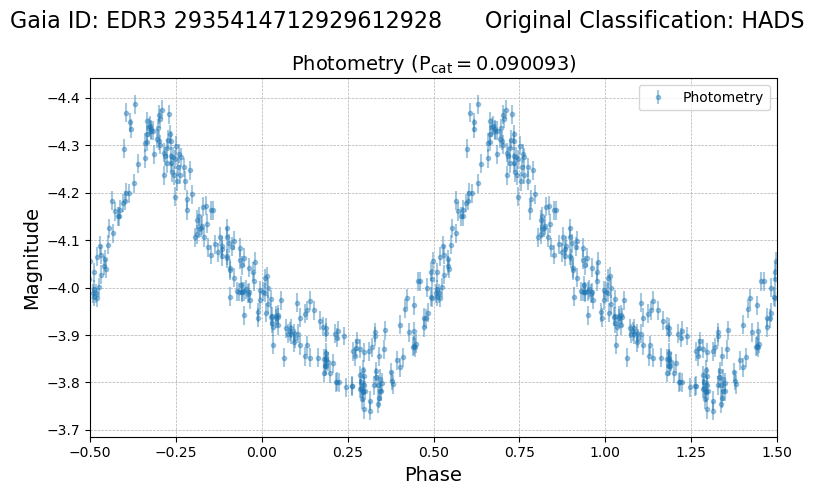

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id  source_id  \
521033  be72e5af-2a04-5a58-b01b-a7f454d6d428  AP4619608   

                        asassn_name           other_names   raj2000   dej2000  \
521033  ASASSN-VJ011237.75+701028.5  WISEJ011238.0+701027  18.15729  70.17457   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
521033  2.457317e+06  5.331959e+17  J011238.04+701027.9     4619608.0   

                 edr3_source_id galex_id         tic_id  
521033  EDR3 533195901765581824      NaN  TIC 369089161   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
521033       0.26  0.099755            0.17       0.91 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
521033      12.13        12.202483            0.00558          12.71175   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

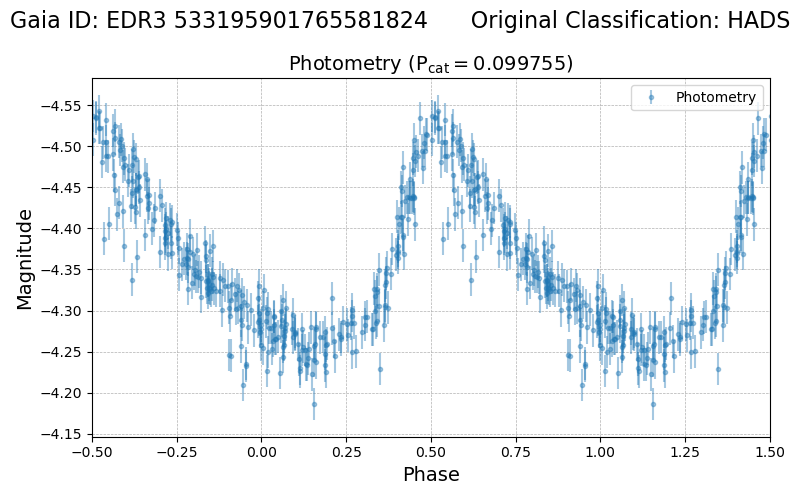

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
65289  0253ce1e-8291-50f4-8b24-8069ad63eb4b    104568   

                       asassn_name          other_names    raj2000  dej2000  \
65289  ASASSN-VJ141311.14+095819.8  ASAS J141311+0958.3  213.29641  9.97216   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
65289  2.457513e+06  3.723050e+18  J141311.20+095819.6    26930414.0   

                 edr3_source_id                galex_id         tic_id  
65289  EDR3 3723050447297253376  GALEX J141311.2+095819  TIC 449148291   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
65289       0.21  0.112469            0.19        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
65289      12.62        12.543022           0.005055         12.719749   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_pho

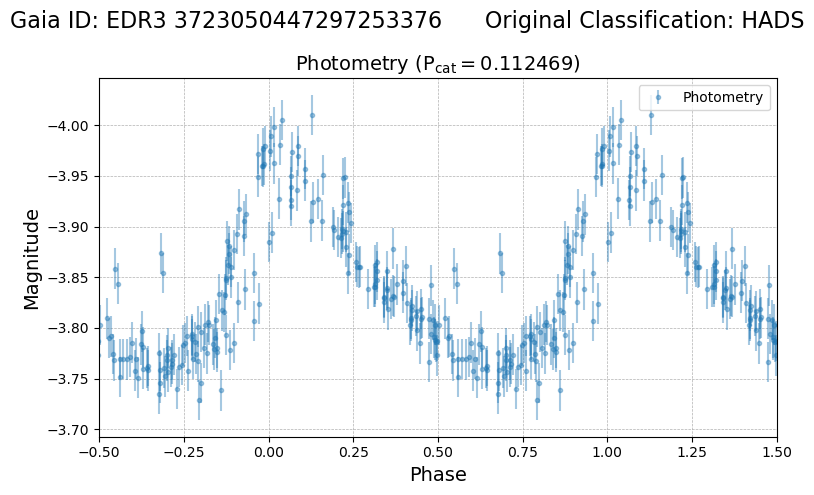

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
233442  ee42b1d2-c2b6-5a23-8078-18cab9423d37    287164   

                        asassn_name      other_names   raj2000   dej2000  \
233442  ASASSN-VJ031602.73+432034.5  GSC 02860-01552  49.01136  43.34293   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
233442  2.457414e+06  2.405639e+17  J031602.70+432034.4     1514955.0   

                 edr3_source_id galex_id         tic_id  
233442  EDR3 240563940045527936      NaN  TIC 416048127   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
233442       0.34  0.106749            0.36       0.83 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
233442      12.75        12.657792           0.007853         12.903636   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \


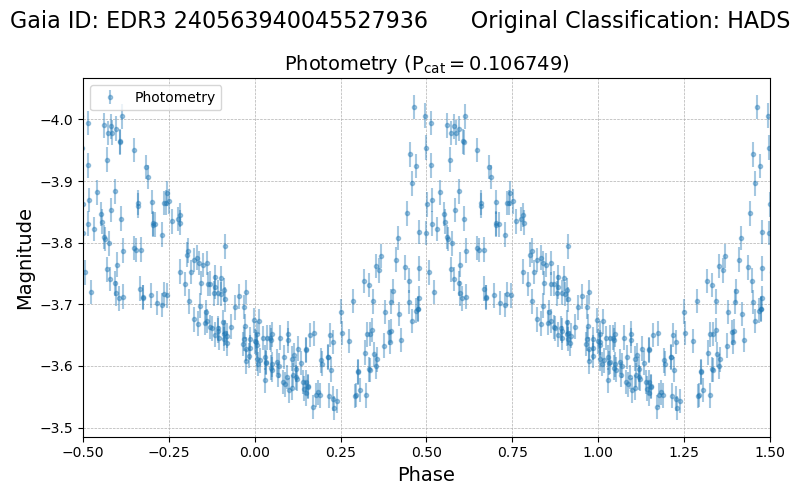

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
535852  40e8485d-8cd4-5e8f-9a62-5f2e9bafac62  AP11318451   

                        asassn_name other_names    raj2000   dej2000  \
535852  ASASSN-VJ215513.65+294320.8         NaN  328.80686  29.72245   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
535852  2.456784e+06  1.896567e+18  J215513.57+294321.4    11318451.0   

                  edr3_source_id galex_id        tic_id  
535852  EDR3 1896567294880912384      NaN  TIC 17864370   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
535852       0.19  0.14775            0.07       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
535852       12.7        13.931776           0.002762         14.512135   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
535852

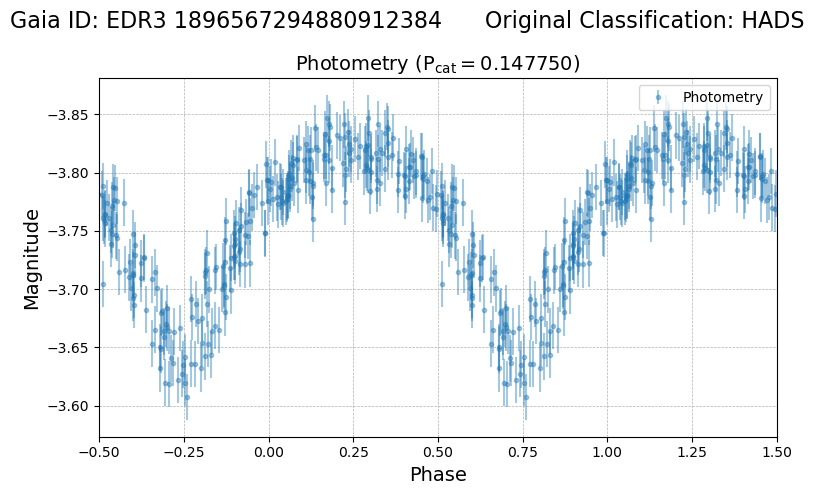

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
287015  9e91a82f-9aba-5c75-9fb1-3f7996d0ef05    149185   

                        asassn_name          other_names   raj2000   dej2000  \
287015  ASASSN-VJ021312.71-405450.2  ASAS J021313-4054.8  33.30295 -40.91395   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
287015  2.457709e+06  4.963062e+18  J021312.71-405450.2    37382082.0   

                  edr3_source_id                galex_id         tic_id  
287015  EDR3 4963062068916781568  GALEX J021312.7-405450  TIC 138735041   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
287015       0.35  0.115507            0.03       0.98 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
287015      12.34        12.297483           0.005289         12.470429   

        e_phot_bp_mean_mag  phot_rp_me

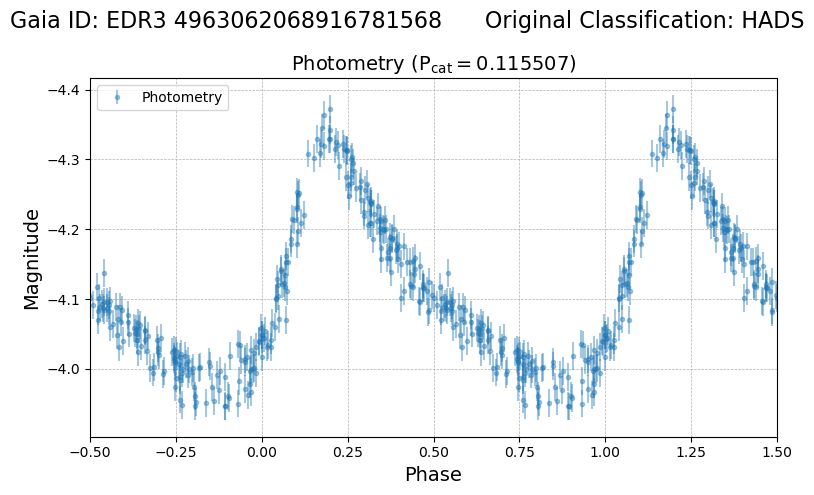

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
285474  e689a705-8d7d-5436-a8e6-58bc9fca2762    169975   

                        asassn_name          other_names   raj2000   dej2000  \
285474  ASASSN-VJ032245.75-723746.3  ASAS J032246-7237.8  50.69063 -72.62953   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
285474  2.457269e+06  4.642254e+18  J032245.88-723745.9    36171303.0   

                  edr3_source_id                galex_id         tic_id  
285474  EDR3 4642254198322342656  GALEX J032245.6-723745  TIC 431589510   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
285474        0.3  0.129424            0.05       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
285474      12.14        12.155584           0.005764         12.316412   

        e_phot_bp_mean_mag  phot_rp_me

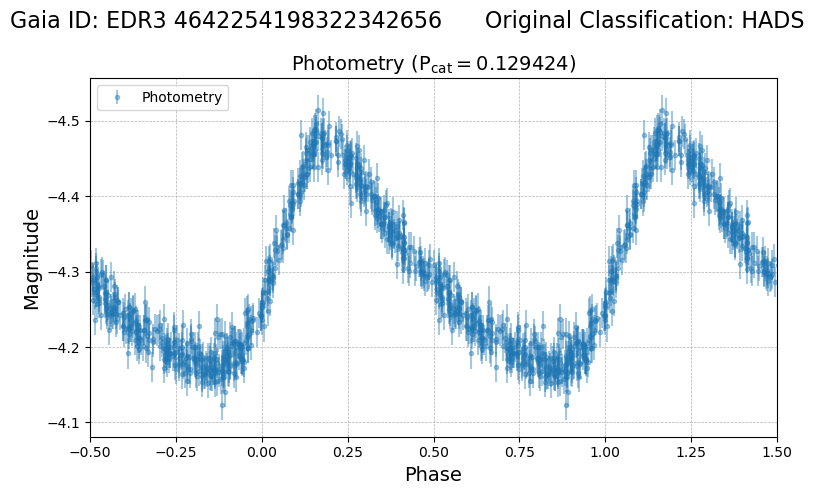

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
43576  633742fc-47c2-54c9-8eb2-821cdf3d0437    430528   

                       asassn_name          other_names   raj2000  dej2000  \
43576  ASASSN-VJ060757.04-020744.6  ASAS J060757-0207.7  91.98765 -2.12905   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
43576  2.458199e+06  3.024997e+18  J060757.00-020743.7    19711813.0   

                 edr3_source_id galex_id        tic_id  
43576  EDR3 3024996525146020864      NaN  TIC 12307032   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
43576       0.23  0.161646            0.19        0.9 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
43576      11.89        11.788132            0.00444          12.12506   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag     bp_rp  \
43576  

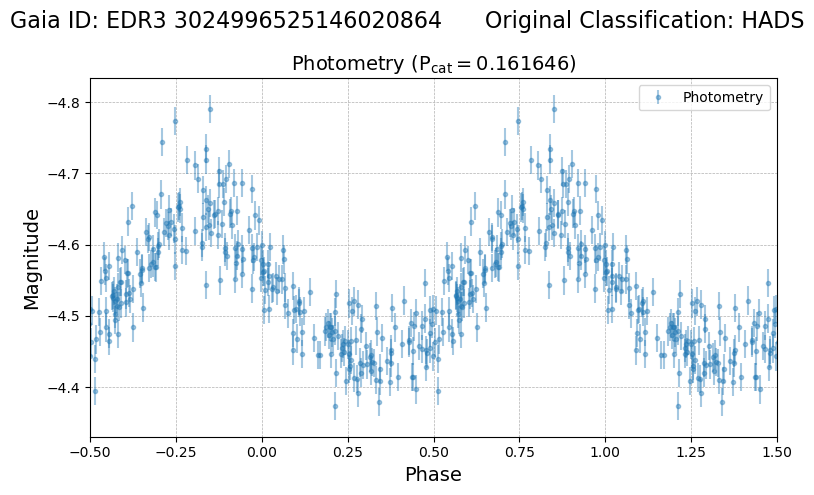

spec-56346-VB091S03V1_sp15-142.fits.gz


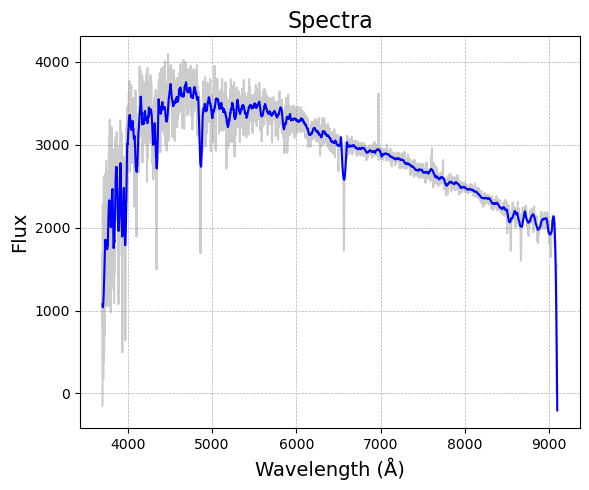

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id   source_id  \
477698  fcd95983-5c92-5580-af82-b7d918bb70f0  AP22256894   

                        asassn_name             other_names    raj2000  \
477698  ASASSN-VJ065408.36+063259.4  ATLASJ103.5348+06.5497  103.53485   

        dej2000     epoch_hjd       gdr2_id           allwise_id  \
477698  6.54983  2.457704e+06  3.129951e+18  J065408.36+063259.2   

        apass_dr9_id            edr3_source_id galex_id         tic_id  
477698    22256894.0  EDR3 3129951030348412672      NaN  TIC 235377155   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
477698        0.2  0.092848            0.11       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
477698      12.64        12.532211           0.005223         12.755363   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_me

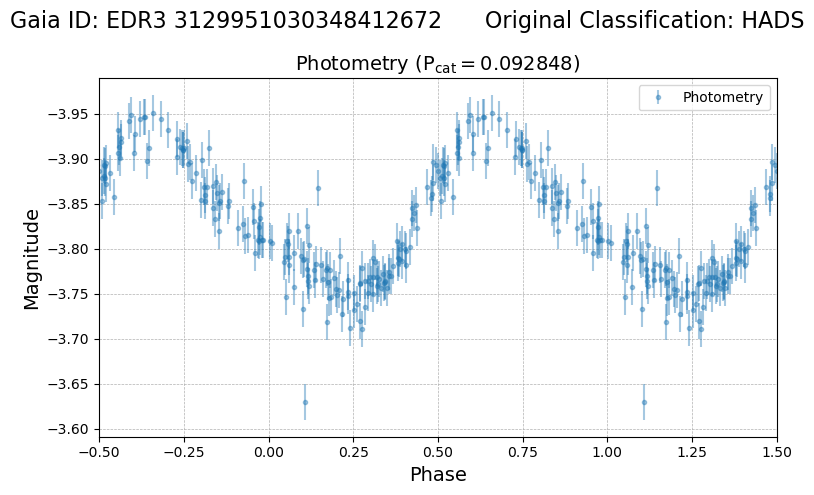

spec-55955-GAC_103N06_V4_sp04-197.fits.gz


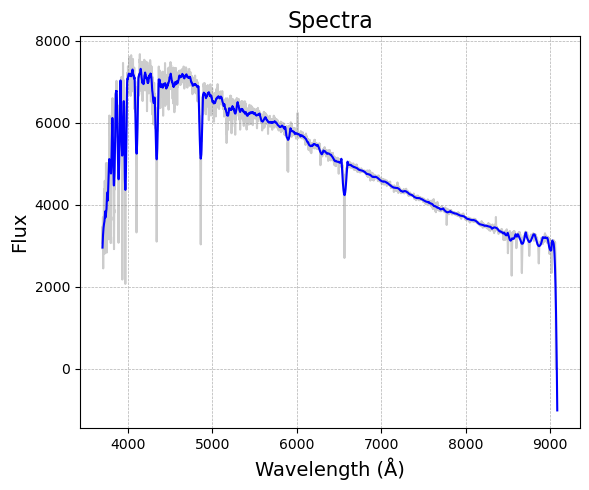

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                          id source_id  \
58299  d72ecfdd-6a13-5b79-a387-003a6579e70a     57699   

                       asassn_name          other_names   raj2000   dej2000  \
58299  ASASSN-VJ061128.22-472249.7  ASAS J061128-4722.8  92.86758 -47.38048   

          epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
58299  2.457607e+06  5.554535e+18  J061128.20-472249.3    43889224.0   

                 edr3_source_id                galex_id         tic_id  
58299  EDR3 5554535449907562496  GALEX J061128.2-472249  TIC 231921127   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
        amplitude    period  lksl_statistic  rfr_score
58299       0.26  0.097328            0.36       0.83 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
       mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
58299      11.89        11.867456           0.004924         12.025227   

       e_phot_bp_mean_mag  phot_rp_mean_mag  e_pho

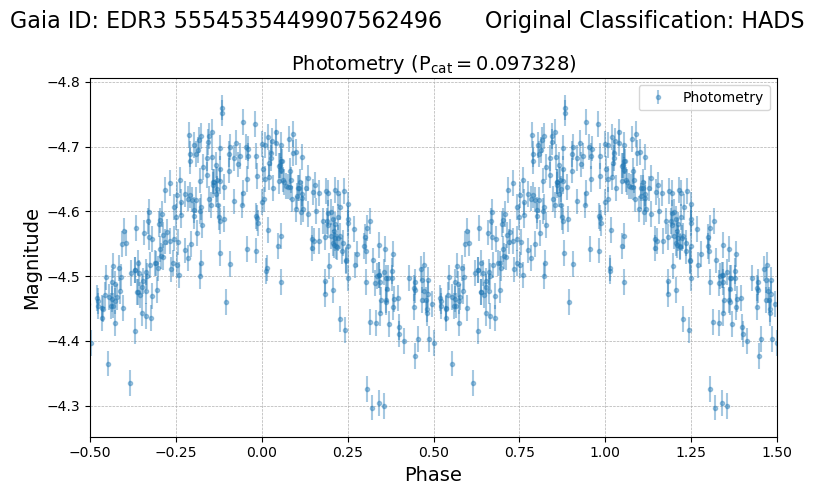

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
192103  6370870c-7e7b-5dfc-ab49-b589c5f77b98    349889   

                        asassn_name          other_names    raj2000   dej2000  \
192103  ASASSN-VJ102808.51-535836.2  ASAS J102808-5358.6  157.03546 -53.97671   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
192103  2.457434e+06  5.357051e+18  J102808.47-535836.2    41209823.0   

                  edr3_source_id galex_id         tic_id  
192103  EDR3 5357051483569263872      NaN  TIC 447363101   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
192103       0.18  0.191438            0.09       0.95 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
192103       11.2        11.150142           0.003642         11.445594   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

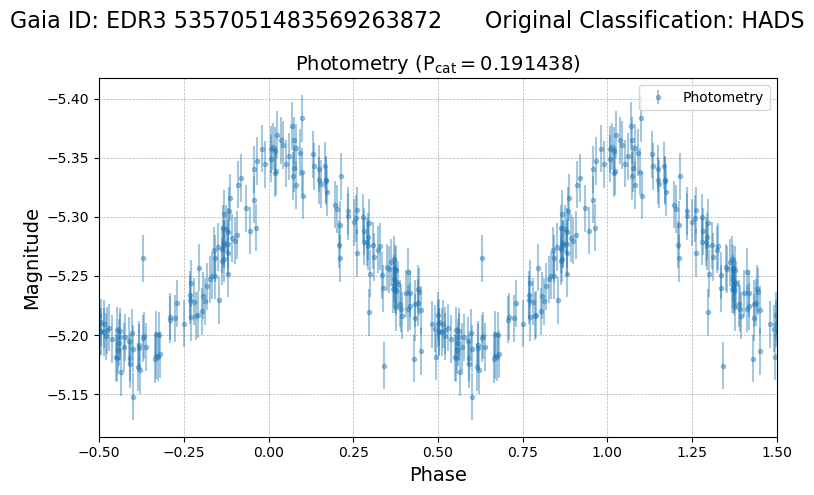

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
195322  f4ab472c-9243-50f6-9922-509d606ae700    378679   

                        asassn_name          other_names    raj2000   dej2000  \
195322  ASASSN-VJ102422.61-584201.2  ASAS J102422-5842.0  156.09419 -58.70034   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
195322  2.458122e+06  5.255566e+18  J102422.63-584201.4    39136410.0   

                  edr3_source_id galex_id         tic_id  
195322  EDR3 5255565971891920128      NaN  TIC 464401254   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude   period  lksl_statistic  rfr_score
195322       0.29  0.11994            0.05       0.97 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
195322      12.21        12.230226           0.005878         12.437704   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag    

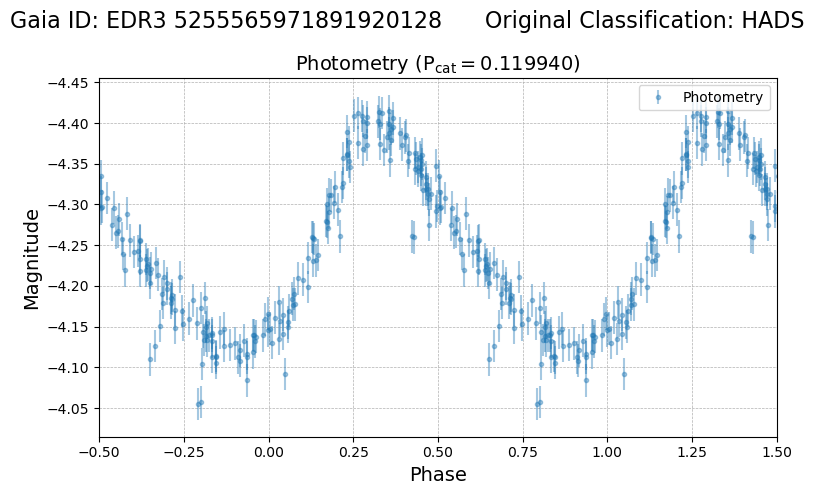

⬇️⬇️⬇️ BOOKEEPING COLUMNS ⬇️⬇️⬇️
                                           id source_id  \
247028  7424e457-3749-51bd-b5ac-4c88ea996a7b    210672   

                        asassn_name           other_names   raj2000   dej2000  \
247028  ASASSN-VJ054219.25+345220.0  VSX J054219.2+345219  85.58021  34.87222   

           epoch_hjd       gdr2_id           allwise_id  apass_dr9_id  \
247028  2.457364e+06  3.455467e+18  J054219.20+345219.7    25855351.0   

                  edr3_source_id galex_id         tic_id  
247028  EDR3 3455467318967030144      NaN  TIC 116605263   
_________________

⬇️⬇️⬇️ PHOTO_COLS ⬇️⬇️⬇️
         amplitude    period  lksl_statistic  rfr_score
247028       0.34  0.160683            0.27       0.87 
_________________

⬇️⬇️⬇️ METADATA_COLS ⬇️⬇️⬇️
        mean_vmag  phot_g_mean_mag  e_phot_g_mean_mag  phot_bp_mean_mag  \
247028      12.14        12.035625           0.005576         12.347147   

        e_phot_bp_mean_mag  phot_rp_mean_mag  e_phot_rp_mean_mag  

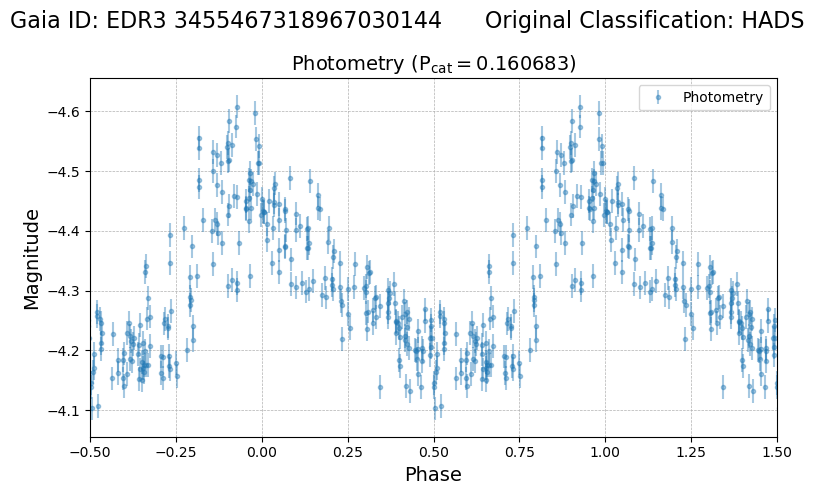

In [95]:
for name in eb_meta_out_names:
    if name not in eb_out_names:
        plot_photometry_flux(name, meta_warning=False)